# 🔊 Audio Anomaly Detection - Projet DCASE 2024 Task 2

### 📌 Analyse Exploratoire des Données (EDA) : Détection Anormale de Sons (ASD)

Ce notebook réalise une **Analyse Exploratoire de Données (EDA)** approfondie sur des sons normaux et anormaux, issus du projet DCASE 2024 Task 2. L'objectif est d'identifier les caractéristiques les plus pertinentes pour préparer efficacement l'entraînement des modèles de détection d'anomalies.

---

🎯 **Objectifs principaux :**

- Explorer et visualiser les différences fondamentales entre les sons normaux et anormaux.
- Identifier les caractéristiques audio discriminantes pour la détection d'anomalies.
- Préparer et structurer les données en vue de l'entraînement de modèles prédictifs robustes.

---

📊 **Analyses effectuées :**

- ✅ Analyse initiale des données audio brutes (durée, répartition des fichiers, signaux audio).
- ✅ Extraction et visualisation de features audio clés (MFCC, Mel-Spectrogram, RMS, ZCR, etc.).
- ✅ Analyse statistique descriptive (moyenne, écart-type, distributions).
- ✅ Détection et traitement des valeurs aberrantes (outliers).
- ✅ Analyse des corrélations entre les différentes features extraites.
- ✅ Réduction de dimensionnalité (PCA, t-SNE) et visualisations avancées.

---

📂 **Configuration utilisée :**

- 🔹 Données audio prétraitées stockées dans : `DCASE_DATASET/numpy_data`.
- 🔹 Features audio extraites : MFCC, Mel-Spectrogram, RMS, Zero Crossing Rate, Spectral Contrast, etc.
- 🔹 Gestion du projet via des scripts modulaires :
  - `config.py` : Paramètres centralisés et gestion des chemins du projet.
  - `processing.py` : Fonctions utilitaires pour le traitement audio.
  - `visualization.py` : Outils de visualisation des données audio.
  - `logger_utils.py` : Gestion centralisée du logging et des erreurs.

---

🔧 **Bibliothèques utilisées :**

| Catégorie           | Librairies                                            |
|---------------------|-------------------------------------------------------|
| Traitement des données | `numpy`, `pandas`                                     |
| Traitement audio    | `librosa`                                             |
| Visualisation       | `matplotlib`, `seaborn`                               |
| Machine Learning    | `scikit-learn`, `scipy`                               |
| Logging & Utils     | `logging`, gestion centralisée via scripts dédiés     |

---

🚀 **Démarrage de l'analyse exploratoire :**


1. 📦 Introduction (Initialisation et Configuration du Projet)
2. 📂 Chargement et Inspection Initiale des Données
3. 🔊 Analyse Exploratoire des Audios Bruts
   - Formes d’onde
   - Spectrogrammes
4. 📈 Extraction et Exploration des Features Audio
5. 📊 Analyse Comparative des Distributions de Features
   - Histogrammes & Radar charts
   - Heatmap de corrélation
6. 🚩 Détection et traitement des outliers
7. 🌌 Réduction de Dimensionnalité (PCA, t-SNE)
   - PCA
   - UMAP / t-SNE
8. 🕒 Analyse Temporelle et Visualisation Avancée (MFCC en 3D)
9. 📐 Tests Statistiques
10. 🎯 Synthèse et recommandations


In [1]:
# 📌 Importation des bibliothèques essentielles
import sys
from pathlib import Path
import numpy as np
import pandas as pd
import librosa
import librosa.display
import matplotlib.pyplot as plt
import seaborn as sns
import scipy.stats as stats

from collections import Counter
from tqdm import tqdm

# 📌 Configuration globale
import warnings
warnings.filterwarnings('ignore')

# 📂 Ajout dynamique du répertoire principal au PYTHONPATH
project_root = Path.cwd().parent  # DCASE2024_ASD_Project/
sys.path.append(str(project_root))

# 📂 Importation des modules du projet
from src import config, processing, visualization
from src.utils.logger_utils import configure_logger

# 🔧 Configuration du logger
logger = configure_logger()
logger.info("📌 Notebook EDA - Démarrage de l'analyse exploratoire des sons normaux et anormaux")

# 🎛️ Échantillonnage standard (à adapter selon ton cas)
sample_rate = config.SR  # Remplace par ta fréquence réelle utilisée si différente

2025-03-24 14:03:40 - INFO - 📌 Notebook EDA - Démarrage de l'analyse exploratoire des sons normaux et anormaux


## 📂 2. Chargement et Inspection Initiale des Données

Cette étape consiste à charger les données audio normalisées stockées sous forme de fichiers `.wav` et à effectuer une première inspection des données afin de mieux comprendre leur structure et leur répartition.

**Objectifs :**
- Charger les données audio prétraitées.
- Inspecter la répartition entre les classes (normaux vs anomalies).
- Afficher un résumé descriptif initial (nombre de fichiers, dimensions des données, etc.).


2025-03-24 14:03:51 - INFO - Répertoire trouvé : C:\Users\guidy\Documents\Datascience\Data\sound_datasets\DCASE_DATASET\dev_data
Inspection des types de machines: 100%|██████████████████████████████████████████████████| 6/6 [00:53<00:00,  8.84s/it]
2025-03-24 14:04:44 - INFO - Affichage des premières lignes du DataFrame récapitulatif des données :


Counter({'ToyConveyor': 6509, 'ToyCar': 6459, 'fan': 5550, 'pump': 4205, 'valve': 4170, 'slider': 4094})
Counter({10.0: 24528, 11.0: 6459})


,file_path,machine_type,machine_id,data_split,condition,duration,sampling_rate
0,C:\Users\guidy\Documents\Datascience\Data\soun...,fan,id_00,test,anomaly,10.0,16000
1,C:\Users\guidy\Documents\Datascience\Data\soun...,fan,id_00,test,anomaly,10.0,16000
2,C:\Users\guidy\Documents\Datascience\Data\soun...,fan,id_00,test,anomaly,10.0,16000
3,C:\Users\guidy\Documents\Datascience\Data\soun...,fan,id_00,test,anomaly,10.0,16000
4,C:\Users\guidy\Documents\Datascience\Data\soun...,fan,id_00,test,anomaly,10.0,16000


2025-03-24 14:04:44 - INFO - Affichage de la répartition des données audio (normales vs anomalies) :


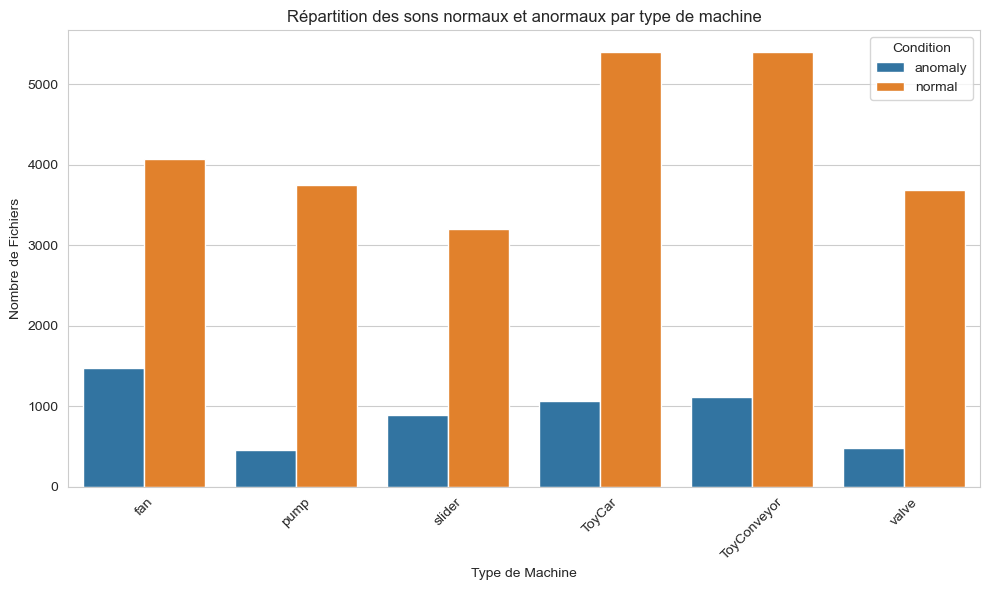

,Duration,%
0,10.0s,79.2%
1,11.0s,20.8%


In [2]:
# 🔧 Chargement des bibliothèques complémentaires
# 📂 Chargement des chemins depuis la configuration
wav_audio_path = config.DEV_AUDIO_DIR
# 🔍 Vérification de l'existence du répertoire
if not wav_audio_path.exists():
    logger.error(f"Le répertoire {wav_audio_path} n'existe pas.")
else:
    logger.info(f"Répertoire trouvé : {wav_audio_path}")

# 🔄 Fonction pour inspecter la structure des données
def inspect_wav_data(directory):
    data_summary = []
    
    for machine_type in tqdm(sorted(directory.glob("*")), desc="Inspection des types de machines"):
        if machine_type.is_dir():
            for data_split in sorted(machine_type.glob("*")):
                if data_split.is_dir():
                    for machine_id in sorted(data_split.glob("*")):
                        wav_files = list(machine_id.glob("*.wav"))
                        for wav_file in wav_files:
                            condition = 'anomaly' if 'anomaly' in wav_file.stem else 'normal'
                            y, _ = librosa.load(wav_file, sr=sample_rate)                    
                            data_summary.append({
                                'file_path': wav_file,
                                'machine_type': machine_type.name,
                                'machine_id': machine_id.name,
                                'data_split': data_split.name,
                                'condition': condition,
                                'duration': float(len(y)/sample_rate),
                                'sampling_rate':sample_rate
                            })
    return pd.DataFrame(data_summary)

# 📊 Création d'un DataFrame récapitulatif
wav_df = inspect_wav_data(wav_audio_path)
# Utilisation de Counter pour compter les occurrences
counts_machinetype = Counter(wav_df.machine_type)
print(counts_machinetype)

counts_duration = Counter(wav_df.duration)
print(counts_duration)

# 🔍 Affichage des premières lignes
logger.info("Affichage des premières lignes du DataFrame récapitulatif des données :")
display(wav_df.head())

# 📈 Affichage de la répartition des données par type et condition
logger.info("Affichage de la répartition des données audio (normales vs anomalies) :")
plt.figure(figsize=(10, 6))
sns.countplot(data=wav_df, x='machine_type', hue='condition')
plt.title("Répartition des sons normaux et anormaux par type de machine")
plt.xlabel("Type de Machine")
plt.ylabel("Nombre de Fichiers")
plt.legend(title="Condition")
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

serie = wav_df['duration'].value_counts()
df_serie = pd.DataFrame(serie)
df_serie.reset_index(inplace=True)
df_serie = df_serie.rename(columns={'duration': 'Duration'})
tot = df_serie['count'].sum()
df_serie['%'] = df_serie['count'].apply(lambda x: 100 * (x / tot)).map('{:,.1f}%'.format)
df_serie['Duration'] = df_serie['Duration'].map('{:,.1f}s'.format)

display(df_serie[['Duration', '%']])

# 🔍 Vérification rapide des dimensions d'un fichier exemple
#exemple_path = wav_df.iloc[0]['file_path']
#exemple_data = np.load(exemple_path)
#logger.info(f"Dimensions d'un fichier exemple ({exemple_path.name}): {exemple_data.shape}")


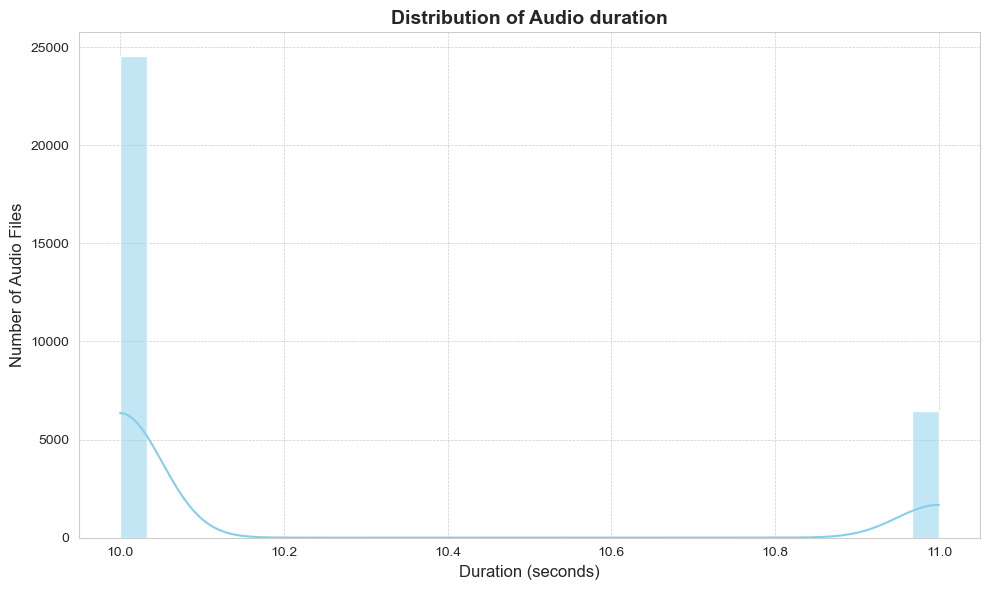

,Statistic,Duration (s)
0,count,30987.00
1,mean,10.21
2,std,0.41
3,min,10.00
4,25%,10.00
5,50%,10.00
6,75%,10.00
7,max,11.00


In [3]:
visualization.plot_audio_duration_distribution(wav_df)

In [4]:
# 📂 Chargement des chemins depuis la configuration
npy_audio_path = config.NUMPY_AUDIO_DIR

# 🔍 Vérification de l'existence du répertoire
if not npy_audio_path.exists():
    logger.error(f"Le répertoire {npy_audio_path} n'existe pas.")
else:
    logger.info(f"Répertoire trouvé : {npy_audio_path}")
    
# 📊 Création d'un DataFrame récapitulatif
#data_df = visualization.inspect_npy_data(npy_audio_path, sample_rate=sample_rate)
data_df = processing.load_metadata(
    data_path=config.DEV_AUDIO_DIR,
    output_path=config.NUMPY_AUDIO_DIR,
    output_file=config.METADATA_FILE,
    target_duration=10,
    segment_duration=5
)

# 🔍 Affichage des premières lignes
logger.info("Affichage des premières lignes du DataFrame récapitulatif des données :")
print(data_df.shape)
display(data_df.sample(5))


2025-03-24 14:04:45 - INFO - Répertoire trouvé : C:\Users\guidy\Documents\Datascience\Data\sound_datasets\DCASE_DATASET\numpy_data
2025-03-24 14:04:45 - INFO - Creating metadata file: 'C:\Users\guidy\Documents\Datascience\Data\sound_datasets\DCASE_DATASET\dev_data.csv'
Processing audio files: 100%|█████████████████████████████████████████████████| 30987/30987 [02:39<00:00, 193.72file/s]
2025-03-24 14:07:26 - INFO - Metadata saved successfully to 'C:\Users\guidy\Documents\Datascience\Data\sound_datasets\DCASE_DATASET\dev_data.csv'. Processing time: 0:02:40.702744
2025-03-24 14:07:26 - INFO - Affichage des premières lignes du DataFrame récapitulatif des données :


(61974, 9)


,file_path,filename,machine_type,machine_id,sample_id,data_split,condition,duration,sampling_rate
55864,C:\Users\guidy\Documents\Datascience\Data\soun...,normal_id_00_00000053.wav,valve,id_00,00000053,test,normal,5.0,16000
2332,C:\Users\guidy\Documents\Datascience\Data\soun...,normal_id_00_00000891.wav,pump,id_00,00000891,train,normal,5.0,16000
49921,C:\Users\guidy\Documents\Datascience\Data\soun...,normal_id_02_00000169.wav,ToyCar,id_02,00000169,test,normal,5.0,16000
33128,C:\Users\guidy\Documents\Datascience\Data\soun...,anomaly_id_03_00000214.wav,ToyCar,id_03,00000214,test,anomaly,5.0,16000
59557,C:\Users\guidy\Documents\Datascience\Data\soun...,normal_id_04_00000209.wav,ToyCar,id_04,00000209,test,normal,5.0,16000


2025-03-24 14:07:26 - INFO - Affichage de la répartition des données audio (normales vs anomalies) :


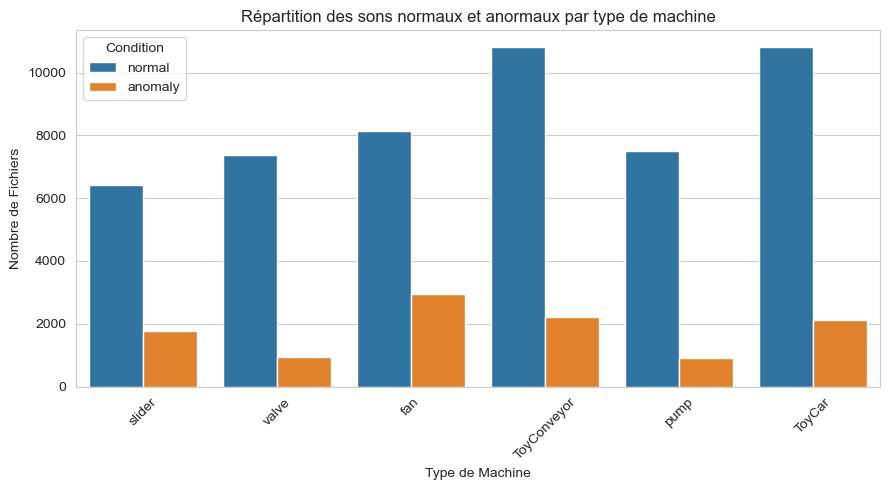

In [5]:
# 📈 Affichage de la répartition des données par type et condition
logger.info("Affichage de la répartition des données audio (normales vs anomalies) :")
plt.figure(figsize=(9, 5))
sns.countplot(data=data_df, x='machine_type', hue='condition')
plt.title("Répartition des sons normaux et anormaux par type de machine")
plt.xlabel("Type de Machine")
plt.ylabel("Nombre de Fichiers")
plt.legend(title="Condition")
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()



In [6]:
# 🔍 Vérification rapide des dimensions d'un fichier exemple
exemple_path = data_df.iloc[0]['file_path']
exemple_data = np.load(exemple_path)
logger.info(f"Dimensions d'un fichier exemple ({Path(exemple_path).name}): {exemple_data.shape}")


2025-03-24 14:07:26 - INFO - Dimensions d'un fichier exemple (normal_id_00_00000657_seg1.npy): (80000,)


### 📈 Visualisation complémentaire : Répartition des fichiers par type de machine et ensemble de données

Pour mieux comprendre comment les données sont réparties selon les différents types de machines et les ensembles (train, test, etc.), analysons cette répartition en détail à l'aide d'une visualisation claire et lisible.


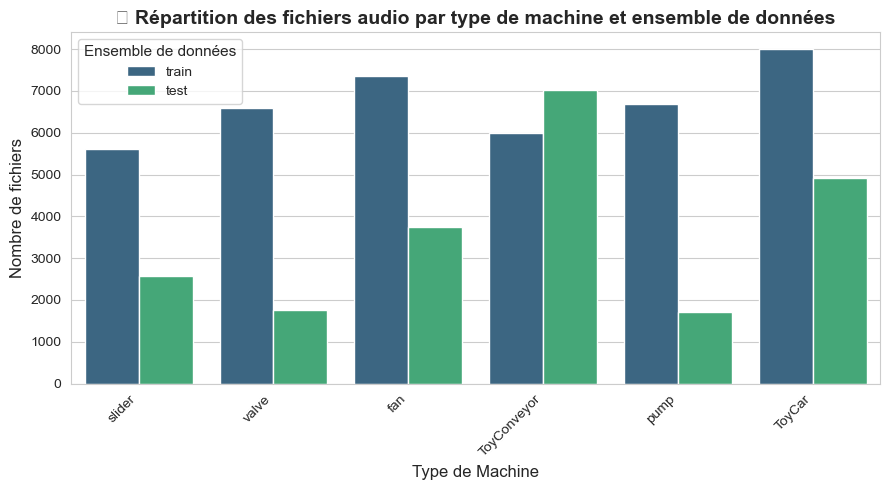

In [7]:
# 📊 Répartition des fichiers par type de machine et par ensemble de données
plt.figure(figsize=(9, 5))
sns.countplot(data=data_df, x="machine_type", hue="data_split", palette="viridis")

# 🎨 Personnalisation du graphique
plt.title("📈 Répartition des fichiers audio par type de machine et ensemble de données", fontsize=14, fontweight='bold')
plt.xlabel("Type de Machine", fontsize=12)
plt.ylabel("Nombre de fichiers", fontsize=12)
plt.xticks(rotation=45, ha="right", fontsize=10)
plt.yticks(fontsize=10)
plt.legend(title="Ensemble de données", title_fontsize="11", fontsize="10", loc="best")

plt.tight_layout()
plt.show()


### 📊 Visualisations détaillées des répartitions (optionnel mais recommandé)

Pour aller plus loin dans l'inspection initiale des données, nous utilisons une fonction personnalisée permettant de visualiser clairement :

- La répartition des fichiers audio selon les conditions (normale vs anomalie).
- La répartition selon les ensembles de données (train, test, etc.).
- La répartition selon les types de machines disponibles.

Ces graphiques nous aideront à comprendre rapidement la structure globale de notre jeu de données.


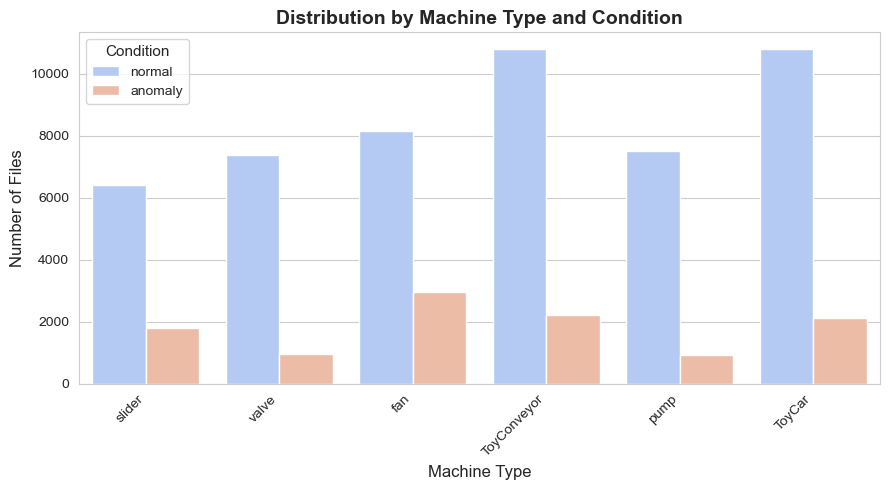

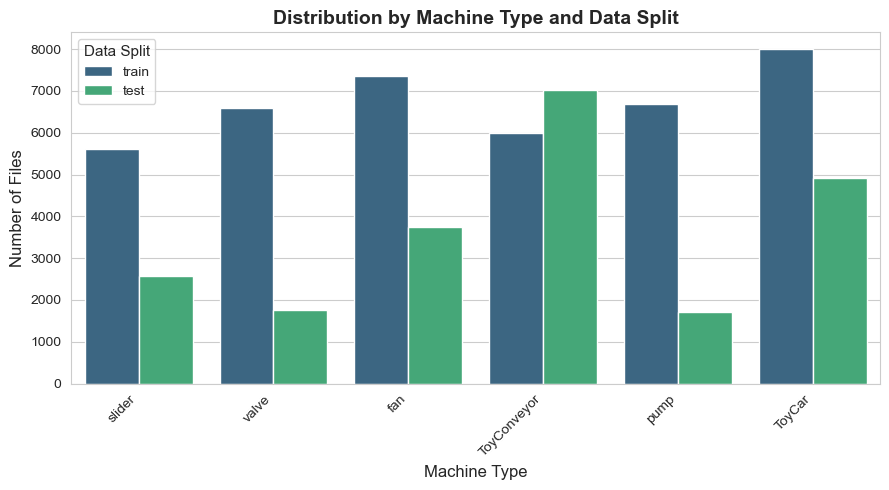

In [8]:
# 🔍 Visualisations complémentaires des répartitions par machine, condition et ensemble de données
visualization.plot_catplot(dataframe=data_df)

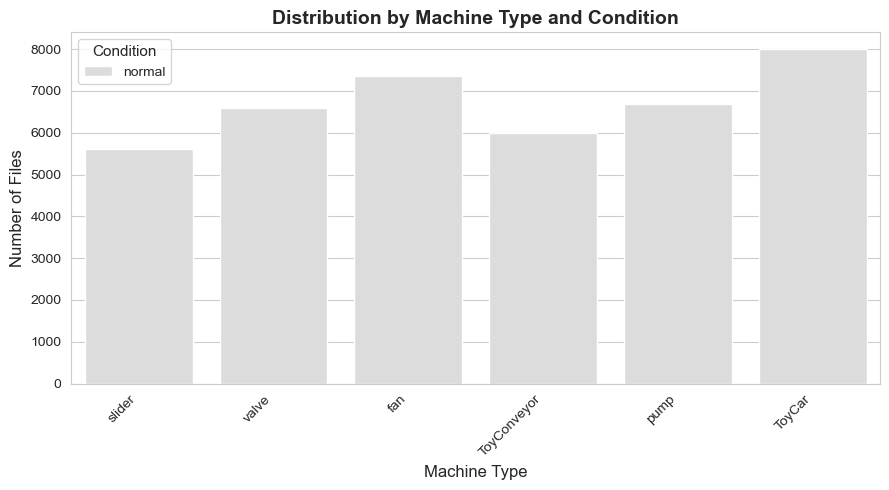

In [9]:
visualization.plot_catplot(dataframe=data_df, data_split="train")

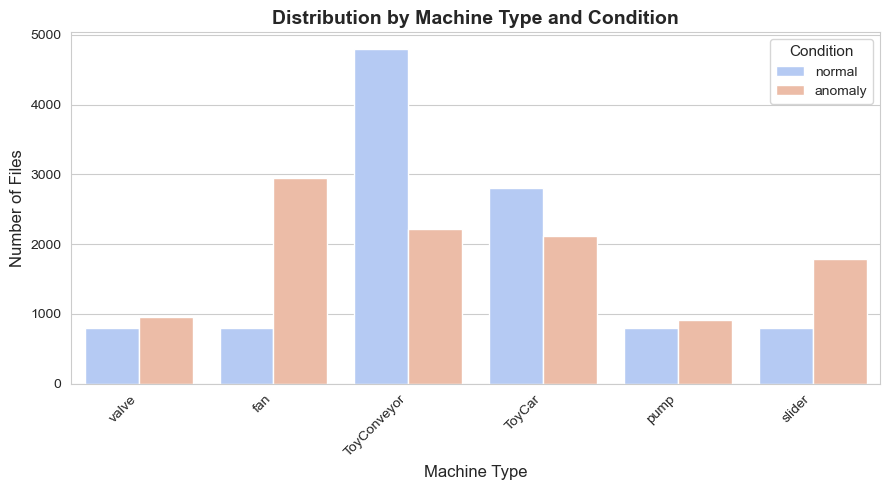

In [10]:
visualization.plot_catplot(dataframe=data_df, data_split="test")

## 🔊 3. Analyse Exploratoire des Audios Bruts

Cette étape permet d'observer visuellement les différences potentielles entre les sons normaux et anormaux directement à partir des signaux audio bruts.

**Objectifs :**
- Visualiser et comparer les formes d'onde de sons normaux et anormaux.
- Analyser et comparer leurs spectrogrammes (représentation temps-fréquence).


2025-03-24 14:11:14 - INFO - ✅ Exemple son normal : normal_id_00_00000657_seg1.npy
2025-03-24 14:11:14 - INFO - ⚠️ Exemple son anomalie : anomaly_id_02_00000211_seg0.npy


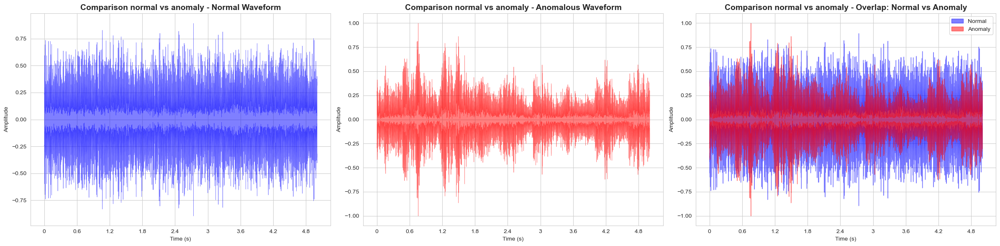

🔊 Listen to 'Comparison normal vs anomaly' - Normal Audio: normal_id_00_00000657_seg1.npy


🔊 Listen to 'Comparison normal vs anomaly' - Anomaly Audio: anomaly_id_02_00000211_seg0.npy


In [11]:
# 🎧 Sélection d'un exemple de fichier audio "normal" et "anomalie"
normal_example = Path(data_df[data_df['condition'] == 'normal'].iloc[0]['file_path'])
anomaly_example = Path(data_df[data_df['condition'] == 'anomaly'].iloc[0]['file_path'])

# 📌 Logging clair des fichiers sélectionnés
logger.info(f"✅ Exemple son normal : {normal_example.name}")
logger.info(f"⚠️ Exemple son anomalie : {anomaly_example.name}")

# 🔊 Affichage des formes d'onde côte-à-côte
visualization.display_comparison_waveforms(
    normal_path=normal_example,
    anomaly_path=anomaly_example,
    sr=sample_rate,
    machine_type="Comparison Normal vs Anomaly"
)

2025-03-22 15:35:16 - INFO - ✅ Exemple son normal [fan] : normal_id_04_00000048.npy
2025-03-22 15:35:16 - INFO - ⚠️ Exemple son anomalie [fan] : anomaly_id_06_00000153.npy


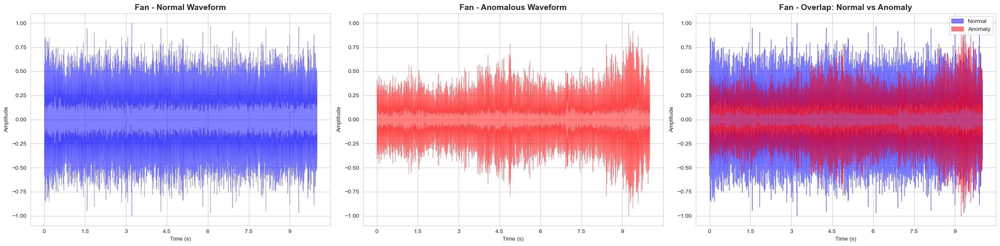

🔊 Listen to 'Fan' - Normal Audio: normal_id_04_00000048.npy


🔊 Listen to 'Fan' - Anomaly Audio: anomaly_id_06_00000153.npy


In [12]:
# 🎧 Sélection aléatoire des fichiers audio 'pump'
machine_type = 'fan'

pump_normal = Path(data_df.loc[
    (data_df['machine_type'] == machine_type) & 
    (data_df['condition'] == 'normal'), 
    'file_path'
].sample(1).iloc[0])

pump_anomaly = Path(data_df.loc[
    (data_df['machine_type'] == machine_type) & 
    (data_df['condition'] == 'anomaly'), 
    'file_path'
].sample(1).iloc[0])

# 📌 Logging clair des fichiers sélectionnés
logger.info(f"✅ Exemple son normal [{machine_type}] : {pump_normal.name}")
logger.info(f"⚠️ Exemple son anomalie [{machine_type}] : {pump_anomaly.name}")

# 🔊 Affichage comparatif des formes d'onde avec écoute intégrée
visualization.display_comparison_waveforms(
    normal_path=pump_normal,
    anomaly_path=pump_anomaly,
    sr=sample_rate,
    machine_type=machine_type.capitalize()
)


2025-03-22 15:35:19 - INFO - ✅ Exemple son normal [pump] : normal_id_06_00000390.npy
2025-03-22 15:35:19 - INFO - ⚠️ Exemple son anomalie [pump] : anomaly_id_02_00000024.npy


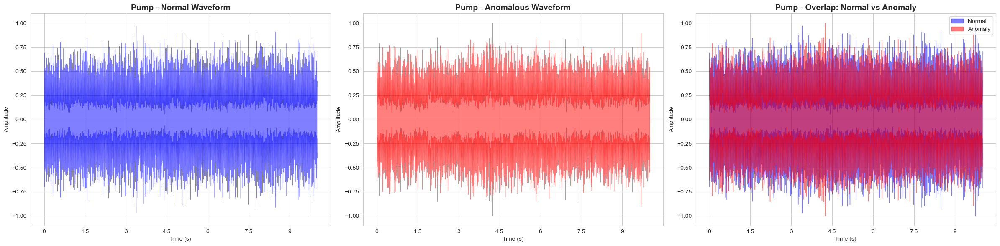

🔊 Listen to 'Pump' - Normal Audio: normal_id_06_00000390.npy


🔊 Listen to 'Pump' - Anomaly Audio: anomaly_id_02_00000024.npy


In [13]:
# 🎧 Sélection aléatoire des fichiers audio 'pump'
machine_type = 'pump'

pump_normal = Path(data_df.loc[
    (data_df['machine_type'] == machine_type) & 
    (data_df['condition'] == 'normal'), 
    'file_path'
].sample(1).iloc[0])

pump_anomaly = Path(data_df.loc[
    (data_df['machine_type'] == machine_type) & 
    (data_df['condition'] == 'anomaly'), 
    'file_path'
].sample(1).iloc[0])

# 📌 Logging clair des fichiers sélectionnés
logger.info(f"✅ Exemple son normal [{machine_type}] : {pump_normal.name}")
logger.info(f"⚠️ Exemple son anomalie [{machine_type}] : {pump_anomaly.name}")

# 🔊 Affichage comparatif des formes d'onde avec écoute intégrée
visualization.display_comparison_waveforms(
    normal_path=pump_normal,
    anomaly_path=pump_anomaly,
    sr=sample_rate,
    machine_type=machine_type.capitalize()
)


2025-03-22 15:35:23 - INFO - ✅ Exemple son normal [slider] : normal_id_02_00000182.npy
2025-03-22 15:35:23 - INFO - ⚠️ Exemple son anomalie [slider] : anomaly_id_04_00000026.npy


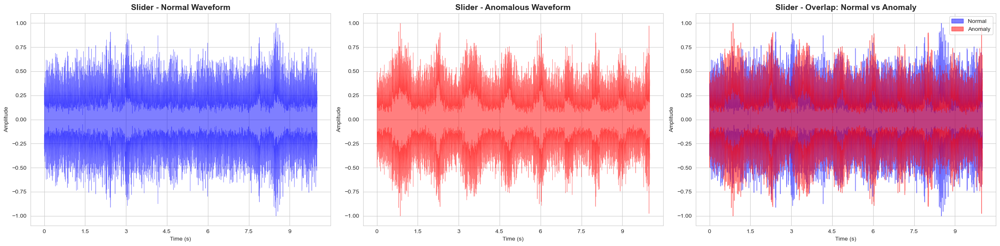

🔊 Listen to 'Slider' - Normal Audio: normal_id_02_00000182.npy


🔊 Listen to 'Slider' - Anomaly Audio: anomaly_id_04_00000026.npy


In [14]:
# 🎧 Sélection aléatoire des fichiers audio 'pump'
machine_type = 'slider'

pump_normal = Path(data_df.loc[
    (data_df['machine_type'] == machine_type) & 
    (data_df['condition'] == 'normal'), 
    'file_path'
].sample(1).iloc[0])

pump_anomaly = Path(data_df.loc[
    (data_df['machine_type'] == machine_type) & 
    (data_df['condition'] == 'anomaly'), 
    'file_path'
].sample(1).iloc[0])

# 📌 Logging clair des fichiers sélectionnés
logger.info(f"✅ Exemple son normal [{machine_type}] : {pump_normal.name}")
logger.info(f"⚠️ Exemple son anomalie [{machine_type}] : {pump_anomaly.name}")

# 🔊 Affichage comparatif des formes d'onde avec écoute intégrée
visualization.display_comparison_waveforms(
    normal_path=pump_normal,
    anomaly_path=pump_anomaly,
    sr=sample_rate,
    machine_type=machine_type.capitalize()
)


2025-03-22 15:35:26 - INFO - ✅ Exemple son normal [ToyCar] : normal_id_04_00000056.npy
2025-03-22 15:35:26 - INFO - ⚠️ Exemple son anomalie [ToyCar] : anomaly_id_01_00000230.npy


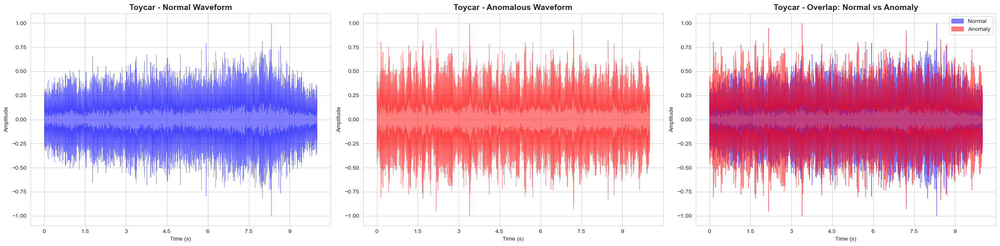

🔊 Listen to 'Toycar' - Normal Audio: normal_id_04_00000056.npy


🔊 Listen to 'Toycar' - Anomaly Audio: anomaly_id_01_00000230.npy


In [15]:
# 🎧 Sélection aléatoire des fichiers audio 'pump'
machine_type = 'ToyCar'

pump_normal = Path(data_df.loc[
    (data_df['machine_type'] == machine_type) & 
    (data_df['condition'] == 'normal'), 
    'file_path'
].sample(1).iloc[0])

pump_anomaly = Path(data_df.loc[
    (data_df['machine_type'] == machine_type) & 
    (data_df['condition'] == 'anomaly'), 
    'file_path'
].sample(1).iloc[0])

# 📌 Logging clair des fichiers sélectionnés
logger.info(f"✅ Exemple son normal [{machine_type}] : {pump_normal.name}")
logger.info(f"⚠️ Exemple son anomalie [{machine_type}] : {pump_anomaly.name}")

# 🔊 Affichage comparatif des formes d'onde avec écoute intégrée
visualization.display_comparison_waveforms(
    normal_path=pump_normal,
    anomaly_path=pump_anomaly,
    sr=sample_rate,
    machine_type=machine_type.capitalize()
)


2025-03-22 15:35:29 - INFO - ✅ Exemple son normal [ToyConveyor] : normal_id_01_00000280.npy
2025-03-22 15:35:29 - INFO - ⚠️ Exemple son anomalie [ToyConveyor] : anomaly_id_01_00000332.npy


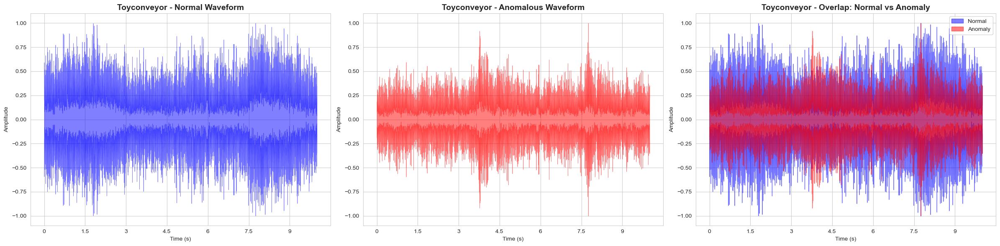

🔊 Listen to 'Toyconveyor' - Normal Audio: normal_id_01_00000280.npy


🔊 Listen to 'Toyconveyor' - Anomaly Audio: anomaly_id_01_00000332.npy


In [16]:
# 🎧 Sélection aléatoire des fichiers audio 'pump'
machine_type = 'ToyConveyor'

pump_normal = Path(data_df.loc[
    (data_df['machine_type'] == machine_type) & 
    (data_df['condition'] == 'normal'), 
    'file_path'
].sample(1).iloc[0])

pump_anomaly = Path(data_df.loc[
    (data_df['machine_type'] == machine_type) & 
    (data_df['condition'] == 'anomaly'), 
    'file_path'
].sample(1).iloc[0])

# 📌 Logging clair des fichiers sélectionnés
logger.info(f"✅ Exemple son normal [{machine_type}] : {pump_normal.name}")
logger.info(f"⚠️ Exemple son anomalie [{machine_type}] : {pump_anomaly.name}")

# 🔊 Affichage comparatif des formes d'onde avec écoute intégrée
visualization.display_comparison_waveforms(
    normal_path=pump_normal,
    anomaly_path=pump_anomaly,
    sr=sample_rate,
    machine_type=machine_type.capitalize()
)


2025-03-22 15:35:33 - INFO - ✅ Exemple son normal [valve] : normal_id_02_00000561.npy
2025-03-22 15:35:33 - INFO - ⚠️ Exemple son anomalie [valve] : anomaly_id_06_00000109.npy


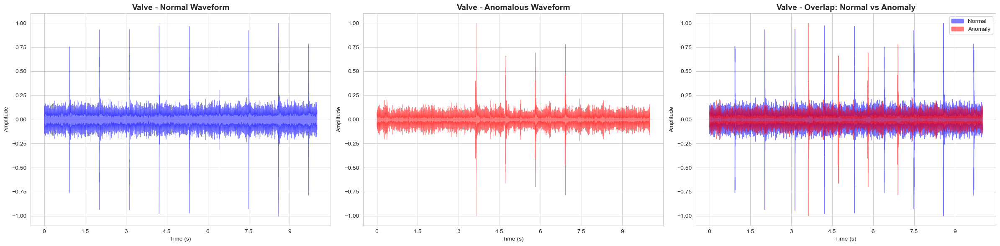

🔊 Listen to 'Valve' - Normal Audio: normal_id_02_00000561.npy


🔊 Listen to 'Valve' - Anomaly Audio: anomaly_id_06_00000109.npy


In [17]:
# 🎧 Sélection aléatoire des fichiers audio 'pump'
machine_type = 'valve'

pump_normal = Path(data_df.loc[
    (data_df['machine_type'] == machine_type) & 
    (data_df['condition'] == 'normal'), 
    'file_path'
].sample(1).iloc[0])

pump_anomaly = Path(data_df.loc[
    (data_df['machine_type'] == machine_type) & 
    (data_df['condition'] == 'anomaly'), 
    'file_path'
].sample(1).iloc[0])

# 📌 Logging clair des fichiers sélectionnés
logger.info(f"✅ Exemple son normal [{machine_type}] : {pump_normal.name}")
logger.info(f"⚠️ Exemple son anomalie [{machine_type}] : {pump_anomaly.name}")

# 🔊 Affichage comparatif des formes d'onde avec écoute intégrée
visualization.display_comparison_waveforms(
    normal_path=pump_normal,
    anomaly_path=pump_anomaly,
    sr=sample_rate,
    machine_type=machine_type.capitalize()
)


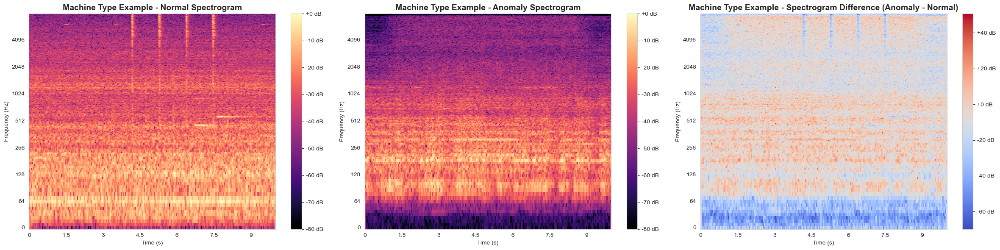

In [18]:
# 🔊  Affichage comparatif des power spectrograms
visualization.display_comparison_powerspectralforms(
    normal_path=normal_example,
    anomaly_path=anomaly_example,
    sr=sample_rate,
    machine_type="Machine Type Example"
)

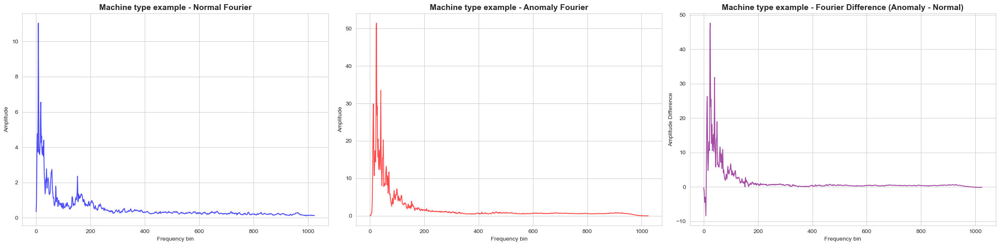

In [19]:
# 🔊  Affichage comparatif des Fourier transform (frequency distribution)
visualization.display_comparison_fourier(
    normal_path=normal_example,
    anomaly_path=anomaly_example,
    sr=sample_rate,
    machine_type="Machine Type Example"
)

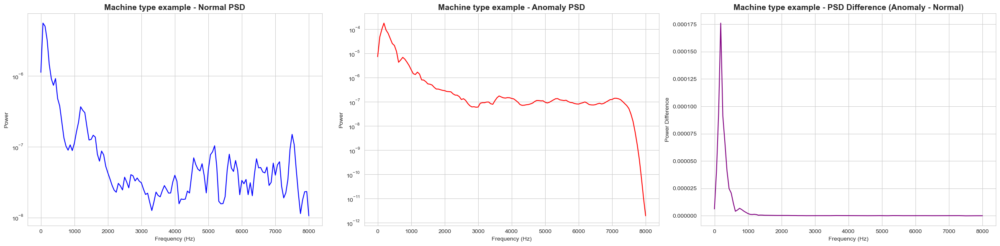

In [20]:
# 🔊  Affichage comparatif des power spectral density (PSD)
visualization.display_comparison_psd(
    normal_path=normal_example,
    anomaly_path=anomaly_example,
    sr=sample_rate,
    machine_type="Machine Type Example"
)

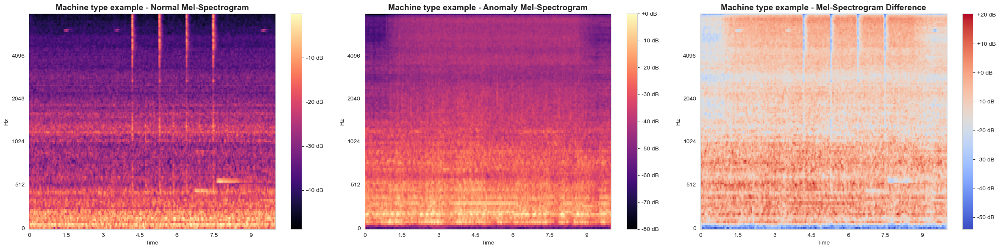

In [21]:
# 🔊  Affichage comparatif des Mel Spectrogram
visualization.display_comparison_melspectrogram(
    normal_path=normal_example,
    anomaly_path=anomaly_example,
    sr=sample_rate,
    machine_type="Machine Type Example"
)

## 📦 4. Extraction et Visualisation des Features Audio

Cette étape consiste à extraire des caractéristiques audio utiles à partir des fichiers `.npy` prétraités (signal normalisé). Ces features serviront à entraîner les modèles de détection d'anomalies.

**Objectifs de cette étape :**
- Extraire les features suivantes :
  - MFCC + delta + delta²
  - Mel-Spectrogram (log)
  - Spectral contrast, ZCR, RMS, Spectral centroid, rolloff, etc.
- Charger les features extraites et les visualiser.
- Comparer les valeurs statistiques entre les sons normaux et anormaux.


In [22]:
# 📌 Extraction des Features Audio à partir des fichiers .npy
processing.process_all_npy_files(
    numpy_dir=config.NUMPY_AUDIO_DIR,
    features_dir=config.FEATURES_DIR,
    sr=config.SR,
    hop_length=config.HOP_LENGTH,
    n_mels=config.N_MELS,
    n_fft=config.N_FFT,
    n_mfcc=config.N_MFCC
)


Processing .npy files:   0%|                                                               | 0/30987 [00:00<?, ?file/s]2025-03-22 15:35:39 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:35:40 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   0%|                                                       | 2/30987 [00:00<33:35, 15.37file/s]2025-03-22 15:35:40 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:35:40 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   0%|                                                       | 4/30987 [00:00<30:16, 17.05file/s]2025-03-22 15:35:40 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:35:40 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   0%|                                                       | 6/3098

2025-03-22 15:35:45 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   0%|▏                                                    | 113/30987 [00:06<29:09, 17.65file/s]2025-03-22 15:35:46 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:35:46 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   0%|▏                                                    | 115/30987 [00:06<28:48, 17.86file/s]2025-03-22 15:35:46 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:35:46 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   0%|▏                                                    | 117/30987 [00:06<28:13, 18.22file/s]2025-03-22 15:35:46 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:35:46 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

2025-03-22 15:35:51 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:35:51 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   1%|▍                                                    | 228/30987 [00:12<26:28, 19.37file/s]2025-03-22 15:35:52 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:35:52 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:35:52 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   1%|▍                                                    | 231/30987 [00:12<25:46, 19.88file/s]2025-03-22 15:35:52 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:35:52 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   1%|▍                                                    | 233/30987 [00:12<25:46, 19.88file/s

2025-03-22 15:35:54 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   1%|▍                                                    | 288/30987 [00:15<26:07, 19.58file/s]2025-03-22 15:35:55 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:35:55 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:35:55 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   1%|▍                                                    | 291/30987 [00:15<26:00, 19.67file/s]2025-03-22 15:35:55 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:35:55 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   1%|▌                                                    | 293/30987 [00:15<26:40, 19.18file/s]2025-03-22 15:35:55 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

2025-03-22 15:35:57 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   1%|▌                                                    | 344/30987 [00:18<25:14, 20.23file/s]2025-03-22 15:35:57 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:35:58 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:35:58 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   1%|▌                                                    | 347/30987 [00:18<25:12, 20.25file/s]2025-03-22 15:35:58 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:35:58 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:35:58 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   1%|▌                                                    | 350/30987 [00:18<25:29, 20.04file/s

2025-03-22 15:36:01 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   1%|▋                                                    | 403/30987 [00:21<27:35, 18.47file/s]2025-03-22 15:36:01 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:36:01 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   1%|▋                                                    | 405/30987 [00:21<27:44, 18.38file/s]2025-03-22 15:36:01 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:36:01 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   1%|▋                                                    | 407/30987 [00:21<27:42, 18.40file/s]2025-03-22 15:36:01 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:36:01 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

2025-03-22 15:36:03 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   1%|▊                                                    | 460/30987 [00:24<26:13, 19.41file/s]2025-03-22 15:36:04 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:36:04 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   1%|▊                                                    | 462/30987 [00:24<26:17, 19.36file/s]2025-03-22 15:36:04 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:36:04 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   1%|▊                                                    | 464/30987 [00:24<26:31, 19.18file/s]2025-03-22 15:36:04 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:36:04 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

Processing .npy files:   2%|▉                                                    | 569/30987 [00:29<26:17, 19.28file/s]2025-03-22 15:36:09 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:36:09 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   2%|▉                                                    | 571/30987 [00:29<26:29, 19.14file/s]2025-03-22 15:36:09 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:36:09 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   2%|▉                                                    | 573/30987 [00:30<26:52, 18.86file/s]2025-03-22 15:36:10 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:36:10 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   2%|▉                                                    | 575/3098

2025-03-22 15:36:12 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:36:12 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   2%|█                                                    | 628/30987 [00:32<24:50, 20.37file/s]2025-03-22 15:36:12 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:36:12 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:36:12 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   2%|█                                                    | 631/30987 [00:33<25:11, 20.08file/s]2025-03-22 15:36:13 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:36:13 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:36:13 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   2

Processing .npy files:   2%|█▏                                                   | 687/30987 [00:35<27:32, 18.33file/s]2025-03-22 15:36:15 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:36:15 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   2%|█▏                                                   | 689/30987 [00:36<27:34, 18.32file/s]2025-03-22 15:36:15 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:36:16 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   2%|█▏                                                   | 691/30987 [00:36<27:17, 18.51file/s]2025-03-22 15:36:16 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:36:16 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   2%|█▏                                                   | 693/3098

Processing .npy files:   2%|█▎                                                   | 744/30987 [00:38<25:55, 19.45file/s]2025-03-22 15:36:18 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:36:18 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   2%|█▎                                                   | 746/30987 [00:38<26:05, 19.32file/s]2025-03-22 15:36:18 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:36:18 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   2%|█▎                                                   | 748/30987 [00:39<26:19, 19.15file/s]2025-03-22 15:36:19 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:36:19 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   2%|█▎                                                   | 750/3098

2025-03-22 15:36:24 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   3%|█▍                                                   | 858/30987 [00:44<24:40, 20.35file/s]2025-03-22 15:36:24 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:36:24 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:36:24 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   3%|█▍                                                   | 861/30987 [00:44<24:28, 20.52file/s]2025-03-22 15:36:24 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:36:24 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:36:24 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   3%|█▍                                                   | 864/30987 [00:45<24:58, 20.10file/s

2025-03-22 15:36:27 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   3%|█▌                                                   | 914/30987 [00:47<26:02, 19.25file/s]2025-03-22 15:36:27 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:36:27 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:36:27 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   3%|█▌                                                   | 917/30987 [00:47<25:23, 19.74file/s]2025-03-22 15:36:27 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:36:27 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   3%|█▌                                                   | 919/30987 [00:47<25:27, 19.68file/s]2025-03-22 15:36:27 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

2025-03-22 15:36:30 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   3%|█▋                                                   | 974/30987 [00:50<27:01, 18.51file/s]2025-03-22 15:36:30 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:36:30 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   3%|█▋                                                   | 976/30987 [00:50<26:36, 18.80file/s]2025-03-22 15:36:30 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:36:30 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   3%|█▋                                                   | 978/30987 [00:50<26:29, 18.88file/s]2025-03-22 15:36:30 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:36:30 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

Processing .npy files:   3%|█▋                                                  | 1030/30987 [00:53<26:26, 18.89file/s]2025-03-22 15:36:33 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:36:33 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   3%|█▋                                                  | 1032/30987 [00:53<26:44, 18.67file/s]2025-03-22 15:36:33 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:36:33 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   3%|█▋                                                  | 1034/30987 [00:53<26:45, 18.66file/s]2025-03-22 15:36:33 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:36:33 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:36:33 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

2025-03-22 15:36:36 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   4%|█▊                                                  | 1087/30987 [00:56<26:27, 18.83file/s]2025-03-22 15:36:36 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:36:36 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   4%|█▊                                                  | 1089/30987 [00:56<26:29, 18.81file/s]2025-03-22 15:36:36 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:36:36 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   4%|█▊                                                  | 1091/30987 [00:56<26:03, 19.12file/s]2025-03-22 15:36:36 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:36:36 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

Processing .npy files:   4%|██                                                  | 1201/30987 [01:02<25:11, 19.70file/s]2025-03-22 15:36:42 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:36:42 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:36:42 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   4%|██                                                  | 1204/30987 [01:02<24:54, 19.93file/s]2025-03-22 15:36:42 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:36:42 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:36:42 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   4%|██                                                  | 1207/30987 [01:02<24:35, 20.18file/s]2025-03-22 15:36:42 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

2025-03-22 15:36:45 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   4%|██                                                  | 1263/30987 [01:05<26:29, 18.70file/s]2025-03-22 15:36:45 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:36:45 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:36:45 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   4%|██                                                  | 1266/30987 [01:05<26:06, 18.97file/s]2025-03-22 15:36:45 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:36:45 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   4%|██▏                                                 | 1268/30987 [01:05<26:11, 18.91file/s]2025-03-22 15:36:45 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

2025-03-22 15:36:48 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   4%|██▏                                                 | 1323/30987 [01:08<25:02, 19.74file/s]2025-03-22 15:36:48 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:36:48 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   4%|██▏                                                 | 1325/30987 [01:08<25:36, 19.31file/s]2025-03-22 15:36:48 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:36:48 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   4%|██▏                                                 | 1327/30987 [01:08<25:38, 19.28file/s]2025-03-22 15:36:48 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:36:48 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

2025-03-22 15:36:51 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   4%|██▎                                                 | 1380/30987 [01:11<26:37, 18.53file/s]2025-03-22 15:36:51 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:36:51 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   4%|██▎                                                 | 1382/30987 [01:11<26:25, 18.67file/s]2025-03-22 15:36:51 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:36:51 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:36:51 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   4%|██▎                                                 | 1385/30987 [01:11<25:03, 19.69file/s]2025-03-22 15:36:51 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

2025-03-22 15:36:57 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:36:57 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   5%|██▌                                                 | 1498/30987 [01:17<24:44, 19.87file/s]2025-03-22 15:36:57 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:36:57 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:36:57 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   5%|██▌                                                 | 1501/30987 [01:17<24:33, 20.01file/s]2025-03-22 15:36:57 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:36:57 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   5%|██▌                                                 | 1503/30987 [01:17<24:39, 19.93file/s

2025-03-22 15:37:00 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   5%|██▌                                                 | 1558/30987 [01:20<25:55, 18.92file/s]2025-03-22 15:37:00 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:37:00 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   5%|██▌                                                 | 1560/30987 [01:20<25:44, 19.05file/s]2025-03-22 15:37:00 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:37:00 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   5%|██▌                                                 | 1562/30987 [01:20<25:49, 18.99file/s]2025-03-22 15:37:00 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:37:00 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

2025-03-22 15:37:06 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   5%|██▊                                                 | 1677/30987 [01:26<26:27, 18.47file/s]2025-03-22 15:37:06 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:37:06 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:37:06 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   5%|██▊                                                 | 1680/30987 [01:26<25:15, 19.33file/s]2025-03-22 15:37:06 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:37:06 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   5%|██▊                                                 | 1682/30987 [01:26<25:10, 19.40file/s]2025-03-22 15:37:06 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

2025-03-22 15:37:09 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   6%|██▉                                                 | 1739/30987 [01:29<22:28, 21.69file/s]2025-03-22 15:37:09 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:37:09 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:37:09 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   6%|██▉                                                 | 1742/30987 [01:29<22:52, 21.31file/s]2025-03-22 15:37:09 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:37:09 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:37:09 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   6%|██▉                                                 | 1745/30987 [01:29<23:03, 21.13file/s

2025-03-22 15:37:15 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   6%|███                                                 | 1861/30987 [01:35<23:44, 20.45file/s]2025-03-22 15:37:15 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:37:15 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:37:15 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   6%|███▏                                                | 1864/30987 [01:35<24:10, 20.08file/s]2025-03-22 15:37:15 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:37:15 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:37:15 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   6%|███▏                                                | 1867/30987 [01:35<24:26, 19.85file/s

Processing .npy files:   6%|███▏                                                | 1922/30987 [01:38<23:03, 21.01file/s]2025-03-22 15:37:18 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:37:18 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:37:18 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   6%|███▏                                                | 1925/30987 [01:38<22:50, 21.21file/s]2025-03-22 15:37:18 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:37:18 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:37:18 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   6%|███▏                                                | 1928/30987 [01:38<22:47, 21.25file/s]2025-03-22 15:37:18 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

2025-03-22 15:37:21 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   6%|███▎                                                | 1985/30987 [01:41<23:28, 20.59file/s]2025-03-22 15:37:21 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:37:21 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:37:21 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   6%|███▎                                                | 1988/30987 [01:41<23:31, 20.55file/s]2025-03-22 15:37:21 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:37:21 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:37:21 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   6%|███▎                                                | 1991/30987 [01:41<23:05, 20.93file/s

2025-03-22 15:37:24 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:37:24 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   7%|███▍                                                | 2048/30987 [01:44<21:54, 22.02file/s]2025-03-22 15:37:24 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:37:24 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:37:24 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   7%|███▍                                                | 2051/30987 [01:44<21:40, 22.26file/s]2025-03-22 15:37:24 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:37:24 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:37:24 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   7

Processing .npy files:   7%|███▌                                                | 2107/30987 [01:47<24:10, 19.92file/s]2025-03-22 15:37:27 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:37:27 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:37:27 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   7%|███▌                                                | 2110/30987 [01:47<23:08, 20.79file/s]2025-03-22 15:37:27 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:37:27 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:37:27 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   7%|███▌                                                | 2113/30987 [01:47<22:55, 20.99file/s]2025-03-22 15:37:27 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

2025-03-22 15:37:30 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   7%|███▋                                                | 2170/30987 [01:50<23:15, 20.65file/s]2025-03-22 15:37:30 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:37:30 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:37:30 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   7%|███▋                                                | 2173/30987 [01:50<23:08, 20.75file/s]2025-03-22 15:37:30 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:37:30 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:37:30 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   7%|███▋                                                | 2176/30987 [01:50<23:01, 20.85file/s

2025-03-22 15:37:33 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:37:33 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   7%|███▋                                                | 2232/30987 [01:53<21:57, 21.82file/s]2025-03-22 15:37:33 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:37:33 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:37:33 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   7%|███▊                                                | 2235/30987 [01:53<22:44, 21.07file/s]2025-03-22 15:37:33 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:37:33 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:37:33 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   7

2025-03-22 15:37:36 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:37:36 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   7%|███▊                                                | 2294/30987 [01:56<23:56, 19.98file/s]2025-03-22 15:37:36 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:37:36 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:37:36 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   7%|███▊                                                | 2297/30987 [01:56<24:02, 19.89file/s]2025-03-22 15:37:36 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:37:36 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:37:36 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   7

Processing .npy files:   8%|████                                                | 2414/30987 [02:02<22:35, 21.07file/s]2025-03-22 15:37:41 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:37:42 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:37:42 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   8%|████                                                | 2417/30987 [02:02<23:00, 20.69file/s]2025-03-22 15:37:42 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:37:42 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:37:42 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   8%|████                                                | 2420/30987 [02:02<23:08, 20.57file/s]2025-03-22 15:37:42 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

2025-03-22 15:37:44 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   8%|████▏                                               | 2477/30987 [02:04<22:14, 21.37file/s]2025-03-22 15:37:44 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:37:44 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:37:45 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   8%|████▏                                               | 2480/30987 [02:05<22:36, 21.01file/s]2025-03-22 15:37:45 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:37:45 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:37:45 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   8%|████▏                                               | 2483/30987 [02:05<23:20, 20.36file/s

2025-03-22 15:37:50 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   8%|████▎                                               | 2598/30987 [02:10<23:48, 19.87file/s]2025-03-22 15:37:50 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:37:50 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   8%|████▎                                               | 2600/30987 [02:10<23:48, 19.87file/s]2025-03-22 15:37:50 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:37:50 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   8%|████▎                                               | 2602/30987 [02:11<23:57, 19.75file/s]2025-03-22 15:37:51 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:37:51 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

2025-03-22 15:37:53 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:37:53 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   9%|████▍                                               | 2660/30987 [02:13<22:02, 21.43file/s]2025-03-22 15:37:53 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:37:53 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:37:53 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   9%|████▍                                               | 2663/30987 [02:13<22:00, 21.45file/s]2025-03-22 15:37:53 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:37:53 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:37:54 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   9

2025-03-22 15:37:59 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   9%|████▋                                               | 2781/30987 [02:19<21:38, 21.73file/s]2025-03-22 15:37:59 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:37:59 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:37:59 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   9%|████▋                                               | 2784/30987 [02:19<21:41, 21.68file/s]2025-03-22 15:37:59 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:37:59 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:37:59 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   9%|████▋                                               | 2787/30987 [02:19<22:01, 21.33file/s

2025-03-22 15:38:02 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:38:02 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   9%|████▊                                               | 2842/30987 [02:22<22:40, 20.68file/s]2025-03-22 15:38:02 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:38:02 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:38:02 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   9%|████▊                                               | 2845/30987 [02:22<22:10, 21.15file/s]2025-03-22 15:38:02 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:38:02 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:38:02 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:   9

2025-03-22 15:38:08 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:38:08 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  10%|████▉                                               | 2964/30987 [02:28<23:30, 19.87file/s]2025-03-22 15:38:08 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:38:08 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  10%|████▉                                               | 2966/30987 [02:28<23:44, 19.67file/s]2025-03-22 15:38:08 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:38:08 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:38:08 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  10%|████▉                                               | 2969/30987 [02:28<23:09, 20.16file/s

2025-03-22 15:38:11 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  10%|█████                                               | 3024/30987 [02:31<24:31, 19.01file/s]2025-03-22 15:38:11 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:38:11 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  10%|█████                                               | 3026/30987 [02:31<24:54, 18.70file/s]2025-03-22 15:38:11 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:38:11 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:38:11 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  10%|█████                                               | 3029/30987 [02:31<23:58, 19.44file/s]2025-03-22 15:38:11 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

Processing .npy files:  10%|█████▏                                              | 3085/30987 [02:34<22:00, 21.13file/s]2025-03-22 15:38:14 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:38:14 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:38:14 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  10%|█████▏                                              | 3088/30987 [02:34<21:28, 21.66file/s]2025-03-22 15:38:14 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:38:14 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:38:14 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  10%|█████▏                                              | 3091/30987 [02:34<21:45, 21.36file/s]2025-03-22 15:38:14 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

2025-03-22 15:38:17 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  10%|█████▎                                              | 3147/30987 [02:37<21:23, 21.69file/s]2025-03-22 15:38:17 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:38:17 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:38:17 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  10%|█████▎                                              | 3150/30987 [02:37<21:19, 21.75file/s]2025-03-22 15:38:17 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:38:17 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:38:17 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  10%|█████▎                                              | 3153/30987 [02:37<21:36, 21.46file/s

2025-03-22 15:38:20 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:38:20 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  10%|█████▍                                              | 3210/30987 [02:40<22:44, 20.36file/s]2025-03-22 15:38:20 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:38:20 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:38:20 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  10%|█████▍                                              | 3213/30987 [02:40<23:01, 20.11file/s]2025-03-22 15:38:20 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:38:20 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:38:20 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  10

2025-03-22 15:38:26 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  11%|█████▌                                              | 3331/30987 [02:46<24:04, 19.14file/s]2025-03-22 15:38:26 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:38:26 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  11%|█████▌                                              | 3333/30987 [02:46<24:15, 18.99file/s]2025-03-22 15:38:26 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:38:26 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  11%|█████▌                                              | 3335/30987 [02:46<25:17, 18.22file/s]2025-03-22 15:38:26 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:38:26 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

Processing .npy files:  11%|█████▋                                              | 3391/30987 [02:49<21:49, 21.08file/s]2025-03-22 15:38:29 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:38:29 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:38:29 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  11%|█████▋                                              | 3394/30987 [02:49<21:54, 20.99file/s]2025-03-22 15:38:29 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:38:29 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:38:29 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  11%|█████▋                                              | 3397/30987 [02:49<22:15, 20.66file/s]2025-03-22 15:38:29 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

2025-03-22 15:38:35 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:38:35 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  11%|█████▉                                              | 3514/30987 [02:55<22:49, 20.05file/s]2025-03-22 15:38:35 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:38:35 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:38:35 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  11%|█████▉                                              | 3517/30987 [02:55<23:29, 19.48file/s]2025-03-22 15:38:35 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:38:35 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:38:35 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  11

2025-03-22 15:38:41 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  12%|██████                                              | 3634/30987 [03:01<23:07, 19.72file/s]2025-03-22 15:38:41 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:38:41 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  12%|██████                                              | 3636/30987 [03:01<23:11, 19.66file/s]2025-03-22 15:38:41 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:38:41 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  12%|██████                                              | 3638/30987 [03:01<23:42, 19.23file/s]2025-03-22 15:38:41 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:38:41 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

Processing .npy files:  12%|██████▎                                             | 3755/30987 [03:07<21:12, 21.40file/s]2025-03-22 15:38:47 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:38:47 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:38:47 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  12%|██████▎                                             | 3758/30987 [03:07<20:48, 21.81file/s]2025-03-22 15:38:47 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:38:47 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:38:47 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  12%|██████▎                                             | 3761/30987 [03:07<21:07, 21.48file/s]2025-03-22 15:38:47 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

2025-03-22 15:38:50 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  12%|██████▍                                             | 3818/30987 [03:10<23:09, 19.56file/s]2025-03-22 15:38:50 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:38:50 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  12%|██████▍                                             | 3820/30987 [03:10<23:12, 19.50file/s]2025-03-22 15:38:50 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:38:50 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  12%|██████▍                                             | 3822/30987 [03:10<23:05, 19.61file/s]2025-03-22 15:38:50 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:38:50 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

2025-03-22 15:38:52 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  13%|██████▌                                             | 3878/30987 [03:13<21:40, 20.84file/s]2025-03-22 15:38:53 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:38:53 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:38:53 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  13%|██████▌                                             | 3881/30987 [03:13<21:28, 21.04file/s]2025-03-22 15:38:53 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:38:53 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:38:53 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  13%|██████▌                                             | 3884/30987 [03:13<21:20, 21.16file/s

2025-03-22 15:38:55 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:38:56 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  13%|██████▌                                             | 3941/30987 [03:16<23:16, 19.37file/s]2025-03-22 15:38:56 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:38:56 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  13%|██████▌                                             | 3943/30987 [03:16<23:28, 19.20file/s]2025-03-22 15:38:56 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:38:56 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  13%|██████▌                                             | 3945/30987 [03:16<23:18, 19.33file/s]2025-03-22 15:38:56 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

Processing .npy files:  13%|██████▊                                             | 4061/30987 [03:21<22:19, 20.10file/s]2025-03-22 15:39:01 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:39:01 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:39:02 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  13%|██████▊                                             | 4064/30987 [03:22<21:49, 20.56file/s]2025-03-22 15:39:02 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:39:02 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:39:02 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  13%|██████▊                                             | 4067/30987 [03:22<21:33, 20.81file/s]2025-03-22 15:39:02 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

2025-03-22 15:39:04 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  13%|██████▉                                             | 4124/30987 [03:24<20:16, 22.07file/s]2025-03-22 15:39:04 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:39:04 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:39:04 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  13%|██████▉                                             | 4127/30987 [03:25<20:53, 21.43file/s]2025-03-22 15:39:05 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:39:05 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:39:05 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  13%|██████▉                                             | 4130/30987 [03:25<21:16, 21.04file/s

2025-03-22 15:39:07 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:39:07 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  14%|███████                                             | 4187/30987 [03:27<20:40, 21.60file/s]2025-03-22 15:39:07 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:39:07 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:39:08 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  14%|███████                                             | 4190/30987 [03:28<20:01, 22.30file/s]2025-03-22 15:39:08 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:39:08 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:39:08 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  14

2025-03-22 15:39:13 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  14%|███████▏                                            | 4309/30987 [03:33<20:40, 21.50file/s]2025-03-22 15:39:13 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:39:13 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:39:13 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  14%|███████▏                                            | 4312/30987 [03:33<20:41, 21.48file/s]2025-03-22 15:39:13 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:39:13 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:39:13 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  14%|███████▏                                            | 4315/30987 [03:33<20:30, 21.67file/s

2025-03-22 15:39:16 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  14%|███████▎                                            | 4370/30987 [03:36<22:35, 19.63file/s]2025-03-22 15:39:16 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:39:16 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:39:16 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  14%|███████▎                                            | 4373/30987 [03:36<22:17, 19.90file/s]2025-03-22 15:39:16 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:39:16 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:39:16 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  14%|███████▎                                            | 4376/30987 [03:36<22:11, 19.99file/s

2025-03-22 15:39:19 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:39:19 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  14%|███████▍                                            | 4433/30987 [03:39<20:32, 21.54file/s]2025-03-22 15:39:19 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:39:19 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:39:19 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  14%|███████▍                                            | 4436/30987 [03:39<20:24, 21.68file/s]2025-03-22 15:39:19 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:39:19 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:39:19 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  14

2025-03-22 15:39:25 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  15%|███████▋                                            | 4555/30987 [03:45<21:36, 20.39file/s]2025-03-22 15:39:25 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:39:25 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:39:25 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  15%|███████▋                                            | 4558/30987 [03:45<21:48, 20.20file/s]2025-03-22 15:39:25 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:39:25 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:39:25 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  15%|███████▋                                            | 4561/30987 [03:45<22:17, 19.75file/s

2025-03-22 15:39:28 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:39:28 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  15%|███████▋                                            | 4615/30987 [03:48<20:25, 21.52file/s]2025-03-22 15:39:28 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:39:28 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:39:28 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  15%|███████▋                                            | 4618/30987 [03:48<19:29, 22.54file/s]2025-03-22 15:39:28 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:39:28 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:39:28 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  15

2025-03-22 15:39:31 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:39:31 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  15%|███████▊                                            | 4677/30987 [03:51<21:51, 20.06file/s]2025-03-22 15:39:31 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:39:31 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:39:31 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  15%|███████▊                                            | 4680/30987 [03:51<21:57, 19.96file/s]2025-03-22 15:39:31 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:39:31 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  15%|███████▊                                            | 4682/30987 [03:51<22:04, 19.85file/s

2025-03-22 15:39:34 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:39:34 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  15%|███████▉                                            | 4739/30987 [03:54<21:10, 20.66file/s]2025-03-22 15:39:34 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:39:34 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:39:34 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  15%|███████▉                                            | 4742/30987 [03:54<21:04, 20.75file/s]2025-03-22 15:39:34 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:39:34 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:39:34 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  15

2025-03-22 15:39:40 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  16%|████████▏                                           | 4861/30987 [04:00<21:30, 20.25file/s]2025-03-22 15:39:40 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:39:40 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:39:40 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  16%|████████▏                                           | 4864/30987 [04:00<21:27, 20.29file/s]2025-03-22 15:39:40 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:39:40 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:39:40 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  16%|████████▏                                           | 4867/30987 [04:00<21:48, 19.96file/s

Processing .npy files:  16%|████████▎                                           | 4983/30987 [04:06<21:31, 20.13file/s]2025-03-22 15:39:45 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:39:46 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:39:46 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  16%|████████▎                                           | 4986/30987 [04:06<22:07, 19.58file/s]2025-03-22 15:39:46 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:39:46 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:39:46 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  16%|████████▎                                           | 4989/30987 [04:06<22:07, 19.59file/s]2025-03-22 15:39:46 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

2025-03-22 15:39:48 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:39:48 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  16%|████████▍                                           | 5046/30987 [04:09<19:44, 21.90file/s]2025-03-22 15:39:48 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:39:49 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:39:49 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  16%|████████▍                                           | 5049/30987 [04:09<20:20, 21.25file/s]2025-03-22 15:39:49 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:39:49 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:39:49 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  16

Processing .npy files:  16%|████████▌                                           | 5106/30987 [04:11<20:57, 20.58file/s]2025-03-22 15:39:51 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:39:51 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:39:51 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  16%|████████▌                                           | 5109/30987 [04:12<21:06, 20.43file/s]2025-03-22 15:39:52 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:39:52 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:39:52 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  16%|████████▌                                           | 5112/30987 [04:12<20:52, 20.66file/s]2025-03-22 15:39:52 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

2025-03-22 15:39:54 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  17%|████████▋                                           | 5169/30987 [04:14<20:00, 21.51file/s]2025-03-22 15:39:54 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:39:54 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:39:54 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  17%|████████▋                                           | 5172/30987 [04:15<20:10, 21.33file/s]2025-03-22 15:39:54 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:39:55 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:39:55 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  17%|████████▋                                           | 5175/30987 [04:15<21:15, 20.24file/s

2025-03-22 15:39:57 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:39:57 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  17%|████████▊                                           | 5232/30987 [04:17<19:28, 22.04file/s]2025-03-22 15:39:57 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:39:57 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:39:57 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  17%|████████▊                                           | 5235/30987 [04:18<19:19, 22.21file/s]2025-03-22 15:39:57 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:39:58 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:39:58 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  17

Processing .npy files:  17%|████████▉                                           | 5353/30987 [04:23<19:15, 22.18file/s]2025-03-22 15:40:03 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:40:03 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:40:03 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  17%|████████▉                                           | 5356/30987 [04:23<19:43, 21.66file/s]2025-03-22 15:40:03 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:40:03 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:40:03 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  17%|████████▉                                           | 5359/30987 [04:23<20:14, 21.09file/s]2025-03-22 15:40:03 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

2025-03-22 15:40:09 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  18%|█████████▏                                          | 5477/30987 [04:29<18:57, 22.43file/s]2025-03-22 15:40:09 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:40:09 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:40:09 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  18%|█████████▏                                          | 5480/30987 [04:29<19:07, 22.22file/s]2025-03-22 15:40:09 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:40:09 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:40:09 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  18%|█████████▏                                          | 5483/30987 [04:29<19:35, 21.70file/s

2025-03-22 15:40:12 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:40:12 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  18%|█████████▎                                          | 5540/30987 [04:32<20:32, 20.65file/s]2025-03-22 15:40:12 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:40:12 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:40:12 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  18%|█████████▎                                          | 5543/30987 [04:32<20:11, 21.00file/s]2025-03-22 15:40:12 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:40:12 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:40:12 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  18

2025-03-22 15:40:18 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:40:18 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  18%|█████████▌                                          | 5662/30987 [04:38<20:22, 20.72file/s]2025-03-22 15:40:18 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:40:18 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:40:18 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  18%|█████████▌                                          | 5665/30987 [04:38<20:00, 21.09file/s]2025-03-22 15:40:18 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:40:18 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:40:18 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  18

2025-03-22 15:40:24 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  19%|█████████▋                                          | 5784/30987 [04:44<19:35, 21.44file/s]2025-03-22 15:40:24 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:40:24 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:40:24 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  19%|█████████▋                                          | 5787/30987 [04:44<19:26, 21.60file/s]2025-03-22 15:40:24 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:40:24 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:40:24 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  19%|█████████▋                                          | 5790/30987 [04:44<19:25, 21.63file/s

2025-03-22 15:40:27 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:40:27 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  19%|█████████▊                                          | 5845/30987 [04:47<20:40, 20.28file/s]2025-03-22 15:40:27 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:40:27 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:40:27 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  19%|█████████▊                                          | 5848/30987 [04:47<20:29, 20.44file/s]2025-03-22 15:40:27 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:40:27 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:40:27 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  19

2025-03-22 15:40:33 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  19%|██████████                                          | 5968/30987 [04:53<19:27, 21.44file/s]2025-03-22 15:40:33 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:40:33 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:40:33 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  19%|██████████                                          | 5971/30987 [04:53<20:10, 20.67file/s]2025-03-22 15:40:33 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:40:33 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:40:33 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  19%|██████████                                          | 5974/30987 [04:53<20:39, 20.19file/s

Processing .npy files:  19%|██████████                                          | 6028/30987 [04:56<21:03, 19.75file/s]2025-03-22 15:40:36 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:40:36 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  19%|██████████                                          | 6030/30987 [04:56<21:15, 19.56file/s]2025-03-22 15:40:36 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:40:36 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  19%|██████████                                          | 6032/30987 [04:56<21:31, 19.32file/s]2025-03-22 15:40:36 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:40:36 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  19%|██████████▏                                         | 6034/3098

2025-03-22 15:40:39 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:40:39 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  20%|██████████▏                                         | 6091/30987 [04:59<19:22, 21.42file/s]2025-03-22 15:40:39 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:40:39 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:40:39 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  20%|██████████▏                                         | 6094/30987 [04:59<19:35, 21.17file/s]2025-03-22 15:40:39 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:40:39 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:40:39 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  20

Processing .npy files:  20%|██████████▎                                         | 6149/30987 [05:02<20:43, 19.98file/s]2025-03-22 15:40:42 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:40:42 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:40:42 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  20%|██████████▎                                         | 6152/30987 [05:02<20:07, 20.57file/s]2025-03-22 15:40:42 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:40:42 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:40:42 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  20%|██████████▎                                         | 6155/30987 [05:02<20:02, 20.65file/s]2025-03-22 15:40:42 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

2025-03-22 15:40:45 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  20%|██████████▍                                         | 6212/30987 [05:05<19:52, 20.78file/s]2025-03-22 15:40:45 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:40:45 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:40:45 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  20%|██████████▍                                         | 6215/30987 [05:05<20:24, 20.23file/s]2025-03-22 15:40:45 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:40:45 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:40:45 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  20%|██████████▍                                         | 6218/30987 [05:05<20:11, 20.45file/s

Processing .npy files:  20%|██████████▌                                         | 6272/30987 [05:08<20:01, 20.58file/s]2025-03-22 15:40:48 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:40:48 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:40:48 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  20%|██████████▌                                         | 6275/30987 [05:08<19:38, 20.96file/s]2025-03-22 15:40:48 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:40:48 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:40:48 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  20%|██████████▌                                         | 6278/30987 [05:08<19:22, 21.25file/s]2025-03-22 15:40:48 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

Processing .npy files:  20%|██████████▋                                         | 6333/30987 [05:11<22:08, 18.56file/s]2025-03-22 15:40:51 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:40:51 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:40:51 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  20%|██████████▋                                         | 6336/30987 [05:11<21:29, 19.11file/s]2025-03-22 15:40:51 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:40:51 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  20%|██████████▋                                         | 6338/30987 [05:11<21:29, 19.11file/s]2025-03-22 15:40:51 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:40:51 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

Processing .npy files:  21%|██████████▊                                         | 6453/30987 [05:17<19:24, 21.07file/s]2025-03-22 15:40:57 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:40:57 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:40:57 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  21%|██████████▊                                         | 6456/30987 [05:17<19:10, 21.33file/s]2025-03-22 15:40:57 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:40:57 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:40:57 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  21%|██████████▊                                         | 6459/30987 [05:17<18:50, 21.70file/s]2025-03-22 15:40:57 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

2025-03-22 15:40:59 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  21%|██████████▉                                         | 6516/30987 [05:20<19:33, 20.86file/s]2025-03-22 15:41:00 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:41:00 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:41:00 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  21%|██████████▉                                         | 6519/30987 [05:20<20:26, 19.94file/s]2025-03-22 15:41:00 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:41:00 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:41:00 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  21%|██████████▉                                         | 6522/30987 [05:20<21:08, 19.29file/s

2025-03-22 15:41:03 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:41:03 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  21%|███████████                                         | 6577/30987 [05:23<19:37, 20.72file/s]2025-03-22 15:41:03 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:41:03 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:41:03 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  21%|███████████                                         | 6580/30987 [05:23<19:39, 20.70file/s]2025-03-22 15:41:03 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:41:03 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:41:03 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  21

Processing .npy files:  22%|███████████▏                                        | 6697/30987 [05:28<19:27, 20.80file/s]2025-03-22 15:41:08 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:41:08 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:41:09 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  22%|███████████▏                                        | 6700/30987 [05:29<19:20, 20.93file/s]2025-03-22 15:41:09 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:41:09 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:41:09 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  22%|███████████▏                                        | 6703/30987 [05:29<18:57, 21.34file/s]2025-03-22 15:41:09 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

Processing .npy files:  22%|███████████▎                                        | 6757/30987 [05:31<19:53, 20.31file/s]2025-03-22 15:41:11 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:41:11 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:41:12 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  22%|███████████▎                                        | 6760/30987 [05:32<19:24, 20.81file/s]2025-03-22 15:41:12 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:41:12 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:41:12 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  22%|███████████▎                                        | 6763/30987 [05:32<18:54, 21.35file/s]2025-03-22 15:41:12 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

2025-03-22 15:41:14 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  22%|███████████▍                                        | 6820/30987 [05:34<18:40, 21.57file/s]2025-03-22 15:41:14 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:41:14 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:41:14 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  22%|███████████▍                                        | 6823/30987 [05:35<18:43, 21.50file/s]2025-03-22 15:41:14 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:41:15 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:41:15 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  22%|███████████▍                                        | 6826/30987 [05:35<19:12, 20.97file/s

2025-03-22 15:41:17 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  22%|███████████▌                                        | 6880/30987 [05:37<19:51, 20.24file/s]2025-03-22 15:41:17 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:41:17 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:41:17 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  22%|███████████▌                                        | 6883/30987 [05:38<19:08, 20.98file/s]2025-03-22 15:41:18 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:41:18 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:41:18 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  22%|███████████▌                                        | 6886/30987 [05:38<18:36, 21.58file/s

2025-03-22 15:41:20 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  22%|███████████▋                                        | 6941/30987 [05:40<21:07, 18.97file/s]2025-03-22 15:41:20 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:41:20 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  22%|███████████▋                                        | 6943/30987 [05:40<21:01, 19.07file/s]2025-03-22 15:41:20 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:41:20 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:41:21 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  22%|███████████▋                                        | 6946/30987 [05:41<20:19, 19.71file/s]2025-03-22 15:41:21 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

Processing .npy files:  23%|███████████▎                                      | 7000/30987 [10:52<1:32:03,  4.34file/s]2025-03-22 15:46:31 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:46:32 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  23%|███████████▎                                      | 7002/30987 [10:52<1:17:51,  5.13file/s]2025-03-22 15:46:32 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:46:32 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  23%|███████████▎                                      | 7004/30987 [10:52<1:05:36,  6.09file/s]2025-03-22 15:46:32 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:46:32 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  23%|███████████▊                                        | 7006/3098

Processing .npy files:  23%|███████████▉                                        | 7113/30987 [10:58<21:31, 18.48file/s]2025-03-22 15:46:38 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:46:38 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  23%|███████████▉                                        | 7115/30987 [10:58<22:28, 17.70file/s]2025-03-22 15:46:38 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:46:38 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  23%|███████████▉                                        | 7117/30987 [10:58<22:11, 17.92file/s]2025-03-22 15:46:38 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:46:38 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  23%|███████████▉                                        | 7119/3098

2025-03-22 15:46:41 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:46:41 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  23%|████████████                                        | 7170/30987 [11:01<19:38, 20.21file/s]2025-03-22 15:46:41 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:46:41 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:46:41 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  23%|████████████                                        | 7173/30987 [11:01<19:22, 20.48file/s]2025-03-22 15:46:41 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:46:41 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:46:41 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  23

2025-03-22 15:46:44 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:46:44 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  23%|████████████▏                                       | 7227/30987 [11:04<20:29, 19.33file/s]2025-03-22 15:46:44 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:46:44 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:46:44 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  23%|████████████▏                                       | 7230/30987 [11:04<20:12, 19.59file/s]2025-03-22 15:46:44 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:46:44 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  23%|████████████▏                                       | 7232/30987 [11:04<20:55, 18.92file/s

2025-03-22 15:46:47 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  24%|████████████▏                                       | 7286/30987 [11:07<18:43, 21.10file/s]2025-03-22 15:46:47 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:46:47 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:46:47 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  24%|████████████▏                                       | 7289/30987 [11:07<19:25, 20.34file/s]2025-03-22 15:46:47 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:46:47 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:46:47 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  24%|████████████▏                                       | 7292/30987 [11:07<20:00, 19.75file/s

Processing .npy files:  24%|████████████▍                                       | 7403/30987 [11:13<19:44, 19.90file/s]2025-03-22 15:46:53 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:46:53 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  24%|████████████▍                                       | 7405/30987 [11:13<19:54, 19.74file/s]2025-03-22 15:46:53 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:46:53 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  24%|████████████▍                                       | 7407/30987 [11:13<19:55, 19.72file/s]2025-03-22 15:46:53 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:46:53 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  24%|████████████▍                                       | 7409/3098

2025-03-22 15:46:56 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  24%|████████████▌                                       | 7463/30987 [11:16<19:00, 20.63file/s]2025-03-22 15:46:56 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:46:56 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:46:56 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  24%|████████████▌                                       | 7466/30987 [11:16<18:59, 20.63file/s]2025-03-22 15:46:56 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:46:56 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:46:56 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  24%|████████████▌                                       | 7469/30987 [11:16<18:59, 20.64file/s

Processing .npy files:  24%|████████████▋                                       | 7582/30987 [11:22<18:37, 20.94file/s]2025-03-22 15:47:02 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:47:02 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:47:02 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  24%|████████████▋                                       | 7585/30987 [11:22<19:09, 20.36file/s]2025-03-22 15:47:02 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:47:02 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:47:02 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  24%|████████████▋                                       | 7588/30987 [11:22<19:16, 20.23file/s]2025-03-22 15:47:02 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

2025-03-22 15:47:05 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  25%|████████████▊                                       | 7645/30987 [11:25<18:08, 21.44file/s]2025-03-22 15:47:05 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:47:05 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:47:05 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  25%|████████████▊                                       | 7648/30987 [11:25<17:50, 21.80file/s]2025-03-22 15:47:05 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:47:05 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:47:05 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  25%|████████████▊                                       | 7651/30987 [11:25<17:33, 22.14file/s

Processing .npy files:  25%|████████████▉                                       | 7705/30987 [11:28<19:28, 19.92file/s]2025-03-22 15:47:08 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:47:08 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:47:08 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  25%|████████████▉                                       | 7708/30987 [11:28<19:27, 19.94file/s]2025-03-22 15:47:08 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:47:08 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  25%|████████████▉                                       | 7710/30987 [11:28<19:39, 19.74file/s]2025-03-22 15:47:08 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:47:08 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

2025-03-22 15:47:11 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  25%|█████████████                                       | 7766/30987 [11:31<18:25, 21.01file/s]2025-03-22 15:47:11 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:47:11 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:47:11 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  25%|█████████████                                       | 7769/30987 [11:31<18:22, 21.07file/s]2025-03-22 15:47:11 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:47:11 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:47:11 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  25%|█████████████                                       | 7772/30987 [11:31<18:03, 21.43file/s

2025-03-22 15:47:14 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  25%|█████████████▏                                      | 7827/30987 [11:34<20:28, 18.85file/s]2025-03-22 15:47:14 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:47:14 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  25%|█████████████▏                                      | 7829/30987 [11:34<20:42, 18.64file/s]2025-03-22 15:47:14 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:47:14 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  25%|█████████████▏                                      | 7831/30987 [11:34<20:27, 18.87file/s]2025-03-22 15:47:14 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:47:14 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

Processing .npy files:  26%|█████████████▎                                      | 7944/30987 [11:40<18:24, 20.87file/s]2025-03-22 15:47:20 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:47:20 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:47:20 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  26%|█████████████▎                                      | 7947/30987 [11:40<17:59, 21.35file/s]2025-03-22 15:47:20 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:47:20 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:47:20 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  26%|█████████████▎                                      | 7950/30987 [11:40<18:00, 21.32file/s]2025-03-22 15:47:20 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

2025-03-22 15:47:22 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  26%|█████████████▍                                      | 8007/30987 [11:43<18:16, 20.96file/s]2025-03-22 15:47:22 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:47:23 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:47:23 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  26%|█████████████▍                                      | 8010/30987 [11:43<18:39, 20.52file/s]2025-03-22 15:47:23 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:47:23 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:47:23 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  26%|█████████████▍                                      | 8013/30987 [11:43<18:50, 20.33file/s

2025-03-22 15:47:25 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:47:25 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  26%|█████████████▌                                      | 8070/30987 [11:46<17:14, 22.15file/s]2025-03-22 15:47:25 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:47:26 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:47:26 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  26%|█████████████▌                                      | 8073/30987 [11:46<17:18, 22.05file/s]2025-03-22 15:47:26 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:47:26 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:47:26 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  26

2025-03-22 15:47:31 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  26%|█████████████▋                                      | 8192/30987 [11:51<17:29, 21.72file/s]2025-03-22 15:47:31 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:47:31 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:47:31 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  26%|█████████████▊                                      | 8195/30987 [11:51<17:07, 22.17file/s]2025-03-22 15:47:31 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:47:31 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:47:32 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  26%|█████████████▊                                      | 8198/30987 [11:52<16:54, 22.46file/s

2025-03-22 15:47:34 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  27%|█████████████▊                                      | 8252/30987 [11:54<18:47, 20.17file/s]2025-03-22 15:47:34 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:47:34 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:47:34 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  27%|█████████████▊                                      | 8255/30987 [11:54<17:49, 21.25file/s]2025-03-22 15:47:34 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:47:34 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:47:34 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  27%|█████████████▊                                      | 8258/30987 [11:55<17:27, 21.70file/s

2025-03-22 15:47:37 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:47:37 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  27%|█████████████▉                                      | 8315/30987 [11:57<17:30, 21.59file/s]2025-03-22 15:47:37 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:47:37 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:47:37 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  27%|█████████████▉                                      | 8318/30987 [11:57<17:10, 21.99file/s]2025-03-22 15:47:37 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:47:37 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:47:37 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  27

2025-03-22 15:47:40 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  27%|██████████████                                      | 8376/30987 [12:00<17:56, 21.00file/s]2025-03-22 15:47:40 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:47:40 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:47:40 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  27%|██████████████                                      | 8379/30987 [12:00<17:30, 21.52file/s]2025-03-22 15:47:40 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:47:40 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:47:40 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  27%|██████████████                                      | 8382/30987 [12:00<17:10, 21.94file/s

2025-03-22 15:47:43 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:47:43 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  27%|██████████████▏                                     | 8439/30987 [12:03<18:44, 20.05file/s]2025-03-22 15:47:43 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:47:43 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:47:43 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  27%|██████████████▏                                     | 8442/30987 [12:03<18:51, 19.92file/s]2025-03-22 15:47:43 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:47:43 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  27%|██████████████▏                                     | 8444/30987 [12:03<19:06, 19.67file/s

2025-03-22 15:47:46 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  27%|██████████████▎                                     | 8500/30987 [12:06<17:09, 21.84file/s]2025-03-22 15:47:46 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:47:46 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:47:46 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  27%|██████████████▎                                     | 8503/30987 [12:06<17:28, 21.44file/s]2025-03-22 15:47:46 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:47:46 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:47:46 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  27%|██████████████▎                                     | 8506/30987 [12:06<17:13, 21.75file/s

2025-03-22 15:47:49 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:47:49 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  28%|██████████████▎                                     | 8563/30987 [12:09<17:42, 21.10file/s]2025-03-22 15:47:49 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:47:49 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:47:49 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  28%|██████████████▎                                     | 8566/30987 [12:09<17:46, 21.03file/s]2025-03-22 15:47:49 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:47:49 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:47:49 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  28

2025-03-22 15:47:55 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  28%|██████████████▌                                     | 8686/30987 [12:15<16:33, 22.45file/s]2025-03-22 15:47:55 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:47:55 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:47:55 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  28%|██████████████▌                                     | 8689/30987 [12:15<16:51, 22.04file/s]2025-03-22 15:47:55 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:47:55 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:47:55 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  28%|██████████████▌                                     | 8692/30987 [12:15<16:42, 22.24file/s

2025-03-22 15:47:57 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:47:57 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  28%|██████████████▋                                     | 8749/30987 [12:17<16:56, 21.88file/s]2025-03-22 15:47:57 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:47:57 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:47:58 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  28%|██████████████▋                                     | 8752/30987 [12:18<17:10, 21.57file/s]2025-03-22 15:47:58 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:47:58 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:47:58 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  28

2025-03-22 15:48:00 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:48:00 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  28%|██████████████▊                                     | 8811/30987 [12:20<17:34, 21.04file/s]2025-03-22 15:48:00 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:48:00 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:48:00 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  28%|██████████████▊                                     | 8814/30987 [12:21<17:21, 21.30file/s]2025-03-22 15:48:01 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:48:01 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:48:01 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  28

2025-03-22 15:48:06 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  29%|██████████████▉                                     | 8933/30987 [12:26<16:14, 22.63file/s]2025-03-22 15:48:06 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:48:06 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:48:06 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  29%|██████████████▉                                     | 8936/30987 [12:26<16:27, 22.32file/s]2025-03-22 15:48:06 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:48:06 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:48:06 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  29%|███████████████                                     | 8939/30987 [12:26<16:29, 22.29file/s

2025-03-22 15:48:09 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:48:09 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  29%|███████████████                                     | 8996/30987 [12:29<17:25, 21.03file/s]2025-03-22 15:48:09 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:48:09 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:48:09 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  29%|███████████████                                     | 8999/30987 [12:29<17:04, 21.45file/s]2025-03-22 15:48:09 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:48:09 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:48:09 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  29

2025-03-22 15:48:15 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  29%|███████████████▎                                    | 9118/30987 [12:35<16:57, 21.50file/s]2025-03-22 15:48:15 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:48:15 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:48:15 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  29%|███████████████▎                                    | 9121/30987 [12:35<16:51, 21.61file/s]2025-03-22 15:48:15 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:48:15 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:48:15 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  29%|███████████████▎                                    | 9124/30987 [12:35<16:41, 21.82file/s

2025-03-22 15:48:18 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:48:18 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  30%|███████████████▍                                    | 9181/30987 [12:38<17:46, 20.45file/s]2025-03-22 15:48:18 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:48:18 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:48:18 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  30%|███████████████▍                                    | 9184/30987 [12:38<18:15, 19.89file/s]2025-03-22 15:48:18 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:48:18 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  30%|███████████████▍                                    | 9186/30987 [12:38<18:19, 19.82file/s

Processing .npy files:  30%|███████████████▌                                    | 9240/30987 [12:41<17:23, 20.84file/s]2025-03-22 15:48:21 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:48:21 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:48:21 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  30%|███████████████▌                                    | 9243/30987 [12:41<17:08, 21.14file/s]2025-03-22 15:48:21 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:48:21 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:48:21 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  30%|███████████████▌                                    | 9246/30987 [12:41<17:23, 20.83file/s]2025-03-22 15:48:21 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

Processing .npy files:  30%|███████████████▌                                    | 9301/30987 [12:44<18:46, 19.25file/s]2025-03-22 15:48:24 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:48:24 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  30%|███████████████▌                                    | 9303/30987 [12:44<19:05, 18.93file/s]2025-03-22 15:48:24 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:48:24 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:48:24 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  30%|███████████████▌                                    | 9306/30987 [12:44<18:47, 19.22file/s]2025-03-22 15:48:24 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:48:24 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

2025-03-22 15:48:30 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  30%|███████████████▊                                    | 9425/30987 [12:50<16:47, 21.39file/s]2025-03-22 15:48:30 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:48:30 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:48:30 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  30%|███████████████▊                                    | 9428/30987 [12:50<16:34, 21.69file/s]2025-03-22 15:48:30 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:48:30 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:48:30 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  30%|███████████████▊                                    | 9431/30987 [12:50<16:20, 22.00file/s

2025-03-22 15:48:32 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:48:33 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  31%|███████████████▉                                    | 9488/30987 [12:53<17:44, 20.20file/s]2025-03-22 15:48:33 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:48:33 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:48:33 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  31%|███████████████▉                                    | 9491/30987 [12:53<17:48, 20.12file/s]2025-03-22 15:48:33 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:48:33 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:48:33 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  31

2025-03-22 15:48:35 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:48:35 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  31%|████████████████                                    | 9548/30987 [12:56<16:35, 21.54file/s]2025-03-22 15:48:36 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:48:36 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:48:36 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  31%|████████████████                                    | 9551/30987 [12:56<16:42, 21.39file/s]2025-03-22 15:48:36 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:48:36 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:48:36 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  31

Processing .npy files:  31%|████████████████▏                                   | 9670/30987 [13:01<15:53, 22.35file/s]2025-03-22 15:48:41 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:48:41 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:48:41 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  31%|████████████████▏                                   | 9673/30987 [13:01<16:17, 21.81file/s]2025-03-22 15:48:41 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:48:41 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:48:41 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  31%|████████████████▏                                   | 9676/30987 [13:02<16:16, 21.83file/s]2025-03-22 15:48:42 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

2025-03-22 15:48:44 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  31%|████████████████▎                                   | 9732/30987 [13:04<16:33, 21.40file/s]2025-03-22 15:48:44 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:48:44 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:48:44 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  31%|████████████████▎                                   | 9735/30987 [13:04<16:18, 21.72file/s]2025-03-22 15:48:44 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:48:44 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:48:44 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  31%|████████████████▎                                   | 9738/30987 [13:05<15:55, 22.23file/s

2025-03-22 15:48:47 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:48:47 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  32%|████████████████▍                                   | 9795/30987 [13:07<16:26, 21.49file/s]2025-03-22 15:48:47 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:48:47 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:48:47 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  32%|████████████████▍                                   | 9798/30987 [13:07<16:21, 21.58file/s]2025-03-22 15:48:47 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:48:47 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:48:47 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  32

2025-03-22 15:48:50 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  32%|████████████████▌                                   | 9855/30987 [13:10<16:16, 21.65file/s]2025-03-22 15:48:50 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:48:50 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:48:50 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  32%|████████████████▌                                   | 9858/30987 [13:10<16:06, 21.85file/s]2025-03-22 15:48:50 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:48:50 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:48:50 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  32%|████████████████▌                                   | 9861/30987 [13:10<16:00, 22.00file/s

2025-03-22 15:48:53 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:48:53 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  32%|████████████████▋                                   | 9918/30987 [13:13<16:57, 20.71file/s]2025-03-22 15:48:53 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:48:53 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:48:53 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  32%|████████████████▋                                   | 9921/30987 [13:13<17:04, 20.55file/s]2025-03-22 15:48:53 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:48:53 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:48:53 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  32

Processing .npy files:  32%|████████████████▌                                  | 10038/30987 [13:19<18:02, 19.35file/s]2025-03-22 15:48:59 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:48:59 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  32%|████████████████▌                                  | 10040/30987 [13:19<17:54, 19.50file/s]2025-03-22 15:48:59 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:48:59 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:48:59 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  32%|████████████████▌                                  | 10043/30987 [13:19<17:11, 20.31file/s]2025-03-22 15:48:59 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:48:59 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

Processing .npy files:  33%|████████████████▌                                  | 10100/30987 [13:22<15:47, 22.04file/s]2025-03-22 15:49:02 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:49:02 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:49:02 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  33%|████████████████▋                                  | 10103/30987 [13:22<15:48, 22.01file/s]2025-03-22 15:49:02 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:49:02 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:49:02 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  33%|████████████████▋                                  | 10106/30987 [13:22<16:06, 21.60file/s]2025-03-22 15:49:02 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

2025-03-22 15:49:07 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  33%|████████████████▊                                  | 10224/30987 [13:27<15:55, 21.73file/s]2025-03-22 15:49:07 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:49:08 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:49:08 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  33%|████████████████▊                                  | 10227/30987 [13:28<16:34, 20.87file/s]2025-03-22 15:49:08 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:49:08 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:49:08 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  33%|████████████████▊                                  | 10230/30987 [13:28<16:44, 20.67file/s

2025-03-22 15:49:10 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  33%|████████████████▉                                  | 10286/30987 [13:30<15:41, 22.00file/s]2025-03-22 15:49:10 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:49:10 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:49:10 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  33%|████████████████▉                                  | 10289/30987 [13:31<15:31, 22.21file/s]2025-03-22 15:49:11 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:49:11 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:49:11 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  33%|████████████████▉                                  | 10292/30987 [13:31<15:43, 21.93file/s

2025-03-22 15:49:13 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:49:13 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  33%|█████████████████                                  | 10349/30987 [13:33<17:32, 19.60file/s]2025-03-22 15:49:13 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:49:13 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:49:13 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  33%|█████████████████                                  | 10352/30987 [13:34<17:11, 20.01file/s]2025-03-22 15:49:14 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:49:14 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:49:14 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  33

2025-03-22 15:49:19 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  34%|█████████████████▏                                 | 10472/30987 [13:39<16:59, 20.13file/s]2025-03-22 15:49:19 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:49:19 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:49:19 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  34%|█████████████████▏                                 | 10475/30987 [13:39<16:41, 20.47file/s]2025-03-22 15:49:19 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:49:19 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:49:19 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  34%|█████████████████▏                                 | 10478/30987 [13:39<16:07, 21.21file/s

2025-03-22 15:49:22 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:49:22 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  34%|█████████████████▎                                 | 10535/30987 [13:42<15:46, 21.61file/s]2025-03-22 15:49:22 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:49:22 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:49:22 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  34%|█████████████████▎                                 | 10538/30987 [13:42<15:34, 21.89file/s]2025-03-22 15:49:22 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:49:22 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:49:22 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  34

2025-03-22 15:49:28 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  34%|█████████████████▌                                 | 10658/30987 [13:48<16:22, 20.69file/s]2025-03-22 15:49:28 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:49:28 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:49:28 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  34%|█████████████████▌                                 | 10661/30987 [13:48<16:11, 20.91file/s]2025-03-22 15:49:28 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:49:28 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:49:28 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  34%|█████████████████▌                                 | 10664/30987 [13:48<16:29, 20.54file/s

2025-03-22 15:49:31 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:49:31 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  35%|█████████████████▋                                 | 10721/30987 [13:51<15:10, 22.26file/s]2025-03-22 15:49:31 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:49:31 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:49:31 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  35%|█████████████████▋                                 | 10724/30987 [13:51<15:11, 22.23file/s]2025-03-22 15:49:31 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:49:31 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:49:31 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  35

2025-03-22 15:49:34 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  35%|█████████████████▋                                 | 10781/30987 [13:54<17:29, 19.25file/s]2025-03-22 15:49:34 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:49:34 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:49:34 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  35%|█████████████████▋                                 | 10784/30987 [13:54<17:08, 19.64file/s]2025-03-22 15:49:34 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:49:34 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:49:34 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  35%|█████████████████▊                                 | 10787/30987 [13:54<16:33, 20.34file/s

2025-03-22 15:49:37 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:49:37 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  35%|█████████████████▊                                 | 10844/30987 [13:57<15:51, 21.18file/s]2025-03-22 15:49:37 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:49:37 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:49:37 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  35%|█████████████████▊                                 | 10847/30987 [13:57<15:38, 21.45file/s]2025-03-22 15:49:37 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:49:37 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:49:37 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  35

Processing .npy files:  35%|█████████████████▉                                 | 10904/30987 [14:00<14:57, 22.38file/s]2025-03-22 15:49:40 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:49:40 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:49:40 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  35%|█████████████████▉                                 | 10907/30987 [14:00<15:00, 22.31file/s]2025-03-22 15:49:40 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:49:40 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:49:40 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  35%|█████████████████▉                                 | 10910/30987 [14:00<15:14, 21.96file/s]2025-03-22 15:49:40 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

2025-03-22 15:49:42 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  35%|██████████████████                                 | 10967/30987 [14:03<16:16, 20.50file/s]2025-03-22 15:49:42 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:49:43 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:49:43 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  35%|██████████████████                                 | 10970/30987 [14:03<15:56, 20.92file/s]2025-03-22 15:49:43 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:49:43 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:49:43 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  35%|██████████████████                                 | 10973/30987 [14:03<16:24, 20.34file/s

2025-03-22 15:49:45 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  36%|██████████████████▏                                | 11028/30987 [14:05<15:03, 22.09file/s]2025-03-22 15:49:45 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:49:45 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:49:46 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  36%|██████████████████▏                                | 11031/30987 [14:06<15:02, 22.11file/s]2025-03-22 15:49:46 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:49:46 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:49:46 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  36%|██████████████████▏                                | 11034/30987 [14:06<14:41, 22.63file/s

2025-03-22 15:49:48 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:49:48 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  36%|██████████████████▎                                | 11091/30987 [14:08<16:25, 20.18file/s]2025-03-22 15:49:48 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:49:48 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:49:49 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  36%|██████████████████▎                                | 11094/30987 [14:09<16:35, 19.98file/s]2025-03-22 15:49:49 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:49:49 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:49:49 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  36

Processing .npy files:  36%|██████████████████▍                                | 11213/30987 [14:14<15:59, 20.61file/s]2025-03-22 15:49:54 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:49:54 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:49:54 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  36%|██████████████████▍                                | 11216/30987 [14:14<15:52, 20.75file/s]2025-03-22 15:49:54 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:49:54 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:49:54 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  36%|██████████████████▍                                | 11219/30987 [14:15<15:37, 21.09file/s]2025-03-22 15:49:54 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

2025-03-22 15:49:57 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  36%|██████████████████▌                                | 11276/30987 [14:17<15:10, 21.65file/s]2025-03-22 15:49:57 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:49:57 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:49:57 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  36%|██████████████████▌                                | 11279/30987 [14:17<14:54, 22.03file/s]2025-03-22 15:49:57 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:49:57 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:49:57 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  36%|██████████████████▌                                | 11282/30987 [14:17<15:22, 21.37file/s

Processing .npy files:  37%|██████████████████▋                                | 11391/30987 [14:23<17:53, 18.25file/s]2025-03-22 15:50:03 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:50:03 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  37%|██████████████████▊                                | 11393/30987 [14:23<18:14, 17.90file/s]2025-03-22 15:50:03 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:50:03 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  37%|██████████████████▊                                | 11395/30987 [14:23<18:06, 18.03file/s]2025-03-22 15:50:03 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:50:03 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  37%|██████████████████▊                                | 11397/3098

2025-03-22 15:50:06 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  37%|██████████████████▊                                | 11449/30987 [14:26<16:00, 20.35file/s]2025-03-22 15:50:06 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:50:06 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:50:06 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  37%|██████████████████▊                                | 11452/30987 [14:26<15:55, 20.44file/s]2025-03-22 15:50:06 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:50:06 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:50:06 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  37%|██████████████████▊                                | 11455/30987 [14:26<16:00, 20.33file/s

2025-03-22 15:50:09 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  37%|██████████████████▉                                | 11508/30987 [14:29<17:12, 18.87file/s]2025-03-22 15:50:09 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:50:09 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  37%|██████████████████▉                                | 11510/30987 [14:29<17:25, 18.62file/s]2025-03-22 15:50:09 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:50:09 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  37%|██████████████████▉                                | 11512/30987 [14:29<17:09, 18.91file/s]2025-03-22 15:50:09 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:50:09 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

Processing .npy files:  37%|███████████████████                                | 11568/30987 [14:32<15:40, 20.65file/s]2025-03-22 15:50:12 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:50:12 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:50:12 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  37%|███████████████████                                | 11571/30987 [14:32<15:41, 20.63file/s]2025-03-22 15:50:12 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:50:12 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:50:12 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  37%|███████████████████                                | 11574/30987 [14:32<15:42, 20.60file/s]2025-03-22 15:50:12 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

Processing .npy files:  38%|███████████████████▏                               | 11628/30987 [14:35<15:47, 20.43file/s]2025-03-22 15:50:15 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:50:15 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:50:15 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  38%|███████████████████▏                               | 11631/30987 [14:35<16:26, 19.62file/s]2025-03-22 15:50:15 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:50:15 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  38%|███████████████████▏                               | 11633/30987 [14:35<16:33, 19.47file/s]2025-03-22 15:50:15 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:50:15 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

2025-03-22 15:50:21 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  38%|███████████████████▎                               | 11745/30987 [14:41<15:31, 20.67file/s]2025-03-22 15:50:21 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:50:21 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:50:21 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  38%|███████████████████▎                               | 11748/30987 [14:41<15:19, 20.91file/s]2025-03-22 15:50:21 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:50:21 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:50:21 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  38%|███████████████████▎                               | 11751/30987 [14:41<15:28, 20.72file/s

2025-03-22 15:50:24 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  38%|███████████████████▍                               | 11804/30987 [14:44<17:23, 18.38file/s]2025-03-22 15:50:24 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:50:24 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:50:24 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  38%|███████████████████▍                               | 11807/30987 [14:44<16:36, 19.25file/s]2025-03-22 15:50:24 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:50:24 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:50:24 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  38%|███████████████████▍                               | 11810/30987 [14:44<16:37, 19.23file/s

2025-03-22 15:50:27 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  38%|███████████████████▌                               | 11864/30987 [14:47<15:45, 20.23file/s]2025-03-22 15:50:27 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:50:27 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:50:27 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  38%|███████████████████▌                               | 11867/30987 [14:47<15:56, 19.99file/s]2025-03-22 15:50:27 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:50:27 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:50:27 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  38%|███████████████████▌                               | 11870/30987 [14:47<16:08, 19.74file/s

Processing .npy files:  38%|███████████████████▌                               | 11920/30987 [14:50<15:31, 20.47file/s]2025-03-22 15:50:30 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:50:30 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:50:30 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  38%|███████████████████▌                               | 11923/30987 [14:50<15:24, 20.62file/s]2025-03-22 15:50:30 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:50:30 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:50:30 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  38%|███████████████████▋                               | 11926/30987 [14:50<15:41, 20.25file/s]2025-03-22 15:50:30 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

Processing .npy files:  39%|███████████████████▊                               | 12034/30987 [14:56<16:08, 19.58file/s]2025-03-22 15:50:36 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:50:36 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:50:36 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  39%|███████████████████▊                               | 12037/30987 [14:56<16:01, 19.72file/s]2025-03-22 15:50:36 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:50:36 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  39%|███████████████████▊                               | 12039/30987 [14:56<16:01, 19.70file/s]2025-03-22 15:50:36 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:50:36 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

Processing .npy files:  39%|███████████████████▉                               | 12151/30987 [15:02<15:34, 20.16file/s]2025-03-22 15:50:42 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:50:42 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:50:42 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  39%|████████████████████                               | 12154/30987 [15:02<15:51, 19.79file/s]2025-03-22 15:50:42 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:50:42 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:50:42 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  39%|████████████████████                               | 12157/30987 [15:02<15:31, 20.21file/s]2025-03-22 15:50:42 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

2025-03-22 15:50:45 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:50:45 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  39%|████████████████████                               | 12210/30987 [15:05<15:06, 20.72file/s]2025-03-22 15:50:45 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:50:45 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:50:45 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  39%|████████████████████                               | 12213/30987 [15:05<15:34, 20.08file/s]2025-03-22 15:50:45 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:50:45 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:50:45 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  39

Processing .npy files:  40%|████████████████████▎                              | 12328/30987 [15:11<15:52, 19.60file/s]2025-03-22 15:50:51 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:50:51 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:50:51 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  40%|████████████████████▎                              | 12331/30987 [15:11<15:19, 20.30file/s]2025-03-22 15:50:51 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:50:51 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:50:51 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  40%|████████████████████▎                              | 12334/30987 [15:11<15:08, 20.54file/s]2025-03-22 15:50:51 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

Processing .npy files:  40%|████████████████████▍                              | 12449/30987 [15:17<15:44, 19.63file/s]2025-03-22 15:50:57 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:50:57 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  40%|████████████████████▍                              | 12451/30987 [15:17<15:44, 19.63file/s]2025-03-22 15:50:57 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:50:57 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  40%|████████████████████▍                              | 12453/30987 [15:17<15:40, 19.70file/s]2025-03-22 15:50:57 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:50:57 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  40%|████████████████████▍                              | 12455/3098

2025-03-22 15:51:00 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  40%|████████████████████▌                              | 12505/30987 [15:20<15:49, 19.47file/s]2025-03-22 15:51:00 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:51:00 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:51:00 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  40%|████████████████████▌                              | 12508/30987 [15:20<15:45, 19.55file/s]2025-03-22 15:51:00 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:51:00 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:51:00 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  40%|████████████████████▌                              | 12511/30987 [15:20<15:31, 19.83file/s

Processing .npy files:  41%|████████████████████▋                              | 12565/30987 [15:23<16:36, 18.50file/s]2025-03-22 15:51:03 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:51:03 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  41%|████████████████████▋                              | 12567/30987 [15:23<16:36, 18.48file/s]2025-03-22 15:51:03 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:51:03 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  41%|████████████████████▋                              | 12569/30987 [15:23<16:40, 18.41file/s]2025-03-22 15:51:03 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:51:03 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  41%|████████████████████▋                              | 12571/3098

2025-03-22 15:51:06 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:51:06 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  41%|████████████████████▊                              | 12626/30987 [15:26<15:08, 20.21file/s]2025-03-22 15:51:06 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:51:06 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:51:06 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  41%|████████████████████▊                              | 12629/30987 [15:26<15:08, 20.21file/s]2025-03-22 15:51:06 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:51:06 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:51:06 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  41

2025-03-22 15:51:09 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  41%|████████████████████▉                              | 12684/30987 [15:29<16:50, 18.11file/s]2025-03-22 15:51:09 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:51:09 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:51:09 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  41%|████████████████████▉                              | 12687/30987 [15:29<16:07, 18.91file/s]2025-03-22 15:51:09 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:51:09 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  41%|████████████████████▉                              | 12689/30987 [15:29<15:54, 19.17file/s]2025-03-22 15:51:09 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

Processing .npy files:  41%|████████████████████▉                              | 12745/30987 [15:32<15:23, 19.74file/s]2025-03-22 15:51:12 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:51:12 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  41%|████████████████████▉                              | 12747/30987 [15:32<15:22, 19.77file/s]2025-03-22 15:51:12 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:51:12 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  41%|████████████████████▉                              | 12749/30987 [15:32<15:26, 19.68file/s]2025-03-22 15:51:12 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:51:12 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  41%|████████████████████▉                              | 12751/3098

2025-03-22 15:51:15 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:51:15 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  41%|█████████████████████                              | 12803/30987 [15:35<15:19, 19.78file/s]2025-03-22 15:51:15 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:51:15 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:51:15 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  41%|█████████████████████                              | 12806/30987 [15:35<15:06, 20.05file/s]2025-03-22 15:51:15 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:51:15 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:51:15 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  41

Processing .npy files:  42%|█████████████████████▎                             | 12922/30987 [15:41<14:49, 20.31file/s]2025-03-22 15:51:21 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:51:21 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:51:21 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  42%|█████████████████████▎                             | 12925/30987 [15:41<14:43, 20.45file/s]2025-03-22 15:51:21 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:51:21 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:51:21 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  42%|█████████████████████▎                             | 12928/30987 [15:41<14:36, 20.59file/s]2025-03-22 15:51:21 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

2025-03-22 15:51:24 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:51:24 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  42%|█████████████████████▎                             | 12983/30987 [15:44<15:47, 19.01file/s]2025-03-22 15:51:24 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:51:24 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:51:24 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  42%|█████████████████████▎                             | 12986/30987 [15:44<15:22, 19.52file/s]2025-03-22 15:51:24 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:51:24 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  42%|█████████████████████▍                             | 12988/30987 [15:45<15:33, 19.29file/s

2025-03-22 15:51:30 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  42%|█████████████████████▌                             | 13101/30987 [15:50<14:41, 20.28file/s]2025-03-22 15:51:30 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:51:30 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:51:30 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  42%|█████████████████████▌                             | 13104/30987 [15:50<14:32, 20.49file/s]2025-03-22 15:51:30 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:51:30 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:51:30 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  42%|█████████████████████▌                             | 13107/30987 [15:51<14:38, 20.35file/s

2025-03-22 15:51:36 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:51:36 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  43%|█████████████████████▊                             | 13217/30987 [15:56<14:42, 20.14file/s]2025-03-22 15:51:36 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:51:36 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:51:36 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  43%|█████████████████████▊                             | 13220/30987 [15:56<14:16, 20.75file/s]2025-03-22 15:51:36 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:51:36 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:51:36 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  43

Processing .npy files:  43%|█████████████████████▊                             | 13274/30987 [15:59<14:49, 19.91file/s]2025-03-22 15:51:39 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:51:39 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:51:39 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  43%|█████████████████████▊                             | 13277/30987 [15:59<14:37, 20.18file/s]2025-03-22 15:51:39 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:51:39 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:51:39 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  43%|█████████████████████▊                             | 13280/30987 [15:59<14:34, 20.25file/s]2025-03-22 15:51:39 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

2025-03-22 15:51:42 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  43%|█████████████████████▉                             | 13337/30987 [16:02<14:19, 20.54file/s]2025-03-22 15:51:42 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:51:42 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:51:42 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  43%|█████████████████████▉                             | 13340/30987 [16:02<14:17, 20.59file/s]2025-03-22 15:51:42 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:51:42 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:51:42 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  43%|█████████████████████▉                             | 13343/30987 [16:03<14:36, 20.13file/s

2025-03-22 15:51:45 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:51:45 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  43%|██████████████████████                             | 13397/30987 [16:05<14:05, 20.80file/s]2025-03-22 15:51:45 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:51:45 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:51:45 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  43%|██████████████████████                             | 13400/30987 [16:05<14:07, 20.74file/s]2025-03-22 15:51:45 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:51:45 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:51:45 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  43

2025-03-22 15:51:51 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:51:51 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  44%|██████████████████████▏                            | 13517/30987 [16:11<14:39, 19.86file/s]2025-03-22 15:51:51 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:51:51 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:51:51 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  44%|██████████████████████▎                            | 13520/30987 [16:11<14:15, 20.42file/s]2025-03-22 15:51:51 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:51:51 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:51:52 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  44

Processing .npy files:  44%|██████████████████████▍                            | 13634/30987 [16:17<14:25, 20.04file/s]2025-03-22 15:51:57 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:51:57 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  44%|██████████████████████▍                            | 13636/30987 [16:17<14:31, 19.92file/s]2025-03-22 15:51:57 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:51:57 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  44%|██████████████████████▍                            | 13638/30987 [16:17<14:47, 19.56file/s]2025-03-22 15:51:57 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:51:57 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  44%|██████████████████████▍                            | 13640/3098

Processing .npy files:  44%|██████████████████████▋                            | 13747/30987 [16:23<16:04, 17.87file/s]2025-03-22 15:52:03 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:52:03 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  44%|██████████████████████▋                            | 13749/30987 [16:23<16:36, 17.30file/s]2025-03-22 15:52:03 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:52:03 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  44%|██████████████████████▋                            | 13751/30987 [16:23<16:26, 17.47file/s]2025-03-22 15:52:03 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:52:03 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  44%|██████████████████████▋                            | 13753/3098

Processing .npy files:  45%|██████████████████████▋                            | 13804/30987 [16:26<14:02, 20.40file/s]2025-03-22 15:52:06 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:52:06 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:52:06 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  45%|██████████████████████▋                            | 13807/30987 [16:26<13:52, 20.64file/s]2025-03-22 15:52:06 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:52:06 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:52:06 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  45%|██████████████████████▋                            | 13810/30987 [16:26<14:05, 20.32file/s]2025-03-22 15:52:06 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

Processing .npy files:  45%|██████████████████████▉                            | 13924/30987 [16:32<14:03, 20.24file/s]2025-03-22 15:52:12 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:52:12 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:52:12 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  45%|██████████████████████▉                            | 13927/30987 [16:32<13:50, 20.54file/s]2025-03-22 15:52:12 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:52:12 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:52:12 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  45%|██████████████████████▉                            | 13930/30987 [16:32<13:56, 20.39file/s]2025-03-22 15:52:12 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

2025-03-22 15:52:15 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  45%|███████████████████████                            | 13984/30987 [16:35<13:34, 20.89file/s]2025-03-22 15:52:15 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:52:15 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:52:15 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  45%|███████████████████████                            | 13987/30987 [16:35<13:34, 20.87file/s]2025-03-22 15:52:15 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:52:15 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:52:15 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  45%|███████████████████████                            | 13990/30987 [16:35<13:25, 21.11file/s

2025-03-22 15:52:18 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  45%|███████████████████████                            | 14045/30987 [16:38<15:29, 18.23file/s]2025-03-22 15:52:18 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:52:18 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  45%|███████████████████████                            | 14047/30987 [16:38<15:19, 18.41file/s]2025-03-22 15:52:18 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:52:18 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:52:18 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  45%|███████████████████████                            | 14050/30987 [16:38<14:53, 18.95file/s]2025-03-22 15:52:18 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

2025-03-22 15:52:21 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  46%|███████████████████████▏                           | 14106/30987 [16:41<13:39, 20.61file/s]2025-03-22 15:52:21 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:52:21 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:52:21 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  46%|███████████████████████▏                           | 14109/30987 [16:41<13:58, 20.14file/s]2025-03-22 15:52:21 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:52:21 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:52:21 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  46%|███████████████████████▏                           | 14112/30987 [16:42<13:58, 20.13file/s

Processing .npy files:  46%|███████████████████████▎                           | 14162/30987 [16:44<14:49, 18.92file/s]2025-03-22 15:52:24 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:52:24 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:52:24 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  46%|███████████████████████▎                           | 14165/30987 [16:44<13:59, 20.04file/s]2025-03-22 15:52:24 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:52:24 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:52:24 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  46%|███████████████████████▎                           | 14168/30987 [16:44<13:39, 20.53file/s]2025-03-22 15:52:24 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

Processing .npy files:  46%|███████████████████████▍                           | 14222/30987 [16:47<13:39, 20.45file/s]2025-03-22 15:52:27 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:52:27 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:52:27 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  46%|███████████████████████▍                           | 14225/30987 [16:47<14:26, 19.34file/s]2025-03-22 15:52:27 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:52:27 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  46%|███████████████████████▍                           | 14227/30987 [16:47<14:28, 19.29file/s]2025-03-22 15:52:27 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:52:28 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

2025-03-22 15:52:30 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:52:30 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  46%|███████████████████████▌                           | 14281/30987 [16:50<13:36, 20.46file/s]2025-03-22 15:52:30 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:52:30 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:52:30 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  46%|███████████████████████▌                           | 14284/30987 [16:50<13:35, 20.48file/s]2025-03-22 15:52:30 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:52:30 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:52:30 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  46

Processing .npy files:  46%|███████████████████████▌                           | 14340/30987 [16:53<15:36, 17.78file/s]2025-03-22 15:52:33 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:52:33 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  46%|███████████████████████▌                           | 14342/30987 [16:53<15:31, 17.86file/s]2025-03-22 15:52:33 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:52:33 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  46%|███████████████████████▌                           | 14344/30987 [16:54<15:44, 17.62file/s]2025-03-22 15:52:34 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:52:34 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  46%|███████████████████████▌                           | 14346/3098

Processing .npy files:  46%|███████████████████████▋                           | 14399/30987 [16:56<13:17, 20.80file/s]2025-03-22 15:52:36 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:52:36 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:52:36 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  46%|███████████████████████▋                           | 14402/30987 [16:56<13:30, 20.47file/s]2025-03-22 15:52:36 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:52:36 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:52:37 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  46%|███████████████████████▋                           | 14405/30987 [16:57<13:38, 20.27file/s]2025-03-22 15:52:37 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

Processing .npy files:  47%|███████████████████████▊                           | 14456/30987 [16:59<14:27, 19.05file/s]2025-03-22 15:52:39 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:52:39 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:52:39 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  47%|███████████████████████▊                           | 14459/30987 [16:59<14:13, 19.37file/s]2025-03-22 15:52:39 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:52:39 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  47%|███████████████████████▊                           | 14461/30987 [17:00<14:14, 19.34file/s]2025-03-22 15:52:40 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:52:40 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

Processing .npy files:  47%|███████████████████████▉                           | 14574/30987 [17:05<13:25, 20.38file/s]2025-03-22 15:52:45 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:52:45 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:52:45 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  47%|███████████████████████▉                           | 14577/30987 [17:05<13:07, 20.83file/s]2025-03-22 15:52:45 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:52:45 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:52:45 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  47%|███████████████████████▉                           | 14580/30987 [17:06<13:03, 20.94file/s]2025-03-22 15:52:45 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

2025-03-22 15:52:48 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  47%|████████████████████████                           | 14636/30987 [17:08<14:20, 19.00file/s]2025-03-22 15:52:48 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:52:48 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  47%|████████████████████████                           | 14638/30987 [17:08<14:36, 18.65file/s]2025-03-22 15:52:48 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:52:48 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  47%|████████████████████████                           | 14640/30987 [17:08<14:40, 18.56file/s]2025-03-22 15:52:48 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:52:48 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

2025-03-22 15:52:51 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  47%|████████████████████████▏                          | 14696/30987 [17:11<12:56, 20.99file/s]2025-03-22 15:52:51 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:52:51 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:52:51 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  47%|████████████████████████▏                          | 14699/30987 [17:11<12:57, 20.96file/s]2025-03-22 15:52:51 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:52:51 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:52:51 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  47%|████████████████████████▏                          | 14702/30987 [17:12<12:52, 21.09file/s

Processing .npy files:  48%|████████████████████████▎                          | 14755/30987 [17:14<14:21, 18.84file/s]2025-03-22 15:52:54 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:52:54 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:52:54 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  48%|████████████████████████▎                          | 14758/30987 [17:14<13:45, 19.66file/s]2025-03-22 15:52:54 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:52:54 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:52:54 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  48%|████████████████████████▎                          | 14761/30987 [17:14<13:19, 20.29file/s]2025-03-22 15:52:54 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

2025-03-22 15:52:57 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:52:57 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  48%|████████████████████████▍                          | 14818/30987 [17:17<13:24, 20.10file/s]2025-03-22 15:52:57 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:52:57 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:52:57 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  48%|████████████████████████▍                          | 14821/30987 [17:17<13:19, 20.22file/s]2025-03-22 15:52:57 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:52:57 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:52:58 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  48

Processing .npy files:  48%|████████████████████████▍                          | 14877/30987 [17:20<12:38, 21.23file/s]2025-03-22 15:53:00 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:53:00 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:53:00 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  48%|████████████████████████▍                          | 14880/30987 [17:20<12:48, 20.95file/s]2025-03-22 15:53:00 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:53:00 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:53:00 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  48%|████████████████████████▍                          | 14883/30987 [17:21<12:42, 21.13file/s]2025-03-22 15:53:00 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

2025-03-22 15:53:03 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  48%|████████████████████████▌                          | 14940/30987 [17:23<13:07, 20.38file/s]2025-03-22 15:53:03 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:53:03 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:53:03 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  48%|████████████████████████▌                          | 14943/30987 [17:23<13:10, 20.30file/s]2025-03-22 15:53:03 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:53:03 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:53:03 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  48%|████████████████████████▌                          | 14946/30987 [17:24<13:19, 20.07file/s

2025-03-22 15:53:06 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:53:06 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  48%|████████████████████████▋                          | 15003/30987 [17:26<11:52, 22.44file/s]2025-03-22 15:53:06 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:53:06 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:53:06 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  48%|████████████████████████▋                          | 15006/30987 [17:26<11:55, 22.33file/s]2025-03-22 15:53:06 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:53:06 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:53:06 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  48

Processing .npy files:  49%|████████████████████████▊                          | 15063/30987 [17:29<13:38, 19.46file/s]2025-03-22 15:53:09 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:53:09 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:53:09 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  49%|████████████████████████▊                          | 15066/30987 [17:29<13:01, 20.37file/s]2025-03-22 15:53:09 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:53:09 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:53:09 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  49%|████████████████████████▊                          | 15069/30987 [17:29<12:46, 20.77file/s]2025-03-22 15:53:09 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

2025-03-22 15:53:12 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  49%|████████████████████████▉                          | 15126/30987 [17:32<12:32, 21.07file/s]2025-03-22 15:53:12 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:53:12 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:53:12 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  49%|████████████████████████▉                          | 15129/30987 [17:32<12:13, 21.63file/s]2025-03-22 15:53:12 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:53:12 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:53:12 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  49%|████████████████████████▉                          | 15132/30987 [17:32<12:18, 21.48file/s

Processing .npy files:  49%|████████████████████████▉                          | 15187/30987 [17:35<12:36, 20.90file/s]2025-03-22 15:53:15 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:53:15 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:53:15 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  49%|█████████████████████████                          | 15190/30987 [17:35<12:26, 21.15file/s]2025-03-22 15:53:15 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:53:15 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:53:15 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  49%|█████████████████████████                          | 15193/30987 [17:35<12:21, 21.29file/s]2025-03-22 15:53:15 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

2025-03-22 15:53:18 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  49%|█████████████████████████                          | 15250/30987 [17:38<13:25, 19.55file/s]2025-03-22 15:53:18 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:53:18 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:53:18 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  49%|█████████████████████████                          | 15253/30987 [17:38<13:27, 19.49file/s]2025-03-22 15:53:18 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:53:18 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:53:18 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  49%|█████████████████████████                          | 15256/30987 [17:38<13:21, 19.62file/s

Processing .npy files:  49%|█████████████████████████▏                         | 15310/30987 [17:41<12:10, 21.45file/s]2025-03-22 15:53:21 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:53:21 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:53:21 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  49%|█████████████████████████▏                         | 15313/30987 [17:41<11:52, 22.00file/s]2025-03-22 15:53:21 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:53:21 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:53:21 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  49%|█████████████████████████▏                         | 15316/30987 [17:41<12:01, 21.73file/s]2025-03-22 15:53:21 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

Processing .npy files:  50%|█████████████████████████▎                         | 15372/30987 [17:44<13:19, 19.52file/s]2025-03-22 15:53:24 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:53:24 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  50%|█████████████████████████▎                         | 15374/30987 [17:44<13:27, 19.32file/s]2025-03-22 15:53:24 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:53:24 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:53:24 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  50%|█████████████████████████▎                         | 15377/30987 [17:44<13:11, 19.72file/s]2025-03-22 15:53:24 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:53:24 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

Processing .npy files:  50%|█████████████████████████▍                         | 15434/30987 [17:47<12:48, 20.24file/s]2025-03-22 15:53:27 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:53:27 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:53:27 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  50%|█████████████████████████▍                         | 15437/30987 [17:47<12:22, 20.94file/s]2025-03-22 15:53:27 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:53:27 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:53:27 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  50%|█████████████████████████▍                         | 15440/30987 [17:47<12:18, 21.04file/s]2025-03-22 15:53:27 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

2025-03-22 15:53:30 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  50%|█████████████████████████▌                         | 15497/30987 [17:50<12:23, 20.84file/s]2025-03-22 15:53:30 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:53:30 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:53:30 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  50%|█████████████████████████▌                         | 15500/30987 [17:50<12:28, 20.70file/s]2025-03-22 15:53:30 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:53:30 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:53:30 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  50%|█████████████████████████▌                         | 15503/30987 [17:50<12:12, 21.14file/s

2025-03-22 15:53:32 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:53:33 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  50%|█████████████████████████▌                         | 15560/30987 [17:53<12:16, 20.95file/s]2025-03-22 15:53:33 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:53:33 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:53:33 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  50%|█████████████████████████▌                         | 15563/30987 [17:53<12:18, 20.87file/s]2025-03-22 15:53:33 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:53:33 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:53:33 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  50

Processing .npy files:  50%|█████████████████████████▋                         | 15619/30987 [17:55<11:38, 22.01file/s]2025-03-22 15:53:35 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:53:35 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:53:36 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  50%|█████████████████████████▋                         | 15622/30987 [17:56<11:19, 22.61file/s]2025-03-22 15:53:36 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:53:36 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:53:36 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  50%|█████████████████████████▋                         | 15625/30987 [17:56<11:27, 22.34file/s]2025-03-22 15:53:36 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

2025-03-22 15:53:38 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  51%|█████████████████████████▊                         | 15682/30987 [17:58<12:24, 20.57file/s]2025-03-22 15:53:38 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:53:38 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:53:39 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  51%|█████████████████████████▊                         | 15685/30987 [17:59<12:47, 19.94file/s]2025-03-22 15:53:39 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:53:39 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:53:39 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  51%|█████████████████████████▊                         | 15688/30987 [17:59<12:50, 19.85file/s

2025-03-22 15:53:41 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  51%|█████████████████████████▉                         | 15744/30987 [18:01<11:20, 22.39file/s]2025-03-22 15:53:41 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:53:41 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:53:41 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  51%|█████████████████████████▉                         | 15747/30987 [18:01<11:24, 22.27file/s]2025-03-22 15:53:41 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:53:41 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:53:42 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  51%|█████████████████████████▉                         | 15750/30987 [18:02<11:34, 21.95file/s

Processing .npy files:  51%|██████████████████████████                         | 15803/30987 [18:04<12:00, 21.07file/s]2025-03-22 15:53:44 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:53:44 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:53:44 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  51%|██████████████████████████                         | 15806/30987 [18:04<12:05, 20.93file/s]2025-03-22 15:53:44 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:53:44 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:53:44 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  51%|██████████████████████████                         | 15809/30987 [18:05<12:01, 21.03file/s]2025-03-22 15:53:44 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

2025-03-22 15:53:47 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  51%|██████████████████████████                         | 15866/30987 [18:07<12:21, 20.38file/s]2025-03-22 15:53:47 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:53:47 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:53:47 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  51%|██████████████████████████                         | 15869/30987 [18:07<12:21, 20.39file/s]2025-03-22 15:53:47 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:53:47 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:53:47 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  51%|██████████████████████████                         | 15872/30987 [18:08<12:39, 19.90file/s

Processing .npy files:  51%|██████████████████████████▏                        | 15925/30987 [18:10<12:08, 20.68file/s]2025-03-22 15:53:50 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:53:50 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:53:50 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  51%|██████████████████████████▏                        | 15928/30987 [18:10<11:53, 21.10file/s]2025-03-22 15:53:50 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:53:50 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:53:50 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  51%|██████████████████████████▏                        | 15931/30987 [18:10<11:57, 21.00file/s]2025-03-22 15:53:50 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

2025-03-22 15:53:53 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  52%|██████████████████████████▎                        | 15987/30987 [18:13<13:12, 18.93file/s]2025-03-22 15:53:53 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:53:53 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:53:53 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  52%|██████████████████████████▎                        | 15990/30987 [18:13<12:51, 19.44file/s]2025-03-22 15:53:53 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:53:53 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  52%|██████████████████████████▎                        | 15992/30987 [18:14<12:55, 19.33file/s]2025-03-22 15:53:53 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

Processing .npy files:  52%|██████████████████████████▍                        | 16047/30987 [18:16<11:59, 20.76file/s]2025-03-22 15:53:56 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:53:56 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:53:56 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  52%|██████████████████████████▍                        | 16050/30987 [18:16<11:49, 21.06file/s]2025-03-22 15:53:56 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:53:56 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:53:56 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  52%|██████████████████████████▍                        | 16053/30987 [18:16<11:23, 21.84file/s]2025-03-22 15:53:56 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

2025-03-22 15:53:59 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:53:59 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  52%|██████████████████████████▌                        | 16110/30987 [18:19<11:43, 21.16file/s]2025-03-22 15:53:59 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:53:59 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:53:59 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  52%|██████████████████████████▌                        | 16113/30987 [18:19<11:42, 21.18file/s]2025-03-22 15:53:59 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:53:59 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:53:59 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  52

2025-03-22 15:54:05 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:54:05 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  52%|██████████████████████████▋                        | 16233/30987 [18:25<11:02, 22.27file/s]2025-03-22 15:54:05 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:54:05 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:54:05 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  52%|██████████████████████████▋                        | 16236/30987 [18:25<11:04, 22.19file/s]2025-03-22 15:54:05 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:54:05 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:54:05 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  52

Processing .npy files:  53%|██████████████████████████▉                        | 16352/30987 [18:31<11:19, 21.53file/s]2025-03-22 15:54:11 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:54:11 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:54:11 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  53%|██████████████████████████▉                        | 16355/30987 [18:31<10:58, 22.21file/s]2025-03-22 15:54:11 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:54:11 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:54:11 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  53%|██████████████████████████▉                        | 16358/30987 [18:31<11:02, 22.09file/s]2025-03-22 15:54:11 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

Processing .npy files:  53%|███████████████████████████                        | 16412/30987 [18:34<12:39, 19.18file/s]2025-03-22 15:54:14 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:54:14 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:54:14 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  53%|███████████████████████████                        | 16415/30987 [18:34<12:27, 19.50file/s]2025-03-22 15:54:14 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:54:14 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:54:14 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  53%|███████████████████████████                        | 16418/30987 [18:34<12:11, 19.92file/s]2025-03-22 15:54:14 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

2025-03-22 15:54:16 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  53%|███████████████████████████                        | 16475/30987 [18:37<11:02, 21.89file/s]2025-03-22 15:54:17 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:54:17 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:54:17 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  53%|███████████████████████████                        | 16478/30987 [18:37<11:00, 21.96file/s]2025-03-22 15:54:17 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:54:17 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:54:17 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  53%|███████████████████████████▏                       | 16481/30987 [18:37<11:32, 20.96file/s

2025-03-22 15:54:19 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:54:19 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  53%|███████████████████████████▏                       | 16537/30987 [18:40<11:02, 21.82file/s]2025-03-22 15:54:20 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:54:20 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:54:20 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  53%|███████████████████████████▏                       | 16540/30987 [18:40<11:05, 21.71file/s]2025-03-22 15:54:20 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:54:20 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:54:20 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  53

Processing .npy files:  54%|███████████████████████████▍                       | 16658/30987 [18:45<11:02, 21.64file/s]2025-03-22 15:54:25 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:54:25 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:54:25 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  54%|███████████████████████████▍                       | 16661/30987 [18:45<10:55, 21.84file/s]2025-03-22 15:54:25 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:54:25 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:54:25 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  54%|███████████████████████████▍                       | 16664/30987 [18:45<10:57, 21.80file/s]2025-03-22 15:54:25 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

2025-03-22 15:54:31 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  54%|███████████████████████████▌                       | 16782/30987 [18:51<10:37, 22.30file/s]2025-03-22 15:54:31 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:54:31 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:54:31 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  54%|███████████████████████████▋                       | 16785/30987 [18:51<10:40, 22.18file/s]2025-03-22 15:54:31 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:54:31 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:54:31 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  54%|███████████████████████████▋                       | 16788/30987 [18:51<10:45, 21.99file/s

Processing .npy files:  55%|███████████████████████████▊                       | 16903/30987 [18:57<10:28, 22.41file/s]2025-03-22 15:54:37 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:54:37 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:54:37 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  55%|███████████████████████████▊                       | 16906/30987 [18:57<10:41, 21.97file/s]2025-03-22 15:54:37 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:54:37 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:54:37 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  55%|███████████████████████████▊                       | 16909/30987 [18:57<10:31, 22.28file/s]2025-03-22 15:54:37 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

Processing .npy files:  55%|███████████████████████████▉                       | 16965/30987 [19:00<10:36, 22.03file/s]2025-03-22 15:54:40 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:54:40 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:54:40 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  55%|███████████████████████████▉                       | 16968/30987 [19:00<10:38, 21.97file/s]2025-03-22 15:54:40 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:54:40 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:54:40 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  55%|███████████████████████████▉                       | 16971/30987 [19:00<10:47, 21.64file/s]2025-03-22 15:54:40 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

2025-03-22 15:54:42 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  55%|████████████████████████████                       | 17028/30987 [19:03<11:09, 20.86file/s]2025-03-22 15:54:43 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:54:43 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:54:43 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  55%|████████████████████████████                       | 17031/30987 [19:03<11:17, 20.61file/s]2025-03-22 15:54:43 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:54:43 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:54:43 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  55%|████████████████████████████                       | 17034/30987 [19:03<11:08, 20.87file/s

2025-03-22 15:54:45 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  55%|████████████████████████████▏                      | 17090/30987 [19:05<10:26, 22.19file/s]2025-03-22 15:54:45 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:54:46 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:54:46 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  55%|████████████████████████████▏                      | 17093/30987 [19:06<10:25, 22.22file/s]2025-03-22 15:54:46 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:54:46 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:54:46 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  55%|████████████████████████████▏                      | 17096/30987 [19:06<10:21, 22.36file/s

2025-03-22 15:54:48 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  55%|████████████████████████████▏                      | 17152/30987 [19:08<12:01, 19.18file/s]2025-03-22 15:54:48 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:54:48 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:54:48 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  55%|████████████████████████████▏                      | 17155/30987 [19:09<11:43, 19.65file/s]2025-03-22 15:54:49 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:54:49 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  55%|████████████████████████████▏                      | 17157/30987 [19:09<11:46, 19.58file/s]2025-03-22 15:54:49 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

2025-03-22 15:54:51 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  56%|████████████████████████████▎                      | 17213/30987 [19:11<10:19, 22.24file/s]2025-03-22 15:54:51 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:54:51 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:54:51 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  56%|████████████████████████████▎                      | 17216/30987 [19:11<10:35, 21.67file/s]2025-03-22 15:54:51 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:54:51 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:54:51 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  56%|████████████████████████████▎                      | 17219/30987 [19:12<10:31, 21.79file/s

Processing .npy files:  56%|████████████████████████████▍                      | 17274/30987 [19:14<10:53, 21.00file/s]2025-03-22 15:54:54 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:54:54 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:54:54 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  56%|████████████████████████████▍                      | 17277/30987 [19:14<10:41, 21.39file/s]2025-03-22 15:54:54 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:54:54 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:54:54 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  56%|████████████████████████████▍                      | 17280/30987 [19:14<10:46, 21.20file/s]2025-03-22 15:54:54 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

2025-03-22 15:54:57 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  56%|████████████████████████████▌                      | 17337/30987 [19:17<10:07, 22.45file/s]2025-03-22 15:54:57 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:54:57 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:54:57 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  56%|████████████████████████████▌                      | 17340/30987 [19:17<10:08, 22.43file/s]2025-03-22 15:54:57 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:54:57 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:54:57 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  56%|████████████████████████████▌                      | 17343/30987 [19:17<10:23, 21.90file/s

2025-03-22 15:55:00 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:55:00 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  56%|████████████████████████████▋                      | 17400/30987 [19:20<10:16, 22.03file/s]2025-03-22 15:55:00 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:55:00 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:55:00 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  56%|████████████████████████████▋                      | 17403/30987 [19:20<10:02, 22.54file/s]2025-03-22 15:55:00 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:55:00 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:55:00 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  56

2025-03-22 15:55:06 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  57%|████████████████████████████▊                      | 17523/30987 [19:26<10:00, 22.42file/s]2025-03-22 15:55:06 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:55:06 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:55:06 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  57%|████████████████████████████▊                      | 17526/30987 [19:26<10:09, 22.10file/s]2025-03-22 15:55:06 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:55:06 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:55:06 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  57%|████████████████████████████▊                      | 17529/30987 [19:26<10:14, 21.90file/s

Processing .npy files:  57%|████████████████████████████▉                      | 17584/30987 [19:29<11:19, 19.72file/s]2025-03-22 15:55:09 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:55:09 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  57%|████████████████████████████▉                      | 17586/30987 [19:29<11:23, 19.61file/s]2025-03-22 15:55:09 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:55:09 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  57%|████████████████████████████▉                      | 17588/30987 [19:29<11:19, 19.71file/s]2025-03-22 15:55:09 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:55:09 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  57%|████████████████████████████▉                      | 17590/3098

2025-03-22 15:55:11 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:55:11 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  57%|█████████████████████████████                      | 17647/30987 [19:32<10:28, 21.22file/s]2025-03-22 15:55:12 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:55:12 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:55:12 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  57%|█████████████████████████████                      | 17650/30987 [19:32<10:26, 21.27file/s]2025-03-22 15:55:12 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:55:12 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:55:12 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  57

2025-03-22 15:55:14 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:55:14 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  57%|█████████████████████████████▏                     | 17709/30987 [19:35<10:15, 21.57file/s]2025-03-22 15:55:14 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:55:15 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:55:15 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  57%|█████████████████████████████▏                     | 17712/30987 [19:35<10:05, 21.92file/s]2025-03-22 15:55:15 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:55:15 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:55:15 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  57

Processing .npy files:  58%|█████████████████████████████▎                     | 17831/30987 [19:40<10:00, 21.91file/s]2025-03-22 15:55:20 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:55:20 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:55:20 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  58%|█████████████████████████████▎                     | 17834/30987 [19:40<10:16, 21.33file/s]2025-03-22 15:55:20 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:55:20 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:55:20 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  58%|█████████████████████████████▎                     | 17837/30987 [19:40<10:03, 21.79file/s]2025-03-22 15:55:20 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

2025-03-22 15:55:23 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  58%|█████████████████████████████▍                     | 17894/30987 [19:43<10:37, 20.53file/s]2025-03-22 15:55:23 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:55:23 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:55:23 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  58%|█████████████████████████████▍                     | 17897/30987 [19:43<10:31, 20.74file/s]2025-03-22 15:55:23 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:55:23 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:55:23 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  58%|█████████████████████████████▍                     | 17900/30987 [19:43<10:33, 20.67file/s

2025-03-22 15:55:26 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:55:26 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  58%|█████████████████████████████▌                     | 17957/30987 [19:46<10:36, 20.48file/s]2025-03-22 15:55:26 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:55:26 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:55:26 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  58%|█████████████████████████████▌                     | 17960/30987 [19:46<10:54, 19.89file/s]2025-03-22 15:55:26 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:55:26 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  58%|█████████████████████████████▌                     | 17962/30987 [19:46<11:05, 19.58file/s

Processing .npy files:  58%|█████████████████████████████▋                     | 18017/30987 [19:49<10:42, 20.17file/s]2025-03-22 15:55:29 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:55:29 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:55:29 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  58%|█████████████████████████████▋                     | 18020/30987 [19:49<10:21, 20.85file/s]2025-03-22 15:55:29 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:55:29 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:55:29 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  58%|█████████████████████████████▋                     | 18023/30987 [19:49<10:24, 20.76file/s]2025-03-22 15:55:29 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

2025-03-22 15:55:32 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  58%|█████████████████████████████▊                     | 18080/30987 [19:52<09:45, 22.03file/s]2025-03-22 15:55:32 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:55:32 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:55:32 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  58%|█████████████████████████████▊                     | 18083/30987 [19:52<09:43, 22.13file/s]2025-03-22 15:55:32 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:55:32 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:55:32 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  58%|█████████████████████████████▊                     | 18086/30987 [19:52<09:32, 22.55file/s

Processing .npy files:  59%|█████████████████████████████▊                     | 18140/30987 [19:55<09:38, 22.20file/s]2025-03-22 15:55:35 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:55:35 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:55:35 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  59%|█████████████████████████████▊                     | 18143/30987 [19:55<09:22, 22.82file/s]2025-03-22 15:55:35 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:55:35 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:55:35 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  59%|█████████████████████████████▊                     | 18146/30987 [19:55<09:24, 22.74file/s]2025-03-22 15:55:35 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

2025-03-22 15:55:37 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  59%|█████████████████████████████▉                     | 18203/30987 [19:58<09:59, 21.34file/s]2025-03-22 15:55:38 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:55:38 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:55:38 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  59%|█████████████████████████████▉                     | 18206/30987 [19:58<09:56, 21.41file/s]2025-03-22 15:55:38 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:55:38 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:55:38 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  59%|█████████████████████████████▉                     | 18209/30987 [19:58<10:07, 21.04file/s

2025-03-22 15:55:40 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:55:40 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  59%|██████████████████████████████                     | 18266/30987 [20:01<09:53, 21.44file/s]2025-03-22 15:55:40 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:55:41 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:55:41 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  59%|██████████████████████████████                     | 18269/30987 [20:01<09:31, 22.24file/s]2025-03-22 15:55:41 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:55:41 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:55:41 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  59

Processing .npy files:  59%|██████████████████████████████▎                    | 18388/30987 [20:06<09:39, 21.74file/s]2025-03-22 15:55:46 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:55:46 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:55:46 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  59%|██████████████████████████████▎                    | 18391/30987 [20:06<09:38, 21.79file/s]2025-03-22 15:55:46 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:55:46 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:55:46 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  59%|██████████████████████████████▎                    | 18394/30987 [20:06<09:30, 22.09file/s]2025-03-22 15:55:46 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

2025-03-22 15:55:49 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  60%|██████████████████████████████▎                    | 18451/30987 [20:09<10:00, 20.87file/s]2025-03-22 15:55:49 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:55:49 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:55:49 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  60%|██████████████████████████████▎                    | 18454/30987 [20:09<09:51, 21.20file/s]2025-03-22 15:55:49 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:55:49 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:55:49 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  60%|██████████████████████████████▍                    | 18457/30987 [20:09<09:29, 22.00file/s

2025-03-22 15:55:52 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:55:52 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  60%|██████████████████████████████▍                    | 18514/30987 [20:12<09:43, 21.37file/s]2025-03-22 15:55:52 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:55:52 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:55:52 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  60%|██████████████████████████████▍                    | 18517/30987 [20:12<09:39, 21.52file/s]2025-03-22 15:55:52 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:55:52 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:55:52 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  60

2025-03-22 15:55:55 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:55:55 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  60%|██████████████████████████████▌                    | 18576/30987 [20:15<09:26, 21.92file/s]2025-03-22 15:55:55 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:55:55 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:55:55 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  60%|██████████████████████████████▌                    | 18579/30987 [20:15<09:25, 21.96file/s]2025-03-22 15:55:55 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:55:55 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:55:55 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  60

2025-03-22 15:56:01 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  60%|██████████████████████████████▊                    | 18699/30987 [20:21<09:45, 20.98file/s]2025-03-22 15:56:01 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:56:01 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:56:01 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  60%|██████████████████████████████▊                    | 18702/30987 [20:21<09:39, 21.18file/s]2025-03-22 15:56:01 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:56:01 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:56:01 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  60%|██████████████████████████████▊                    | 18705/30987 [20:21<09:33, 21.42file/s

Processing .npy files:  61%|██████████████████████████████▉                    | 18820/30987 [20:27<09:29, 21.36file/s]2025-03-22 15:56:07 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:56:07 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:56:07 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  61%|██████████████████████████████▉                    | 18823/30987 [20:27<09:41, 20.91file/s]2025-03-22 15:56:07 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:56:07 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:56:07 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  61%|██████████████████████████████▉                    | 18826/30987 [20:27<09:25, 21.51file/s]2025-03-22 15:56:07 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

2025-03-22 15:56:12 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  61%|███████████████████████████████▏                   | 18944/30987 [20:32<09:10, 21.89file/s]2025-03-22 15:56:12 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:56:12 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:56:12 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  61%|███████████████████████████████▏                   | 18947/30987 [20:33<09:32, 21.02file/s]2025-03-22 15:56:12 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:56:13 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:56:13 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  61%|███████████████████████████████▏                   | 18950/30987 [20:33<09:45, 20.55file/s

Processing .npy files:  61%|███████████████████████████████▎                   | 19005/30987 [20:35<12:20, 16.18file/s]2025-03-22 15:56:15 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:56:15 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  61%|███████████████████████████████▎                   | 19007/30987 [20:36<11:57, 16.70file/s]2025-03-22 15:56:16 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:56:16 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:56:16 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  61%|███████████████████████████████▎                   | 19010/30987 [20:36<11:17, 17.67file/s]2025-03-22 15:56:16 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:56:16 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

Processing .npy files:  62%|███████████████████████████████▎                   | 19061/30987 [20:38<10:22, 19.14file/s]2025-03-22 15:56:18 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:56:18 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:56:19 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  62%|███████████████████████████████▍                   | 19064/30987 [20:39<10:09, 19.55file/s]2025-03-22 15:56:19 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:56:19 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  62%|███████████████████████████████▍                   | 19066/30987 [20:39<10:13, 19.43file/s]2025-03-22 15:56:19 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:56:19 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

2025-03-22 15:56:21 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:56:21 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  62%|███████████████████████████████▍                   | 19124/30987 [20:41<08:57, 22.07file/s]2025-03-22 15:56:21 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:56:21 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:56:21 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  62%|███████████████████████████████▍                   | 19127/30987 [20:42<09:03, 21.80file/s]2025-03-22 15:56:21 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:56:22 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:56:22 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  62

2025-03-22 15:56:27 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  62%|███████████████████████████████▋                   | 19246/30987 [20:47<08:52, 22.04file/s]2025-03-22 15:56:27 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:56:27 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:56:27 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  62%|███████████████████████████████▋                   | 19249/30987 [20:47<08:47, 22.23file/s]2025-03-22 15:56:27 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:56:27 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:56:27 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  62%|███████████████████████████████▋                   | 19252/30987 [20:47<08:53, 22.00file/s

2025-03-22 15:56:30 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  62%|███████████████████████████████▊                   | 19306/30987 [20:50<08:58, 21.68file/s]2025-03-22 15:56:30 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:56:30 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:56:30 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  62%|███████████████████████████████▊                   | 19309/30987 [20:50<08:55, 21.81file/s]2025-03-22 15:56:30 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:56:30 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:56:30 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  62%|███████████████████████████████▊                   | 19312/30987 [20:50<08:52, 21.93file/s

2025-03-22 15:56:33 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  63%|███████████████████████████████▉                   | 19368/30987 [20:53<09:56, 19.46file/s]2025-03-22 15:56:33 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:56:33 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  63%|███████████████████████████████▉                   | 19370/30987 [20:53<10:19, 18.74file/s]2025-03-22 15:56:33 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:56:33 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  63%|███████████████████████████████▉                   | 19372/30987 [20:53<10:46, 17.95file/s]2025-03-22 15:56:33 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:56:33 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

Processing .npy files:  63%|███████████████████████████████▉                   | 19428/30987 [20:56<08:39, 22.25file/s]2025-03-22 15:56:36 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:56:36 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:56:36 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  63%|███████████████████████████████▉                   | 19431/30987 [20:56<08:34, 22.47file/s]2025-03-22 15:56:36 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:56:36 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:56:36 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  63%|███████████████████████████████▉                   | 19434/30987 [20:56<08:30, 22.64file/s]2025-03-22 15:56:36 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

Processing .npy files:  63%|████████████████████████████████▏                  | 19551/30987 [21:02<08:48, 21.65file/s]2025-03-22 15:56:42 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:56:42 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:56:42 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  63%|████████████████████████████████▏                  | 19554/30987 [21:02<08:44, 21.80file/s]2025-03-22 15:56:42 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:56:42 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:56:42 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  63%|████████████████████████████████▏                  | 19557/30987 [21:02<08:44, 21.78file/s]2025-03-22 15:56:42 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

2025-03-22 15:56:44 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  63%|████████████████████████████████▎                  | 19614/30987 [21:05<08:38, 21.95file/s]2025-03-22 15:56:45 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:56:45 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:56:45 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  63%|████████████████████████████████▎                  | 19617/30987 [21:05<08:34, 22.11file/s]2025-03-22 15:56:45 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:56:45 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 15:56:45 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  63%|████████████████████████████████▎                  | 19620/30987 [21:05<08:31, 22.24file/s

Processing .npy files:  64%|████████████████████████████████▍                  | 19730/30987 [26:23<37:56,  4.95file/s]2025-03-22 16:02:03 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:02:03 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  64%|████████████████████████████████▍                  | 19732/30987 [26:23<32:28,  5.78file/s]2025-03-22 16:02:03 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:02:04 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  64%|████████████████████████████████▍                  | 19734/30987 [26:24<27:08,  6.91file/s]2025-03-22 16:02:04 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:02:04 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  64%|████████████████████████████████▍                  | 19736/3098

Processing .npy files:  64%|████████████████████████████████▌                  | 19786/30987 [26:27<10:20, 18.05file/s]2025-03-22 16:02:06 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:02:07 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  64%|████████████████████████████████▌                  | 19788/30987 [26:27<10:17, 18.15file/s]2025-03-22 16:02:07 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:02:07 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:02:07 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  64%|████████████████████████████████▌                  | 19791/30987 [26:27<09:51, 18.94file/s]2025-03-22 16:02:07 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:02:07 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

Processing .npy files:  64%|████████████████████████████████▊                  | 19900/30987 [26:33<09:50, 18.78file/s]2025-03-22 16:02:13 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:02:13 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  64%|████████████████████████████████▊                  | 19902/30987 [26:33<09:54, 18.66file/s]2025-03-22 16:02:13 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:02:13 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  64%|████████████████████████████████▊                  | 19904/30987 [26:33<09:42, 19.02file/s]2025-03-22 16:02:13 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:02:13 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  64%|████████████████████████████████▊                  | 19906/3098

2025-03-22 16:02:16 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  64%|████████████████████████████████▊                  | 19960/30987 [26:36<09:34, 19.18file/s]2025-03-22 16:02:16 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:02:16 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  64%|████████████████████████████████▊                  | 19962/30987 [26:36<09:35, 19.17file/s]2025-03-22 16:02:16 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:02:16 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  64%|████████████████████████████████▊                  | 19964/30987 [26:36<09:38, 19.04file/s]2025-03-22 16:02:16 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:02:16 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

2025-03-22 16:02:19 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:02:19 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  65%|████████████████████████████████▉                  | 20021/30987 [26:39<09:08, 19.99file/s]2025-03-22 16:02:19 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:02:19 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:02:19 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  65%|████████████████████████████████▉                  | 20024/30987 [26:39<09:01, 20.26file/s]2025-03-22 16:02:19 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:02:19 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:02:19 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  65

Processing .npy files:  65%|█████████████████████████████████                  | 20079/30987 [26:42<09:53, 18.37file/s]2025-03-22 16:02:22 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:02:22 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  65%|█████████████████████████████████                  | 20081/30987 [26:42<09:41, 18.75file/s]2025-03-22 16:02:22 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:02:22 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:02:22 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  65%|█████████████████████████████████                  | 20084/30987 [26:42<09:22, 19.38file/s]2025-03-22 16:02:22 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:02:22 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

Processing .npy files:  65%|█████████████████████████████████▏                 | 20141/30987 [26:45<08:30, 21.24file/s]2025-03-22 16:02:25 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:02:25 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:02:25 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  65%|█████████████████████████████████▏                 | 20144/30987 [26:45<08:37, 20.97file/s]2025-03-22 16:02:25 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:02:25 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:02:25 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  65%|█████████████████████████████████▏                 | 20147/30987 [26:45<08:43, 20.72file/s]2025-03-22 16:02:25 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

2025-03-22 16:02:28 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  65%|█████████████████████████████████▏                 | 20201/30987 [26:48<08:58, 20.03file/s]2025-03-22 16:02:28 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:02:28 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:02:28 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  65%|█████████████████████████████████▎                 | 20204/30987 [26:48<09:01, 19.93file/s]2025-03-22 16:02:28 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:02:28 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:02:28 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  65%|█████████████████████████████████▎                 | 20207/30987 [26:48<09:01, 19.92file/s

2025-03-22 16:02:31 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  65%|█████████████████████████████████▎                 | 20260/30987 [26:51<10:08, 17.62file/s]2025-03-22 16:02:31 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:02:31 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  65%|█████████████████████████████████▎                 | 20262/30987 [26:51<10:23, 17.21file/s]2025-03-22 16:02:31 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:02:31 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  65%|█████████████████████████████████▎                 | 20264/30987 [26:51<09:57, 17.95file/s]2025-03-22 16:02:31 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:02:31 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

Processing .npy files:  66%|█████████████████████████████████▍                 | 20320/30987 [26:54<08:08, 21.85file/s]2025-03-22 16:02:34 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:02:34 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:02:34 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  66%|█████████████████████████████████▍                 | 20323/30987 [26:54<09:01, 19.71file/s]2025-03-22 16:02:34 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:02:34 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:02:34 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  66%|█████████████████████████████████▍                 | 20326/30987 [26:54<09:27, 18.80file/s]2025-03-22 16:02:34 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

2025-03-22 16:02:40 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:02:40 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  66%|█████████████████████████████████▋                 | 20441/30987 [27:00<08:18, 21.16file/s]2025-03-22 16:02:40 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:02:40 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:02:40 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  66%|█████████████████████████████████▋                 | 20444/30987 [27:00<08:35, 20.47file/s]2025-03-22 16:02:40 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:02:40 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:02:40 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  66

2025-03-22 16:02:43 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:02:43 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  66%|█████████████████████████████████▋                 | 20500/30987 [27:03<08:26, 20.72file/s]2025-03-22 16:02:43 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:02:43 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:02:43 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  66%|█████████████████████████████████▋                 | 20503/30987 [27:03<08:25, 20.72file/s]2025-03-22 16:02:43 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:02:43 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:02:43 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  66

2025-03-22 16:02:46 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  66%|█████████████████████████████████▊                 | 20560/30987 [27:06<09:16, 18.72file/s]2025-03-22 16:02:46 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:02:46 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  66%|█████████████████████████████████▊                 | 20562/30987 [27:06<09:24, 18.48file/s]2025-03-22 16:02:46 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:02:46 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  66%|█████████████████████████████████▊                 | 20564/30987 [27:06<09:13, 18.82file/s]2025-03-22 16:02:46 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:02:46 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

Processing .npy files:  67%|█████████████████████████████████▉                 | 20620/30987 [27:09<07:58, 21.67file/s]2025-03-22 16:02:49 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:02:49 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:02:49 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  67%|█████████████████████████████████▉                 | 20623/30987 [27:09<07:53, 21.89file/s]2025-03-22 16:02:49 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:02:49 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:02:49 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  67%|█████████████████████████████████▉                 | 20626/30987 [27:09<07:52, 21.94file/s]2025-03-22 16:02:49 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

Processing .npy files:  67%|██████████████████████████████████                 | 20681/30987 [27:12<08:57, 19.19file/s]2025-03-22 16:02:52 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:02:52 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  67%|██████████████████████████████████                 | 20683/30987 [27:12<09:03, 18.96file/s]2025-03-22 16:02:52 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:02:52 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:02:52 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  67%|██████████████████████████████████                 | 20686/30987 [27:12<08:48, 19.47file/s]2025-03-22 16:02:52 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:02:52 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

Processing .npy files:  67%|██████████████████████████████████▏                | 20743/30987 [27:15<08:12, 20.80file/s]2025-03-22 16:02:55 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:02:55 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:02:55 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  67%|██████████████████████████████████▏                | 20746/30987 [27:15<08:14, 20.72file/s]2025-03-22 16:02:55 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:02:55 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:02:55 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  67%|██████████████████████████████████▏                | 20749/30987 [27:15<08:21, 20.40file/s]2025-03-22 16:02:55 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

Processing .npy files:  67%|██████████████████████████████████▎                | 20863/30987 [27:21<08:49, 19.12file/s]2025-03-22 16:03:01 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:03:01 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  67%|██████████████████████████████████▎                | 20865/30987 [27:21<08:54, 18.95file/s]2025-03-22 16:03:01 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:03:01 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  67%|██████████████████████████████████▎                | 20867/30987 [27:21<09:01, 18.69file/s]2025-03-22 16:03:01 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:03:01 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  67%|██████████████████████████████████▎                | 20869/3098

2025-03-22 16:03:04 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  68%|██████████████████████████████████▍                | 20924/30987 [27:24<07:45, 21.62file/s]2025-03-22 16:03:04 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:03:04 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:03:04 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  68%|██████████████████████████████████▍                | 20927/30987 [27:24<07:45, 21.63file/s]2025-03-22 16:03:04 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:03:04 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:03:04 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  68%|██████████████████████████████████▍                | 20930/30987 [27:24<07:46, 21.56file/s

Processing .npy files:  68%|██████████████████████████████████▌                | 20984/30987 [27:27<08:32, 19.50file/s]2025-03-22 16:03:07 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:03:07 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  68%|██████████████████████████████████▌                | 20986/30987 [27:27<08:32, 19.52file/s]2025-03-22 16:03:07 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:03:07 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:03:07 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  68%|██████████████████████████████████▌                | 20989/30987 [27:27<08:15, 20.18file/s]2025-03-22 16:03:07 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:03:07 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

Processing .npy files:  68%|██████████████████████████████████▋                | 21046/30987 [27:29<07:17, 22.72file/s]2025-03-22 16:03:09 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:03:09 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:03:09 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  68%|██████████████████████████████████▋                | 21049/30987 [27:30<07:18, 22.68file/s]2025-03-22 16:03:09 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:03:10 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:03:10 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  68%|██████████████████████████████████▋                | 21052/30987 [27:30<07:20, 22.57file/s]2025-03-22 16:03:10 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

2025-03-22 16:03:12 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  68%|██████████████████████████████████▋                | 21109/30987 [27:32<07:20, 22.43file/s]2025-03-22 16:03:12 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:03:12 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:03:12 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  68%|██████████████████████████████████▋                | 21112/30987 [27:32<07:23, 22.27file/s]2025-03-22 16:03:12 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:03:12 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:03:12 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  68%|██████████████████████████████████▊                | 21115/30987 [27:33<07:20, 22.40file/s

2025-03-22 16:03:15 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:03:15 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  68%|██████████████████████████████████▊                | 21172/30987 [27:35<07:40, 21.33file/s]2025-03-22 16:03:15 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:03:15 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:03:15 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  68%|██████████████████████████████████▊                | 21175/30987 [27:35<07:39, 21.37file/s]2025-03-22 16:03:15 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:03:15 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:03:15 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  68

2025-03-22 16:03:18 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:03:18 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  69%|██████████████████████████████████▉                | 21234/30987 [27:38<07:06, 22.85file/s]2025-03-22 16:03:18 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:03:18 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:03:18 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  69%|██████████████████████████████████▉                | 21237/30987 [27:38<07:04, 22.96file/s]2025-03-22 16:03:18 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:03:18 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:03:18 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  69

2025-03-22 16:03:24 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  69%|███████████████████████████████████▏               | 21357/30987 [27:44<07:16, 22.09file/s]2025-03-22 16:03:24 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:03:24 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:03:24 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  69%|███████████████████████████████████▏               | 21360/30987 [27:44<07:29, 21.41file/s]2025-03-22 16:03:24 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:03:24 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:03:24 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  69%|███████████████████████████████████▏               | 21363/30987 [27:44<07:16, 22.03file/s

2025-03-22 16:03:27 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:03:27 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  69%|███████████████████████████████████▎               | 21419/30987 [27:47<08:17, 19.22file/s]2025-03-22 16:03:27 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:03:27 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:03:27 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  69%|███████████████████████████████████▎               | 21422/30987 [27:47<07:53, 20.20file/s]2025-03-22 16:03:27 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:03:27 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:03:27 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  69

Processing .npy files:  70%|███████████████████████████████████▍               | 21540/30987 [27:52<07:04, 22.28file/s]2025-03-22 16:03:32 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:03:32 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:03:33 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  70%|███████████████████████████████████▍               | 21543/30987 [27:53<07:22, 21.36file/s]2025-03-22 16:03:33 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:03:33 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:03:33 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  70%|███████████████████████████████████▍               | 21546/30987 [27:53<07:14, 21.75file/s]2025-03-22 16:03:33 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

2025-03-22 16:03:35 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:03:35 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  70%|███████████████████████████████████▌               | 21603/30987 [27:56<07:31, 20.78file/s]2025-03-22 16:03:36 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:03:36 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:03:36 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  70%|███████████████████████████████████▌               | 21606/30987 [27:56<07:40, 20.37file/s]2025-03-22 16:03:36 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:03:36 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:03:36 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  70

2025-03-22 16:03:38 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  70%|███████████████████████████████████▋               | 21664/30987 [27:58<07:05, 21.91file/s]2025-03-22 16:03:38 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:03:38 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:03:38 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  70%|███████████████████████████████████▋               | 21667/30987 [27:59<07:22, 21.08file/s]2025-03-22 16:03:39 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:03:39 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:03:39 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  70%|███████████████████████████████████▋               | 21670/30987 [27:59<07:22, 21.04file/s

2025-03-22 16:03:41 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:03:41 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  70%|███████████████████████████████████▊               | 21727/30987 [28:01<07:28, 20.63file/s]2025-03-22 16:03:41 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:03:41 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:03:41 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  70%|███████████████████████████████████▊               | 21730/30987 [28:01<07:28, 20.65file/s]2025-03-22 16:03:41 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:03:41 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:03:42 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  70

2025-03-22 16:03:47 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  71%|███████████████████████████████████▉               | 21850/30987 [28:07<07:07, 21.38file/s]2025-03-22 16:03:47 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:03:47 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:03:47 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  71%|███████████████████████████████████▉               | 21853/30987 [28:07<06:54, 22.02file/s]2025-03-22 16:03:47 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:03:47 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:03:47 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  71%|███████████████████████████████████▉               | 21856/30987 [28:07<06:55, 21.99file/s

2025-03-22 16:03:50 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:03:50 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  71%|████████████████████████████████████               | 21913/30987 [28:10<06:54, 21.89file/s]2025-03-22 16:03:50 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:03:50 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:03:50 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  71%|████████████████████████████████████               | 21916/30987 [28:10<06:45, 22.36file/s]2025-03-22 16:03:50 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:03:50 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:03:50 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  71

2025-03-22 16:03:55 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  71%|████████████████████████████████████▎              | 22036/30987 [28:16<07:12, 20.69file/s]2025-03-22 16:03:56 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:03:56 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:03:56 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  71%|████████████████████████████████████▎              | 22039/30987 [28:16<07:18, 20.40file/s]2025-03-22 16:03:56 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:03:56 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:03:56 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  71%|████████████████████████████████████▎              | 22042/30987 [28:16<07:14, 20.59file/s

2025-03-22 16:03:58 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:03:58 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  71%|████████████████████████████████████▎              | 22099/30987 [28:18<06:37, 22.34file/s]2025-03-22 16:03:58 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:03:58 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:03:58 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  71%|████████████████████████████████████▍              | 22102/30987 [28:19<06:31, 22.70file/s]2025-03-22 16:03:59 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:03:59 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:03:59 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  71

2025-03-22 16:04:04 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  72%|████████████████████████████████████▌              | 22222/30987 [28:24<06:44, 21.65file/s]2025-03-22 16:04:04 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:04:04 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:04:04 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  72%|████████████████████████████████████▌              | 22225/30987 [28:24<06:35, 22.15file/s]2025-03-22 16:04:04 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:04:04 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:04:04 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  72%|████████████████████████████████████▌              | 22228/30987 [28:24<06:32, 22.29file/s

2025-03-22 16:04:07 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:04:07 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  72%|████████████████████████████████████▋              | 22285/30987 [28:27<06:35, 21.98file/s]2025-03-22 16:04:07 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:04:07 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:04:07 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  72%|████████████████████████████████████▋              | 22288/30987 [28:27<06:38, 21.82file/s]2025-03-22 16:04:07 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:04:07 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:04:07 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  72

2025-03-22 16:04:13 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  72%|████████████████████████████████████▉              | 22408/30987 [28:33<06:39, 21.46file/s]2025-03-22 16:04:13 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:04:13 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:04:13 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  72%|████████████████████████████████████▉              | 22411/30987 [28:33<06:33, 21.80file/s]2025-03-22 16:04:13 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:04:13 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:04:13 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  72%|████████████████████████████████████▉              | 22414/30987 [28:33<06:28, 22.08file/s

2025-03-22 16:04:16 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:04:16 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  73%|████████████████████████████████████▉              | 22471/30987 [28:36<07:08, 19.86file/s]2025-03-22 16:04:16 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:04:16 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:04:16 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  73%|████████████████████████████████████▉              | 22474/30987 [28:36<07:02, 20.16file/s]2025-03-22 16:04:16 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:04:16 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:04:16 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  73

2025-03-22 16:04:21 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  73%|█████████████████████████████████████▏             | 22594/30987 [28:42<06:44, 20.73file/s]2025-03-22 16:04:22 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:04:22 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:04:22 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  73%|█████████████████████████████████████▏             | 22597/30987 [28:42<06:45, 20.70file/s]2025-03-22 16:04:22 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:04:22 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:04:22 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  73%|█████████████████████████████████████▏             | 22600/30987 [28:42<06:32, 21.36file/s

2025-03-22 16:04:24 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:04:24 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  73%|█████████████████████████████████████▎             | 22657/30987 [28:44<06:12, 22.38file/s]2025-03-22 16:04:24 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:04:24 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:04:24 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  73%|█████████████████████████████████████▎             | 22660/30987 [28:45<06:14, 22.23file/s]2025-03-22 16:04:25 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:04:25 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:04:25 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  73

2025-03-22 16:04:27 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  73%|█████████████████████████████████████▍             | 22717/30987 [28:47<06:23, 21.58file/s]2025-03-22 16:04:27 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:04:27 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:04:27 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  73%|█████████████████████████████████████▍             | 22720/30987 [28:47<06:18, 21.82file/s]2025-03-22 16:04:27 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:04:27 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:04:28 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  73%|█████████████████████████████████████▍             | 22723/30987 [28:48<06:18, 21.84file/s

2025-03-22 16:04:30 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:04:30 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  74%|█████████████████████████████████████▍             | 22780/30987 [28:50<06:43, 20.33file/s]2025-03-22 16:04:30 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:04:30 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:04:30 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  74%|█████████████████████████████████████▍             | 22783/30987 [28:50<06:43, 20.34file/s]2025-03-22 16:04:30 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:04:30 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:04:31 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  74

2025-03-22 16:04:33 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  74%|█████████████████████████████████████▌             | 22841/30987 [28:53<06:58, 19.47file/s]2025-03-22 16:04:33 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:04:33 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  74%|█████████████████████████████████████▌             | 22843/30987 [28:53<07:03, 19.25file/s]2025-03-22 16:04:33 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:04:33 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  74%|█████████████████████████████████████▌             | 22845/30987 [28:54<07:00, 19.37file/s]2025-03-22 16:04:33 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:04:34 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

Processing .npy files:  74%|█████████████████████████████████████▋             | 22902/30987 [28:56<06:31, 20.67file/s]2025-03-22 16:04:36 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:04:36 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:04:36 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  74%|█████████████████████████████████████▋             | 22905/30987 [28:56<06:28, 20.79file/s]2025-03-22 16:04:36 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:04:36 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:04:36 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  74%|█████████████████████████████████████▋             | 22908/30987 [28:56<06:36, 20.37file/s]2025-03-22 16:04:36 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

2025-03-22 16:04:39 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  74%|█████████████████████████████████████▊             | 22965/30987 [28:59<06:07, 21.80file/s]2025-03-22 16:04:39 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:04:39 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:04:39 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  74%|█████████████████████████████████████▊             | 22968/30987 [28:59<05:59, 22.29file/s]2025-03-22 16:04:39 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:04:39 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:04:39 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  74%|█████████████████████████████████████▊             | 22971/30987 [28:59<05:52, 22.73file/s

2025-03-22 16:04:42 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:04:42 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  74%|█████████████████████████████████████▉             | 23028/30987 [29:02<06:13, 21.29file/s]2025-03-22 16:04:42 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:04:42 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:04:42 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  74%|█████████████████████████████████████▉             | 23031/30987 [29:02<06:10, 21.45file/s]2025-03-22 16:04:42 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:04:42 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:04:42 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  74

Processing .npy files:  75%|██████████████████████████████████████             | 23150/30987 [29:08<06:05, 21.43file/s]2025-03-22 16:04:48 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:04:48 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:04:48 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  75%|██████████████████████████████████████             | 23153/30987 [29:08<06:01, 21.66file/s]2025-03-22 16:04:48 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:04:48 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:04:48 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  75%|██████████████████████████████████████             | 23156/30987 [29:08<05:58, 21.83file/s]2025-03-22 16:04:48 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

2025-03-22 16:04:51 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  75%|██████████████████████████████████████▏            | 23213/30987 [29:11<06:13, 20.79file/s]2025-03-22 16:04:51 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:04:51 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:04:51 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  75%|██████████████████████████████████████▏            | 23216/30987 [29:11<06:17, 20.60file/s]2025-03-22 16:04:51 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:04:51 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:04:51 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  75%|██████████████████████████████████████▏            | 23219/30987 [29:11<06:11, 20.93file/s

2025-03-22 16:04:53 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:04:53 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  75%|██████████████████████████████████████▎            | 23276/30987 [29:14<05:52, 21.85file/s]2025-03-22 16:04:53 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:04:54 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:04:54 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  75%|██████████████████████████████████████▎            | 23279/30987 [29:14<05:50, 22.01file/s]2025-03-22 16:04:54 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:04:54 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:04:54 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  75

Processing .npy files:  76%|██████████████████████████████████████▌            | 23397/30987 [29:19<05:43, 22.08file/s]2025-03-22 16:04:59 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:04:59 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:04:59 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  76%|██████████████████████████████████████▌            | 23400/30987 [29:19<05:45, 21.94file/s]2025-03-22 16:04:59 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:04:59 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:04:59 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  76%|██████████████████████████████████████▌            | 23403/30987 [29:19<05:37, 22.50file/s]2025-03-22 16:04:59 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

2025-03-22 16:05:02 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:05:02 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  76%|██████████████████████████████████████▌            | 23460/30987 [29:22<06:01, 20.81file/s]2025-03-22 16:05:02 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:05:02 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:05:02 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  76%|██████████████████████████████████████▌            | 23463/30987 [29:22<06:06, 20.55file/s]2025-03-22 16:05:02 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:05:02 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:05:02 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  76

2025-03-22 16:05:08 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  76%|██████████████████████████████████████▊            | 23583/30987 [29:28<05:34, 22.16file/s]2025-03-22 16:05:08 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:05:08 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:05:08 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  76%|██████████████████████████████████████▊            | 23586/30987 [29:28<05:40, 21.77file/s]2025-03-22 16:05:08 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:05:08 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:05:08 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  76%|██████████████████████████████████████▊            | 23589/30987 [29:28<05:43, 21.52file/s

2025-03-22 16:05:11 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:05:11 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  76%|██████████████████████████████████████▉            | 23646/30987 [29:31<05:51, 20.87file/s]2025-03-22 16:05:11 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:05:11 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:05:11 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  76%|██████████████████████████████████████▉            | 23649/30987 [29:31<05:43, 21.34file/s]2025-03-22 16:05:11 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:05:11 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:05:11 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  76

2025-03-22 16:05:17 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  77%|███████████████████████████████████████            | 23769/30987 [29:37<05:55, 20.32file/s]2025-03-22 16:05:17 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:05:17 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:05:17 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  77%|███████████████████████████████████████▏           | 23772/30987 [29:37<06:03, 19.86file/s]2025-03-22 16:05:17 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:05:17 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:05:17 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  77%|███████████████████████████████████████▏           | 23775/30987 [29:37<05:47, 20.77file/s

2025-03-22 16:05:19 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:05:19 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  77%|███████████████████████████████████████▏           | 23832/30987 [29:39<05:14, 22.78file/s]2025-03-22 16:05:19 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:05:19 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:05:20 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  77%|███████████████████████████████████████▏           | 23835/30987 [29:40<05:24, 22.05file/s]2025-03-22 16:05:20 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:05:20 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:05:20 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  77

2025-03-22 16:05:25 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  77%|███████████████████████████████████████▍           | 23955/30987 [29:45<05:13, 22.45file/s]2025-03-22 16:05:25 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:05:25 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:05:25 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  77%|███████████████████████████████████████▍           | 23958/30987 [29:45<05:23, 21.72file/s]2025-03-22 16:05:25 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:05:25 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:05:25 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  77%|███████████████████████████████████████▍           | 23961/30987 [29:45<05:27, 21.48file/s

Processing .npy files:  78%|███████████████████████████████████████▌           | 24015/30987 [29:48<05:26, 21.37file/s]2025-03-22 16:05:28 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:05:28 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:05:28 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  78%|███████████████████████████████████████▌           | 24018/30987 [29:48<05:29, 21.15file/s]2025-03-22 16:05:28 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:05:28 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:05:28 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  78%|███████████████████████████████████████▌           | 24021/30987 [29:48<05:19, 21.82file/s]2025-03-22 16:05:28 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

2025-03-22 16:05:31 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  78%|███████████████████████████████████████▋           | 24078/30987 [29:51<05:44, 20.05file/s]2025-03-22 16:05:31 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:05:31 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:05:31 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  78%|███████████████████████████████████████▋           | 24081/30987 [29:51<05:43, 20.10file/s]2025-03-22 16:05:31 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:05:31 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:05:31 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  78%|███████████████████████████████████████▋           | 24084/30987 [29:51<05:41, 20.21file/s

2025-03-22 16:05:34 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:05:34 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  78%|███████████████████████████████████████▋           | 24140/30987 [29:54<05:31, 20.68file/s]2025-03-22 16:05:34 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:05:34 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:05:34 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  78%|███████████████████████████████████████▋           | 24143/30987 [29:54<05:24, 21.11file/s]2025-03-22 16:05:34 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:05:34 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:05:34 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  78

2025-03-22 16:05:37 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  78%|███████████████████████████████████████▊           | 24200/30987 [29:57<05:32, 20.43file/s]2025-03-22 16:05:37 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:05:37 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:05:37 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  78%|███████████████████████████████████████▊           | 24203/30987 [29:57<05:21, 21.13file/s]2025-03-22 16:05:37 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:05:37 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:05:37 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  78%|███████████████████████████████████████▊           | 24206/30987 [29:57<05:07, 22.05file/s

2025-03-22 16:05:40 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:05:40 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  78%|███████████████████████████████████████▉           | 24263/30987 [30:00<05:01, 22.31file/s]2025-03-22 16:05:40 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:05:40 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:05:40 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  78%|███████████████████████████████████████▉           | 24266/30987 [30:00<05:02, 22.24file/s]2025-03-22 16:05:40 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:05:40 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:05:40 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  78

2025-03-22 16:05:45 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  79%|████████████████████████████████████████▏          | 24386/30987 [30:05<05:22, 20.48file/s]2025-03-22 16:05:45 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:05:45 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:05:46 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  79%|████████████████████████████████████████▏          | 24389/30987 [30:06<05:21, 20.53file/s]2025-03-22 16:05:46 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:05:46 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:05:46 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  79%|████████████████████████████████████████▏          | 24392/30987 [30:06<05:15, 20.90file/s

2025-03-22 16:05:48 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:05:48 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  79%|████████████████████████████████████████▏          | 24449/30987 [30:08<04:55, 22.13file/s]2025-03-22 16:05:48 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:05:48 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:05:48 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  79%|████████████████████████████████████████▏          | 24452/30987 [30:09<04:52, 22.31file/s]2025-03-22 16:05:48 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:05:49 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:05:49 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  79

2025-03-22 16:05:51 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  79%|████████████████████████████████████████▎          | 24510/30987 [30:11<05:18, 20.36file/s]2025-03-22 16:05:51 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:05:51 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:05:51 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  79%|████████████████████████████████████████▎          | 24513/30987 [30:11<05:18, 20.33file/s]2025-03-22 16:05:51 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:05:51 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:05:51 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  79%|████████████████████████████████████████▎          | 24516/30987 [30:12<05:21, 20.13file/s

2025-03-22 16:05:54 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:05:54 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  79%|████████████████████████████████████████▍          | 24573/30987 [30:14<04:42, 22.74file/s]2025-03-22 16:05:54 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:05:54 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:05:54 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  79%|████████████████████████████████████████▍          | 24576/30987 [30:14<04:41, 22.76file/s]2025-03-22 16:05:54 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:05:54 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:05:54 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  79

2025-03-22 16:05:57 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:05:57 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  80%|████████████████████████████████████████▌          | 24635/30987 [30:17<04:55, 21.48file/s]2025-03-22 16:05:57 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:05:57 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:05:57 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  80%|████████████████████████████████████████▌          | 24638/30987 [30:17<04:54, 21.55file/s]2025-03-22 16:05:57 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:05:57 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:05:57 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  80

Processing .npy files:  80%|████████████████████████████████████████▋          | 24755/30987 [30:23<04:47, 21.69file/s]2025-03-22 16:06:03 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:06:03 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:06:03 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  80%|████████████████████████████████████████▋          | 24758/30987 [30:23<04:43, 21.98file/s]2025-03-22 16:06:03 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:06:03 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:06:03 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  80%|████████████████████████████████████████▊          | 24761/30987 [30:23<04:41, 22.09file/s]2025-03-22 16:06:03 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

2025-03-22 16:06:06 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  80%|████████████████████████████████████████▊          | 24818/30987 [30:26<05:10, 19.90file/s]2025-03-22 16:06:06 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:06:06 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:06:06 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  80%|████████████████████████████████████████▊          | 24821/30987 [30:26<05:10, 19.87file/s]2025-03-22 16:06:06 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:06:06 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:06:06 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  80%|████████████████████████████████████████▊          | 24824/30987 [30:26<05:01, 20.47file/s

2025-03-22 16:06:09 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  80%|████████████████████████████████████████▉          | 24880/30987 [30:29<04:39, 21.84file/s]2025-03-22 16:06:09 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:06:09 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:06:09 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  80%|████████████████████████████████████████▉          | 24883/30987 [30:29<04:35, 22.17file/s]2025-03-22 16:06:09 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:06:09 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:06:09 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  80%|████████████████████████████████████████▉          | 24886/30987 [30:29<04:30, 22.57file/s

2025-03-22 16:06:11 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  80%|█████████████████████████████████████████          | 24942/30987 [30:32<05:11, 19.39file/s]2025-03-22 16:06:11 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:06:12 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  80%|█████████████████████████████████████████          | 24944/30987 [30:32<05:09, 19.50file/s]2025-03-22 16:06:12 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:06:12 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:06:12 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  81%|█████████████████████████████████████████          | 24947/30987 [30:32<05:01, 20.01file/s]2025-03-22 16:06:12 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

2025-03-22 16:06:14 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  81%|█████████████████████████████████████████▏         | 25004/30987 [30:34<04:38, 21.50file/s]2025-03-22 16:06:14 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:06:14 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:06:14 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  81%|█████████████████████████████████████████▏         | 25007/30987 [30:35<04:34, 21.75file/s]2025-03-22 16:06:14 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:06:15 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:06:15 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  81%|█████████████████████████████████████████▏         | 25010/30987 [30:35<04:29, 22.19file/s

2025-03-22 16:06:17 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:06:17 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  81%|█████████████████████████████████████████▎         | 25067/30987 [30:37<04:25, 22.31file/s]2025-03-22 16:06:17 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:06:17 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:06:17 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  81%|█████████████████████████████████████████▎         | 25070/30987 [30:37<04:21, 22.62file/s]2025-03-22 16:06:17 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:06:18 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:06:18 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  81

Processing .npy files:  81%|█████████████████████████████████████████▍         | 25189/30987 [30:43<04:24, 21.91file/s]2025-03-22 16:06:23 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:06:23 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:06:23 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  81%|█████████████████████████████████████████▍         | 25192/30987 [30:43<04:23, 21.99file/s]2025-03-22 16:06:23 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:06:23 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:06:23 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  81%|█████████████████████████████████████████▍         | 25195/30987 [30:43<04:24, 21.91file/s]2025-03-22 16:06:23 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

2025-03-22 16:06:29 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:06:29 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  82%|█████████████████████████████████████████▋         | 25312/30987 [30:49<04:18, 21.98file/s]2025-03-22 16:06:29 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:06:29 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:06:29 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  82%|█████████████████████████████████████████▋         | 25315/30987 [30:49<04:13, 22.39file/s]2025-03-22 16:06:29 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:06:29 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:06:29 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  82

2025-03-22 16:06:32 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:06:32 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  82%|█████████████████████████████████████████▊         | 25372/30987 [30:52<04:45, 19.65file/s]2025-03-22 16:06:32 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:06:32 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  82%|█████████████████████████████████████████▊         | 25374/30987 [30:52<04:46, 19.57file/s]2025-03-22 16:06:32 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:06:32 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:06:32 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  82%|█████████████████████████████████████████▊         | 25377/30987 [30:52<04:31, 20.69file/s

2025-03-22 16:06:35 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:06:35 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  82%|█████████████████████████████████████████▊         | 25434/30987 [30:55<04:13, 21.88file/s]2025-03-22 16:06:35 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:06:35 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:06:35 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  82%|█████████████████████████████████████████▊         | 25437/30987 [30:55<04:14, 21.83file/s]2025-03-22 16:06:35 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:06:35 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:06:35 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  82

2025-03-22 16:06:38 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:06:38 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  82%|█████████████████████████████████████████▉         | 25495/30987 [30:58<04:04, 22.43file/s]2025-03-22 16:06:38 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:06:38 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:06:38 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  82%|█████████████████████████████████████████▉         | 25498/30987 [30:58<04:02, 22.60file/s]2025-03-22 16:06:38 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:06:38 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:06:38 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  82

2025-03-22 16:06:43 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  83%|██████████████████████████████████████████▏        | 25618/30987 [31:03<03:57, 22.65file/s]2025-03-22 16:06:43 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:06:43 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:06:44 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  83%|██████████████████████████████████████████▏        | 25621/30987 [31:04<04:01, 22.19file/s]2025-03-22 16:06:44 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:06:44 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:06:44 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  83%|██████████████████████████████████████████▏        | 25624/30987 [31:04<03:56, 22.65file/s

2025-03-22 16:06:46 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:06:46 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  83%|██████████████████████████████████████████▎        | 25681/30987 [31:06<04:15, 20.76file/s]2025-03-22 16:06:46 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:06:46 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:06:46 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  83%|██████████████████████████████████████████▎        | 25684/30987 [31:07<04:15, 20.72file/s]2025-03-22 16:06:46 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:06:47 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:06:47 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  83

2025-03-22 16:06:52 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:06:52 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  83%|██████████████████████████████████████████▍        | 25804/30987 [31:12<04:02, 21.35file/s]2025-03-22 16:06:52 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:06:52 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:06:52 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  83%|██████████████████████████████████████████▍        | 25807/30987 [31:12<04:02, 21.33file/s]2025-03-22 16:06:52 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:06:52 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:06:52 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  83

Processing .npy files:  84%|██████████████████████████████████████████▋        | 25924/30987 [31:18<03:46, 22.36file/s]2025-03-22 16:06:58 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:06:58 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:06:58 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  84%|██████████████████████████████████████████▋        | 25927/30987 [31:18<03:46, 22.38file/s]2025-03-22 16:06:58 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:06:58 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:06:58 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  84%|██████████████████████████████████████████▋        | 25930/30987 [31:18<03:40, 22.95file/s]2025-03-22 16:06:58 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

2025-03-22 16:07:01 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  84%|██████████████████████████████████████████▊        | 25987/30987 [31:21<04:11, 19.88file/s]2025-03-22 16:07:01 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:07:01 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  84%|██████████████████████████████████████████▊        | 25989/30987 [31:21<04:12, 19.83file/s]2025-03-22 16:07:01 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:07:01 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  84%|██████████████████████████████████████████▊        | 25991/30987 [31:21<04:17, 19.44file/s]2025-03-22 16:07:01 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:07:01 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

2025-03-22 16:07:03 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:07:03 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  84%|██████████████████████████████████████████▊        | 26048/30987 [31:23<03:45, 21.90file/s]2025-03-22 16:07:03 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:07:03 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:07:04 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  84%|██████████████████████████████████████████▉        | 26051/30987 [31:24<03:45, 21.90file/s]2025-03-22 16:07:04 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:07:04 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:07:04 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  84

Processing .npy files:  84%|███████████████████████████████████████████        | 26168/30987 [31:29<03:35, 22.34file/s]2025-03-22 16:07:09 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:07:09 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:07:09 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  84%|███████████████████████████████████████████        | 26171/30987 [31:29<03:34, 22.48file/s]2025-03-22 16:07:09 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:07:09 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:07:09 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  84%|███████████████████████████████████████████        | 26174/30987 [31:29<03:33, 22.56file/s]2025-03-22 16:07:09 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

2025-03-22 16:07:15 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  85%|███████████████████████████████████████████▎       | 26292/30987 [31:35<03:25, 22.89file/s]2025-03-22 16:07:15 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:07:15 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:07:15 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  85%|███████████████████████████████████████████▎       | 26295/30987 [31:35<03:25, 22.85file/s]2025-03-22 16:07:15 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:07:15 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:07:15 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  85%|███████████████████████████████████████████▎       | 26298/30987 [31:35<03:24, 22.93file/s

2025-03-22 16:07:18 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:07:18 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  85%|███████████████████████████████████████████▎       | 26354/30987 [31:38<03:31, 21.89file/s]2025-03-22 16:07:18 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:07:18 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:07:18 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  85%|███████████████████████████████████████████▍       | 26357/30987 [31:38<03:27, 22.30file/s]2025-03-22 16:07:18 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:07:18 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:07:18 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  85

2025-03-22 16:07:23 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  85%|███████████████████████████████████████████▌       | 26477/30987 [31:43<03:20, 22.54file/s]2025-03-22 16:07:23 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:07:23 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:07:23 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  85%|███████████████████████████████████████████▌       | 26480/30987 [31:44<03:18, 22.68file/s]2025-03-22 16:07:23 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:07:24 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:07:24 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  85%|███████████████████████████████████████████▌       | 26483/30987 [31:44<03:23, 22.14file/s

Processing .npy files:  86%|███████████████████████████████████████████▋       | 26538/30987 [31:46<03:53, 19.06file/s]2025-03-22 16:07:26 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:07:26 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  86%|███████████████████████████████████████████▋       | 26540/30987 [31:46<03:57, 18.76file/s]2025-03-22 16:07:26 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:07:26 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  86%|███████████████████████████████████████████▋       | 26542/30987 [31:47<04:02, 18.33file/s]2025-03-22 16:07:26 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:07:27 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  86%|███████████████████████████████████████████▋       | 26544/3098

2025-03-22 16:07:29 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  86%|███████████████████████████████████████████▊       | 26600/30987 [31:49<03:26, 21.20file/s]2025-03-22 16:07:29 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:07:29 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:07:29 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  86%|███████████████████████████████████████████▊       | 26603/30987 [31:49<03:25, 21.35file/s]2025-03-22 16:07:29 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:07:29 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:07:29 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  86%|███████████████████████████████████████████▊       | 26606/30987 [31:49<03:25, 21.36file/s

Processing .npy files:  86%|███████████████████████████████████████████▉       | 26661/30987 [31:52<03:24, 21.14file/s]2025-03-22 16:07:32 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:07:32 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:07:32 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  86%|███████████████████████████████████████████▉       | 26664/30987 [31:52<03:21, 21.41file/s]2025-03-22 16:07:32 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:07:32 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:07:32 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  86%|███████████████████████████████████████████▉       | 26667/30987 [31:52<03:15, 22.13file/s]2025-03-22 16:07:32 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

Processing .npy files:  86%|███████████████████████████████████████████▉       | 26722/30987 [31:55<03:15, 21.76file/s]2025-03-22 16:07:35 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:07:35 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:07:35 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  86%|███████████████████████████████████████████▉       | 26725/30987 [31:55<03:23, 20.96file/s]2025-03-22 16:07:35 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:07:35 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:07:35 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  86%|███████████████████████████████████████████▉       | 26728/30987 [31:55<03:25, 20.72file/s]2025-03-22 16:07:35 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

2025-03-22 16:07:38 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  86%|████████████████████████████████████████████       | 26785/30987 [31:58<03:05, 22.69file/s]2025-03-22 16:07:38 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:07:38 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:07:38 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  86%|████████████████████████████████████████████       | 26788/30987 [31:58<03:05, 22.63file/s]2025-03-22 16:07:38 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:07:38 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:07:38 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  86%|████████████████████████████████████████████       | 26791/30987 [31:58<03:04, 22.75file/s

2025-03-22 16:07:41 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:07:41 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  87%|████████████████████████████████████████████▏      | 26848/30987 [32:01<03:26, 20.06file/s]2025-03-22 16:07:41 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:07:41 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:07:41 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  87%|████████████████████████████████████████████▏      | 26851/30987 [32:01<03:29, 19.75file/s]2025-03-22 16:07:41 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:07:41 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:07:41 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  87

2025-03-22 16:07:44 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:07:44 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  87%|████████████████████████████████████████████▎      | 26910/30987 [32:04<03:11, 21.32file/s]2025-03-22 16:07:44 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:07:44 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:07:44 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  87%|████████████████████████████████████████████▎      | 26913/30987 [32:04<03:09, 21.53file/s]2025-03-22 16:07:44 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:07:44 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:07:44 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  87

2025-03-22 16:07:47 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  87%|████████████████████████████████████████████▍      | 26970/30987 [32:07<03:21, 19.93file/s]2025-03-22 16:07:47 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:07:47 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:07:47 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  87%|████████████████████████████████████████████▍      | 26973/30987 [32:07<03:13, 20.74file/s]2025-03-22 16:07:47 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:07:47 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:07:47 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  87%|████████████████████████████████████████████▍      | 26976/30987 [32:07<03:08, 21.32file/s

2025-03-22 16:07:49 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:07:50 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  87%|████████████████████████████████████████████▍      | 27033/30987 [32:10<03:03, 21.52file/s]2025-03-22 16:07:50 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:07:50 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:07:50 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  87%|████████████████████████████████████████████▍      | 27036/30987 [32:10<02:59, 21.96file/s]2025-03-22 16:07:50 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:07:50 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:07:50 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  87

2025-03-22 16:07:52 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  87%|████████████████████████████████████████████▌      | 27094/30987 [32:13<02:54, 22.34file/s]2025-03-22 16:07:52 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:07:53 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:07:53 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  87%|████████████████████████████████████████████▌      | 27097/30987 [32:13<03:02, 21.34file/s]2025-03-22 16:07:53 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:07:53 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:07:53 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  87%|████████████████████████████████████████████▌      | 27100/30987 [32:13<03:00, 21.53file/s

2025-03-22 16:07:55 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:07:55 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  88%|████████████████████████████████████████████▋      | 27157/30987 [32:15<03:09, 20.17file/s]2025-03-22 16:07:55 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:07:55 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:07:55 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  88%|████████████████████████████████████████████▋      | 27160/30987 [32:16<03:15, 19.59file/s]2025-03-22 16:07:56 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:07:56 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:07:56 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  88

2025-03-22 16:08:01 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  88%|████████████████████████████████████████████▉      | 27280/30987 [32:21<03:04, 20.09file/s]2025-03-22 16:08:01 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:08:01 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:08:01 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  88%|████████████████████████████████████████████▉      | 27283/30987 [32:21<03:04, 20.06file/s]2025-03-22 16:08:01 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:08:01 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:08:01 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  88%|████████████████████████████████████████████▉      | 27286/30987 [32:21<03:04, 20.03file/s

2025-03-22 16:08:04 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  88%|█████████████████████████████████████████████      | 27342/30987 [32:24<02:52, 21.08file/s]2025-03-22 16:08:04 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:08:04 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:08:04 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  88%|█████████████████████████████████████████████      | 27345/30987 [32:24<02:47, 21.77file/s]2025-03-22 16:08:04 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:08:04 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:08:04 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  88%|█████████████████████████████████████████████      | 27348/30987 [32:24<02:44, 22.12file/s

Processing .npy files:  88%|█████████████████████████████████████████████      | 27402/30987 [32:27<02:52, 20.81file/s]2025-03-22 16:08:07 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:08:07 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:08:07 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  88%|█████████████████████████████████████████████      | 27405/30987 [32:27<02:47, 21.33file/s]2025-03-22 16:08:07 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:08:07 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:08:07 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  88%|█████████████████████████████████████████████      | 27408/30987 [32:27<02:43, 21.89file/s]2025-03-22 16:08:07 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

2025-03-22 16:08:10 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  89%|█████████████████████████████████████████████▏     | 27465/30987 [32:30<02:45, 21.27file/s]2025-03-22 16:08:10 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:08:10 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:08:10 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  89%|█████████████████████████████████████████████▏     | 27468/30987 [32:30<02:45, 21.31file/s]2025-03-22 16:08:10 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:08:10 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:08:10 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  89%|█████████████████████████████████████████████▏     | 27471/30987 [32:30<02:46, 21.16file/s

2025-03-22 16:08:13 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  89%|█████████████████████████████████████████████▎     | 27527/30987 [32:33<02:36, 22.17file/s]2025-03-22 16:08:13 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:08:13 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:08:13 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  89%|█████████████████████████████████████████████▎     | 27530/30987 [32:33<02:37, 21.93file/s]2025-03-22 16:08:13 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:08:13 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:08:13 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  89%|█████████████████████████████████████████████▎     | 27533/30987 [32:33<02:36, 22.04file/s

2025-03-22 16:08:16 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  89%|█████████████████████████████████████████████▍     | 27589/30987 [32:36<02:52, 19.66file/s]2025-03-22 16:08:16 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:08:16 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  89%|█████████████████████████████████████████████▍     | 27591/30987 [32:36<02:53, 19.62file/s]2025-03-22 16:08:16 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:08:16 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:08:16 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  89%|█████████████████████████████████████████████▍     | 27594/30987 [32:36<02:52, 19.71file/s]2025-03-22 16:08:16 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

2025-03-22 16:08:19 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:08:19 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  89%|█████████████████████████████████████████████▌     | 27651/30987 [32:39<02:27, 22.59file/s]2025-03-22 16:08:19 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:08:19 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:08:19 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  89%|█████████████████████████████████████████████▌     | 27654/30987 [32:39<02:26, 22.72file/s]2025-03-22 16:08:19 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:08:19 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:08:19 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  89

2025-03-22 16:08:24 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  90%|█████████████████████████████████████████████▋     | 27774/30987 [32:44<02:24, 22.26file/s]2025-03-22 16:08:24 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:08:24 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:08:24 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  90%|█████████████████████████████████████████████▋     | 27777/30987 [32:44<02:26, 21.93file/s]2025-03-22 16:08:24 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:08:24 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:08:25 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  90%|█████████████████████████████████████████████▋     | 27780/30987 [32:45<02:25, 22.04file/s

2025-03-22 16:08:30 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  90%|█████████████████████████████████████████████▉     | 27896/30987 [32:50<02:19, 22.15file/s]2025-03-22 16:08:30 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:08:30 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:08:30 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  90%|█████████████████████████████████████████████▉     | 27899/30987 [32:50<02:25, 21.20file/s]2025-03-22 16:08:30 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:08:30 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:08:30 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  90%|█████████████████████████████████████████████▉     | 27902/30987 [32:50<02:30, 20.55file/s

2025-03-22 16:08:33 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  90%|██████████████████████████████████████████████     | 27957/30987 [32:53<02:25, 20.84file/s]2025-03-22 16:08:33 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:08:33 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:08:33 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  90%|██████████████████████████████████████████████     | 27960/30987 [32:53<02:29, 20.18file/s]2025-03-22 16:08:33 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:08:33 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:08:33 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  90%|██████████████████████████████████████████████     | 27963/30987 [32:53<02:29, 20.21file/s

2025-03-22 16:08:36 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:08:36 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  90%|██████████████████████████████████████████████     | 28020/30987 [32:56<02:25, 20.38file/s]2025-03-22 16:08:36 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:08:36 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:08:36 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  90%|██████████████████████████████████████████████     | 28023/30987 [32:56<02:27, 20.09file/s]2025-03-22 16:08:36 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:08:36 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:08:36 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  90

2025-03-22 16:08:39 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:08:39 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  91%|██████████████████████████████████████████████▏    | 28082/30987 [32:59<02:16, 21.22file/s]2025-03-22 16:08:39 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:08:39 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:08:39 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  91%|██████████████████████████████████████████████▏    | 28085/30987 [32:59<02:18, 20.99file/s]2025-03-22 16:08:39 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:08:39 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:08:39 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  91

2025-03-22 16:08:45 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  91%|██████████████████████████████████████████████▍    | 28205/30987 [33:05<02:09, 21.48file/s]2025-03-22 16:08:45 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:08:45 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:08:45 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  91%|██████████████████████████████████████████████▍    | 28208/30987 [33:05<02:09, 21.50file/s]2025-03-22 16:08:45 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:08:45 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:08:45 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  91%|██████████████████████████████████████████████▍    | 28211/30987 [33:05<02:13, 20.82file/s

2025-03-22 16:08:48 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  91%|██████████████████████████████████████████████▌    | 28265/30987 [33:08<02:03, 22.09file/s]2025-03-22 16:08:48 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:08:48 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:08:48 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  91%|██████████████████████████████████████████████▌    | 28268/30987 [33:08<02:04, 21.89file/s]2025-03-22 16:08:48 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:08:48 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:08:48 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  91%|██████████████████████████████████████████████▌    | 28271/30987 [33:08<02:05, 21.71file/s

2025-03-22 16:08:50 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:08:50 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  91%|██████████████████████████████████████████████▌    | 28328/30987 [33:11<02:10, 20.31file/s]2025-03-22 16:08:50 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:08:51 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:08:51 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  91%|██████████████████████████████████████████████▋    | 28331/30987 [33:11<02:11, 20.19file/s]2025-03-22 16:08:51 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:08:51 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:08:51 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  91

2025-03-22 16:08:53 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:08:53 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  92%|██████████████████████████████████████████████▋    | 28390/30987 [33:13<01:54, 22.59file/s]2025-03-22 16:08:53 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:08:53 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:08:53 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  92%|██████████████████████████████████████████████▋    | 28393/30987 [33:14<01:56, 22.32file/s]2025-03-22 16:08:54 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:08:54 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:08:54 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  92

2025-03-22 16:08:59 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  92%|██████████████████████████████████████████████▉    | 28513/30987 [33:19<01:48, 22.81file/s]2025-03-22 16:08:59 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:08:59 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:08:59 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  92%|██████████████████████████████████████████████▉    | 28516/30987 [33:19<01:48, 22.80file/s]2025-03-22 16:08:59 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:08:59 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:08:59 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  92%|██████████████████████████████████████████████▉    | 28519/30987 [33:19<01:49, 22.60file/s

2025-03-22 16:09:02 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:09:02 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  92%|███████████████████████████████████████████████    | 28576/30987 [33:22<01:51, 21.70file/s]2025-03-22 16:09:02 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:09:02 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:09:02 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  92%|███████████████████████████████████████████████    | 28579/30987 [33:22<01:49, 22.05file/s]2025-03-22 16:09:02 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:09:02 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:09:02 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  92

Processing .npy files:  93%|███████████████████████████████████████████████▏   | 28697/30987 [33:28<01:46, 21.49file/s]2025-03-22 16:09:08 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:09:08 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:09:08 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  93%|███████████████████████████████████████████████▏   | 28700/30987 [33:28<01:44, 21.98file/s]2025-03-22 16:09:08 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:09:08 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:09:08 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  93%|███████████████████████████████████████████████▏   | 28703/30987 [33:28<01:43, 22.15file/s]2025-03-22 16:09:08 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

2025-03-22 16:09:11 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  93%|███████████████████████████████████████████████▎   | 28760/30987 [33:31<01:52, 19.83file/s]2025-03-22 16:09:11 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:09:11 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:09:11 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  93%|███████████████████████████████████████████████▎   | 28763/30987 [33:31<01:50, 20.15file/s]2025-03-22 16:09:11 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:09:11 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:09:11 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  93%|███████████████████████████████████████████████▎   | 28766/30987 [33:31<01:50, 20.06file/s

Processing .npy files:  93%|███████████████████████████████████████████████▌   | 28880/30987 [33:37<01:52, 18.78file/s]2025-03-22 16:09:17 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:09:17 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:09:17 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  93%|███████████████████████████████████████████████▌   | 28883/30987 [33:37<01:48, 19.33file/s]2025-03-22 16:09:17 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:09:17 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:09:17 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  93%|███████████████████████████████████████████████▌   | 28886/30987 [33:37<01:46, 19.79file/s]2025-03-22 16:09:17 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

2025-03-22 16:09:19 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  93%|███████████████████████████████████████████████▋   | 28943/30987 [33:40<01:36, 21.14file/s]2025-03-22 16:09:20 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:09:20 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:09:20 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  93%|███████████████████████████████████████████████▋   | 28946/30987 [33:40<01:35, 21.30file/s]2025-03-22 16:09:20 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:09:20 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:09:20 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  93%|███████████████████████████████████████████████▋   | 28949/30987 [33:40<01:33, 21.90file/s

Processing .npy files:  94%|███████████████████████████████████████████████▋   | 29004/30987 [33:42<01:28, 22.31file/s]2025-03-22 16:09:22 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:09:23 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:09:23 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  94%|███████████████████████████████████████████████▋   | 29007/30987 [33:43<01:29, 22.18file/s]2025-03-22 16:09:23 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:09:23 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:09:23 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  94%|███████████████████████████████████████████████▋   | 29010/30987 [33:43<01:30, 21.85file/s]2025-03-22 16:09:23 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

2025-03-22 16:09:25 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  94%|███████████████████████████████████████████████▊   | 29067/30987 [33:45<01:33, 20.61file/s]2025-03-22 16:09:25 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:09:25 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:09:25 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  94%|███████████████████████████████████████████████▊   | 29070/30987 [33:46<01:32, 20.78file/s]2025-03-22 16:09:26 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:09:26 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:09:26 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  94%|███████████████████████████████████████████████▊   | 29073/30987 [33:46<01:33, 20.42file/s

2025-03-22 16:09:31 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  94%|████████████████████████████████████████████████   | 29189/30987 [33:51<01:28, 20.22file/s]2025-03-22 16:09:31 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:09:31 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:09:31 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  94%|████████████████████████████████████████████████   | 29192/30987 [33:51<01:29, 19.98file/s]2025-03-22 16:09:31 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:09:32 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:09:32 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  94%|████████████████████████████████████████████████   | 29195/30987 [33:52<01:29, 19.95file/s

2025-03-22 16:09:34 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:09:34 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  94%|████████████████████████████████████████████████▏  | 29251/30987 [33:54<01:24, 20.55file/s]2025-03-22 16:09:34 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:09:34 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:09:34 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  94%|████████████████████████████████████████████████▏  | 29254/30987 [33:55<01:21, 21.14file/s]2025-03-22 16:09:34 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:09:35 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:09:35 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  94

Processing .npy files:  95%|████████████████████████████████████████████████▏  | 29311/30987 [33:57<01:18, 21.42file/s]2025-03-22 16:09:37 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:09:37 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:09:37 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  95%|████████████████████████████████████████████████▏  | 29314/30987 [33:57<01:18, 21.39file/s]2025-03-22 16:09:37 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:09:37 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:09:37 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  95%|████████████████████████████████████████████████▎  | 29317/30987 [33:58<01:17, 21.43file/s]2025-03-22 16:09:38 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

2025-03-22 16:09:40 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  95%|████████████████████████████████████████████████▎  | 29374/30987 [34:00<01:16, 21.10file/s]2025-03-22 16:09:40 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:09:40 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:09:40 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  95%|████████████████████████████████████████████████▎  | 29377/30987 [34:00<01:17, 20.90file/s]2025-03-22 16:09:40 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:09:40 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:09:40 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  95%|████████████████████████████████████████████████▎  | 29380/30987 [34:01<01:18, 20.39file/s

2025-03-22 16:09:43 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  95%|████████████████████████████████████████████████▍  | 29436/30987 [34:03<01:10, 22.10file/s]2025-03-22 16:09:43 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:09:43 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:09:43 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  95%|████████████████████████████████████████████████▍  | 29439/30987 [34:03<01:09, 22.12file/s]2025-03-22 16:09:43 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:09:43 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:09:43 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  95%|████████████████████████████████████████████████▍  | 29442/30987 [34:03<01:09, 22.33file/s

2025-03-22 16:09:46 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:09:46 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  95%|████████████████████████████████████████████████▌  | 29499/30987 [34:06<01:13, 20.26file/s]2025-03-22 16:09:46 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:09:46 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:09:46 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  95%|████████████████████████████████████████████████▌  | 29502/30987 [34:06<01:16, 19.51file/s]2025-03-22 16:09:46 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:09:46 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  95%|████████████████████████████████████████████████▌  | 29504/30987 [34:06<01:16, 19.33file/s

2025-03-22 16:09:49 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  95%|████████████████████████████████████████████████▋  | 29560/30987 [34:09<01:03, 22.37file/s]2025-03-22 16:09:49 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:09:49 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:09:49 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  95%|████████████████████████████████████████████████▋  | 29563/30987 [34:09<01:02, 22.71file/s]2025-03-22 16:09:49 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:09:49 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:09:49 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  95%|████████████████████████████████████████████████▋  | 29566/30987 [34:09<01:03, 22.54file/s

2025-03-22 16:09:52 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  96%|████████████████████████████████████████████████▊  | 29622/30987 [34:12<01:06, 20.54file/s]2025-03-22 16:09:52 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:09:52 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:09:52 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  96%|████████████████████████████████████████████████▊  | 29625/30987 [34:12<01:04, 21.00file/s]2025-03-22 16:09:52 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:09:52 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:09:52 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  96%|████████████████████████████████████████████████▊  | 29628/30987 [34:12<01:03, 21.29file/s

2025-03-22 16:09:55 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:09:55 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  96%|████████████████████████████████████████████████▊  | 29685/30987 [34:15<00:59, 22.01file/s]2025-03-22 16:09:55 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:09:55 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:09:55 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  96%|████████████████████████████████████████████████▊  | 29688/30987 [34:15<00:59, 21.87file/s]2025-03-22 16:09:55 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:09:55 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:09:55 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  96

Processing .npy files:  96%|█████████████████████████████████████████████████  | 29805/30987 [34:21<01:01, 19.08file/s]2025-03-22 16:10:01 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:10:01 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:10:01 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  96%|█████████████████████████████████████████████████  | 29808/30987 [34:21<01:01, 19.29file/s]2025-03-22 16:10:01 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:10:01 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  96%|█████████████████████████████████████████████████  | 29810/30987 [34:21<01:01, 19.17file/s]2025-03-22 16:10:01 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:10:01 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

2025-03-22 16:10:04 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  96%|█████████████████████████████████████████████████▏ | 29867/30987 [34:24<00:53, 20.85file/s]2025-03-22 16:10:04 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:10:04 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:10:04 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  96%|█████████████████████████████████████████████████▏ | 29870/30987 [34:24<00:51, 21.53file/s]2025-03-22 16:10:04 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:10:04 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:10:04 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  96%|█████████████████████████████████████████████████▏ | 29873/30987 [34:24<00:51, 21.63file/s

Processing .npy files:  97%|█████████████████████████████████████████████████▎ | 29928/30987 [34:27<00:54, 19.35file/s]2025-03-22 16:10:07 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:10:07 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  97%|█████████████████████████████████████████████████▎ | 29930/30987 [34:27<00:54, 19.24file/s]2025-03-22 16:10:07 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:10:07 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  97%|█████████████████████████████████████████████████▎ | 29932/30987 [34:27<00:54, 19.33file/s]2025-03-22 16:10:07 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:10:07 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:10:07 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

Processing .npy files:  97%|█████████████████████████████████████████████████▍ | 30051/30987 [34:32<00:44, 21.13file/s]2025-03-22 16:10:12 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:10:12 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:10:12 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  97%|█████████████████████████████████████████████████▍ | 30054/30987 [34:32<00:43, 21.44file/s]2025-03-22 16:10:12 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:10:12 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:10:13 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  97%|█████████████████████████████████████████████████▍ | 30057/30987 [34:33<00:42, 21.72file/s]2025-03-22 16:10:13 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

2025-03-22 16:10:15 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  97%|█████████████████████████████████████████████████▌ | 30114/30987 [34:35<00:41, 20.96file/s]2025-03-22 16:10:15 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:10:15 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:10:15 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  97%|█████████████████████████████████████████████████▌ | 30117/30987 [34:35<00:42, 20.37file/s]2025-03-22 16:10:15 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:10:15 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:10:15 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  97%|█████████████████████████████████████████████████▌ | 30120/30987 [34:36<00:42, 20.34file/s

2025-03-22 16:10:18 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:10:18 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  97%|█████████████████████████████████████████████████▋ | 30177/30987 [34:38<00:38, 21.08file/s]2025-03-22 16:10:18 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:10:18 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:10:18 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  97%|█████████████████████████████████████████████████▋ | 30180/30987 [34:38<00:37, 21.62file/s]2025-03-22 16:10:18 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:10:18 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:10:18 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  97

Processing .npy files:  98%|█████████████████████████████████████████████████▊ | 30299/30987 [34:44<00:31, 22.00file/s]2025-03-22 16:10:24 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:10:24 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:10:24 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  98%|█████████████████████████████████████████████████▊ | 30302/30987 [34:44<00:30, 22.44file/s]2025-03-22 16:10:24 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:10:24 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:10:24 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  98%|█████████████████████████████████████████████████▉ | 30305/30987 [34:44<00:30, 22.50file/s]2025-03-22 16:10:24 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079

2025-03-22 16:10:27 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:10:27 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  98%|█████████████████████████████████████████████████▉ | 30361/30987 [34:47<00:30, 20.69file/s]2025-03-22 16:10:27 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:10:27 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:10:27 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  98%|█████████████████████████████████████████████████▉ | 30364/30987 [34:47<00:29, 21.16file/s]2025-03-22 16:10:27 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:10:27 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:10:27 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  98

2025-03-22 16:10:33 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  98%|██████████████████████████████████████████████████▏| 30484/30987 [34:53<00:24, 20.87file/s]2025-03-22 16:10:33 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:10:33 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:10:33 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  98%|██████████████████████████████████████████████████▏| 30487/30987 [34:53<00:24, 20.59file/s]2025-03-22 16:10:33 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:10:33 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:10:33 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  98%|██████████████████████████████████████████████████▏| 30490/30987 [34:53<00:25, 19.65file/s

2025-03-22 16:10:36 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:10:36 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  99%|██████████████████████████████████████████████████▎| 30545/30987 [34:56<00:22, 19.63file/s]2025-03-22 16:10:36 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:10:36 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:10:36 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  99%|██████████████████████████████████████████████████▎| 30548/30987 [34:56<00:22, 19.69file/s]2025-03-22 16:10:36 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:10:36 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:10:36 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  99

2025-03-22 16:10:39 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:10:39 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  99%|██████████████████████████████████████████████████▎| 30607/30987 [34:59<00:17, 22.03file/s]2025-03-22 16:10:39 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:10:39 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:10:39 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  99%|██████████████████████████████████████████████████▍| 30610/30987 [34:59<00:17, 21.88file/s]2025-03-22 16:10:39 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:10:39 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:10:39 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  99

2025-03-22 16:10:44 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  99%|██████████████████████████████████████████████████▌| 30730/30987 [35:05<00:11, 22.08file/s]2025-03-22 16:10:44 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:10:45 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:10:45 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  99%|██████████████████████████████████████████████████▌| 30733/30987 [35:05<00:11, 22.10file/s]2025-03-22 16:10:45 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:10:45 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:10:45 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  99%|██████████████████████████████████████████████████▌| 30736/30987 [35:05<00:11, 22.02file/s

2025-03-22 16:10:47 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:10:47 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  99%|██████████████████████████████████████████████████▋| 30792/30987 [35:08<00:09, 21.19file/s]2025-03-22 16:10:47 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:10:48 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:10:48 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  99%|██████████████████████████████████████████████████▋| 30795/30987 [35:08<00:08, 21.51file/s]2025-03-22 16:10:48 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:10:48 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:10:48 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files:  99

2025-03-22 16:10:53 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files: 100%|██████████████████████████████████████████████████▉| 30915/30987 [35:13<00:03, 22.61file/s]2025-03-22 16:10:53 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:10:53 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:10:53 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files: 100%|██████████████████████████████████████████████████▉| 30918/30987 [35:13<00:03, 22.67file/s]2025-03-22 16:10:53 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:10:53 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:10:53 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files: 100%|██████████████████████████████████████████████████▉| 30921/30987 [35:13<00:02, 22.77file/s

2025-03-22 16:10:56 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:10:56 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files: 100%|██████████████████████████████████████████████████▉| 30978/30987 [35:16<00:00, 19.74file/s]2025-03-22 16:10:56 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:10:56 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:10:56 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files: 100%|██████████████████████████████████████████████████▉| 30981/30987 [35:16<00:00, 20.23file/s]2025-03-22 16:10:56 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:10:56 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
2025-03-22 16:10:56 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079
Processing .npy files: 100

### 🧪 Visualisation des Features d’un Fichier Audio

Avant d’explorer les features globalement (tous les fichiers), nous allons visualiser les features extraites pour un seul fichier `.npy` (normalisé) afin de :
- vérifier leur structure,
- observer la richesse temporelle/frequentielle,
- mieux comprendre l'entrée de nos modèles.


2025-03-22 16:10:57 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079


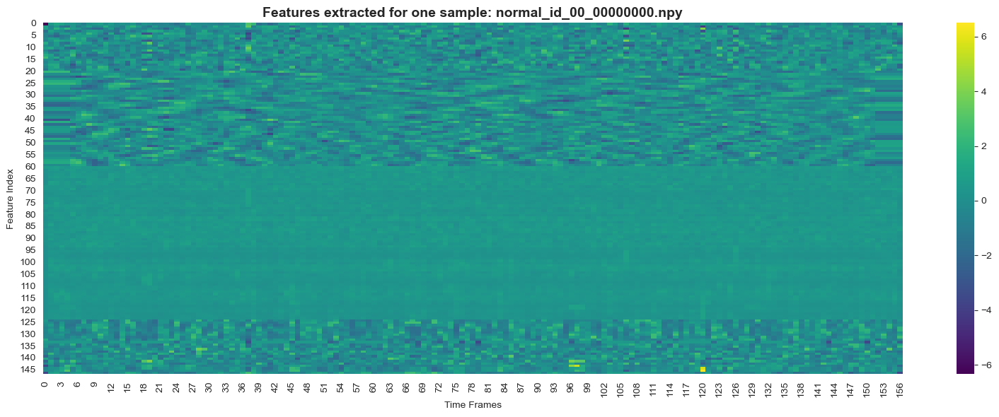

In [23]:
# ✅ Sélection d’un fichier audio .npy de test
sample_path = config.NUMPY_AUDIO_DIR / "pump" / "train" / "normal_id_00_00000000.npy"
if not sample_path.exists():
    sample_path = list(config.NUMPY_AUDIO_DIR.glob("*/train/normal_id_*.npy"))[0]  # fallback

# 🎧 Chargement du signal
y = np.load(sample_path)

# ✅ Extraction des features via ta fonction centrale
features = processing.extract_features(
    audio_data=y,
    sr=config.SR,
    hop_length=config.HOP_LENGTH,
    n_mels=config.N_MELS,
    n_fft=config.N_FFT,
    n_mfcc=config.N_MFCC
)

# 📊 Visualisation brute (heatmap)
plt.figure(figsize=(16, 6))
sns.heatmap(features, cmap='viridis', cbar=True)
plt.title(f"Features extracted for one sample: {sample_path.name}", fontsize=14, fontweight='bold')
plt.xlabel("Time Frames")
plt.ylabel("Feature Index")
plt.tight_layout()
plt.show()


2025-03-22 16:10:57 - INFO - ✅ Features extracted: shape=(147, 157), total dimensions=23079


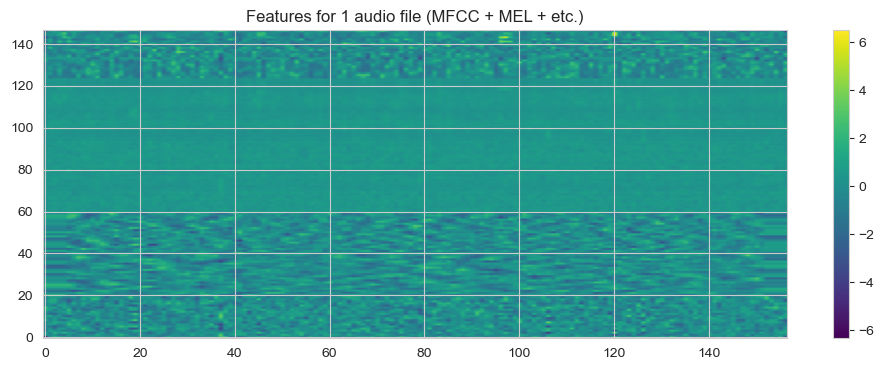

In [24]:
sample_path = Path(config.NUMPY_AUDIO_DIR) / "pump" / "train" / "normal_id_00_00000000.npy"
signal = np.load(sample_path)

features = processing.extract_features(
    audio_data=signal,
    sr=config.SR,
    hop_length=config.HOP_LENGTH,
    n_mels=config.N_MELS,
    n_fft=config.N_FFT,
    n_mfcc=config.N_MFCC
)

plt.figure(figsize=(12, 4))
plt.imshow(features, aspect='auto', origin='lower', cmap='viridis')
plt.title("Features for 1 audio file (MFCC + MEL + etc.)")
plt.colorbar()
plt.show()


In [29]:
# 📂 Chargement des vecteurs de features extraits + étiquettes (normal/anomaly)
X, y = processing.load_audio_features(features_dir=config.FEATURES_DIR)

logger.info(f"✅ Chargé {X.shape[0]} vecteurs de features, avec {X.shape[1]} dimensions chacun.")


2025-03-22 17:33:04 - INFO - Loading normalized features from C:\Users\guidy\Documents\Datascience\Data\sound_datasets\DCASE_DATASET\features...
🔄 Processing machine types: 0it [00:00, ?it/s]
📂 fan - loading split files: 0it [00:00, ?it/s]
📂 fan - loading split files: 1it [00:00,  1.41it/s]
📂 fan - loading split files: 2it [00:01,  1.04it/s]
🔄 Processing machine types: 1it [00:01,  1.85s/it] 
📂 pump - loading split files: 0it [00:00, ?it/s]
📂 pump - loading split files: 1it [00:00,  3.77it/s]
📂 pump - loading split files: 2it [00:01,  1.37it/s]
🔄 Processing machine types: 2it [00:03,  1.54s/it]  
📂 slider - loading split files: 0it [00:00, ?it/s]
📂 slider - loading split files: 1it [00:00,  2.30it/s]
📂 slider - loading split files: 2it [00:01,  1.34it/s]
🔄 Processing machine types: 3it [00:04,  1.48s/it]    
📂 ToyCar - loading split files: 0it [00:00, ?it/s]
📂 ToyCar - loading split files: 1it [00:00,  1.15it/s]
📂 ToyCar - loading split files: 2it [00:02,  1.12s/it]
🔄 Processing machin

In [30]:
print("X shape:", X.shape)
print("y shape:", y.shape)

X shape: (30987, 147, 157)
y shape: (30987,)


## 📊 5. Analyse avancée des distributions des features audio

Dans ce bloc, nous comparons les distributions des features audio extraites pour les sons normaux et anormaux.

**Objectifs :**
- Identifier visuellement les features les plus discriminantes.
- Détecter les outliers et les overlaps entre classes.
- Orienter le choix de features pour les modèles.

Types de graphiques utilisés :
- Boxplots (comparaison par feature entre classes)
- Histogrammes par classe


In [31]:
# ✅ Moyenne temporelle pour obtenir 1 vecteur par fichier
X_mean = X.mean(axis=2)

# 📦 DataFrame avec label
df_features = pd.DataFrame(X_mean)
df_features['label'] = y  # 0 = normal, 1 = anomaly

# 📋 Conversion en labels texte pour affichage
df_features['condition'] = df_features['label'].map({0: "normal", 1: "anomaly"})


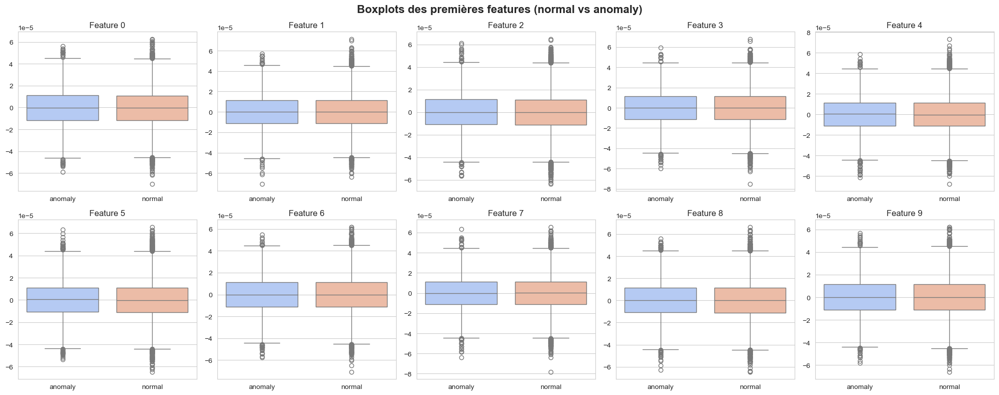

In [32]:
# 🔍 Sélection de quelques features (manuellement ou aléatoirement)
selected_features = df_features.columns[:10]  # Les 10 premières pour commencer

# 📊 Boxplots par feature
plt.figure(figsize=(20, 8))
for i, feat in enumerate(selected_features):
    plt.subplot(2, 5, i + 1)
    sns.boxplot(data=df_features, x='condition', y=feat, palette='coolwarm')
    plt.title(f"Feature {feat}")
    plt.xlabel("")
    plt.ylabel("")

plt.suptitle("Boxplots des premières features (normal vs anomaly)", fontsize=16, fontweight='bold')
plt.tight_layout()
plt.show()


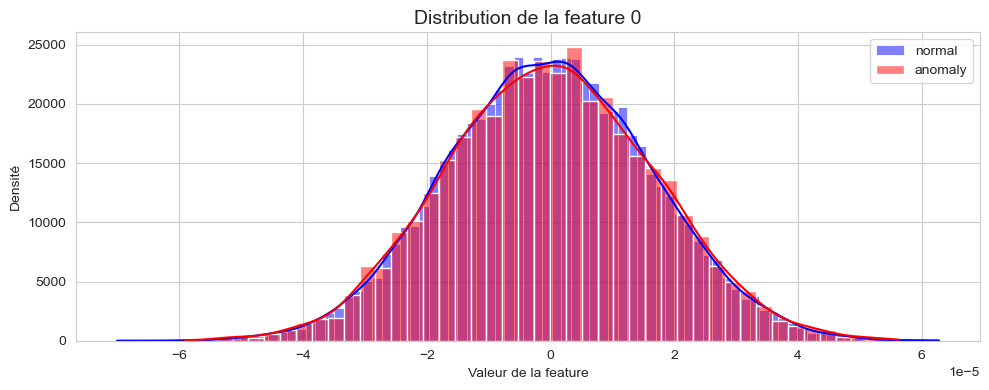

In [33]:
# 🧪 Feature index à tester (ex: 0 pour MFCC_0)
feature_idx = 0

plt.figure(figsize=(10, 4))
sns.histplot(df_features[df_features['label'] == 0][feature_idx], color='blue', label='normal', kde=True, stat='density')
sns.histplot(df_features[df_features['label'] == 1][feature_idx], color='red', label='anomaly', kde=True, stat='density')
plt.title(f"Distribution de la feature {feature_idx}", fontsize=14)
plt.xlabel("Valeur de la feature")
plt.ylabel("Densité")
plt.legend()
plt.tight_layout()
plt.show()


In [34]:
from scipy.stats import mannwhitneyu

stat, p = mannwhitneyu(
    df_features[df_features['label'] == 0][feature_idx],
    df_features[df_features['label'] == 1][feature_idx]
)

logger.info(f"Feature {feature_idx} | Mann-Whitney U test → p-value = {p:.5f}")


2025-03-22 17:33:58 - INFO - Feature 0 | Mann-Whitney U test → p-value = 0.61166


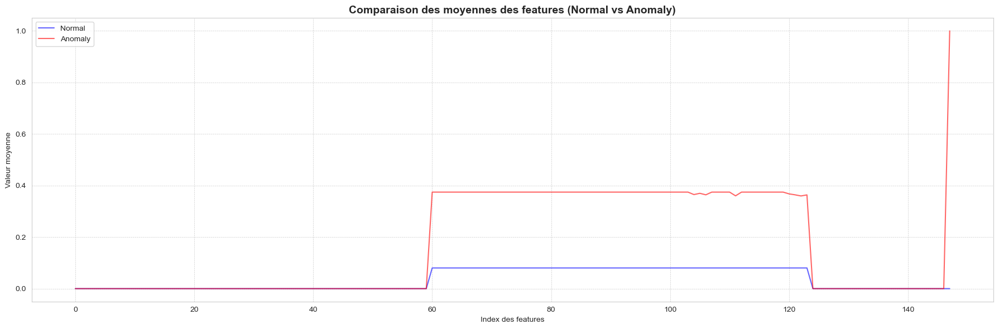

In [42]:
# ✅ Moyenne temporelle
X_mean = X.mean(axis=2)
df_features = pd.DataFrame(X_mean)
df_features["label"] = y
df_features["condition"] = df_features["label"].map({0: "normal", 1: "anomaly"})

# ✅ Garder uniquement les colonnes numériques (exclude 'condition')
numeric_cols = df_features.select_dtypes(include=[np.number]).columns

mean_normal = df_features[df_features["label"] == 0][numeric_cols].mean()
mean_anomaly = df_features[df_features["label"] == 1][numeric_cols].mean()

# 📊 Comparaison visuelle
plt.figure(figsize=(18, 6))
plt.plot(mean_normal.values, label='Normal', color='blue', alpha=0.6)
plt.plot(mean_anomaly.values, label='Anomaly', color='red', alpha=0.6)
plt.title("Comparaison des moyennes des features (Normal vs Anomaly)", fontsize=14, fontweight='bold')
plt.xlabel("Index des features")
plt.ylabel("Valeur moyenne")
plt.legend()
plt.grid(True, linestyle='--', linewidth=0.5)
plt.tight_layout()
plt.show()


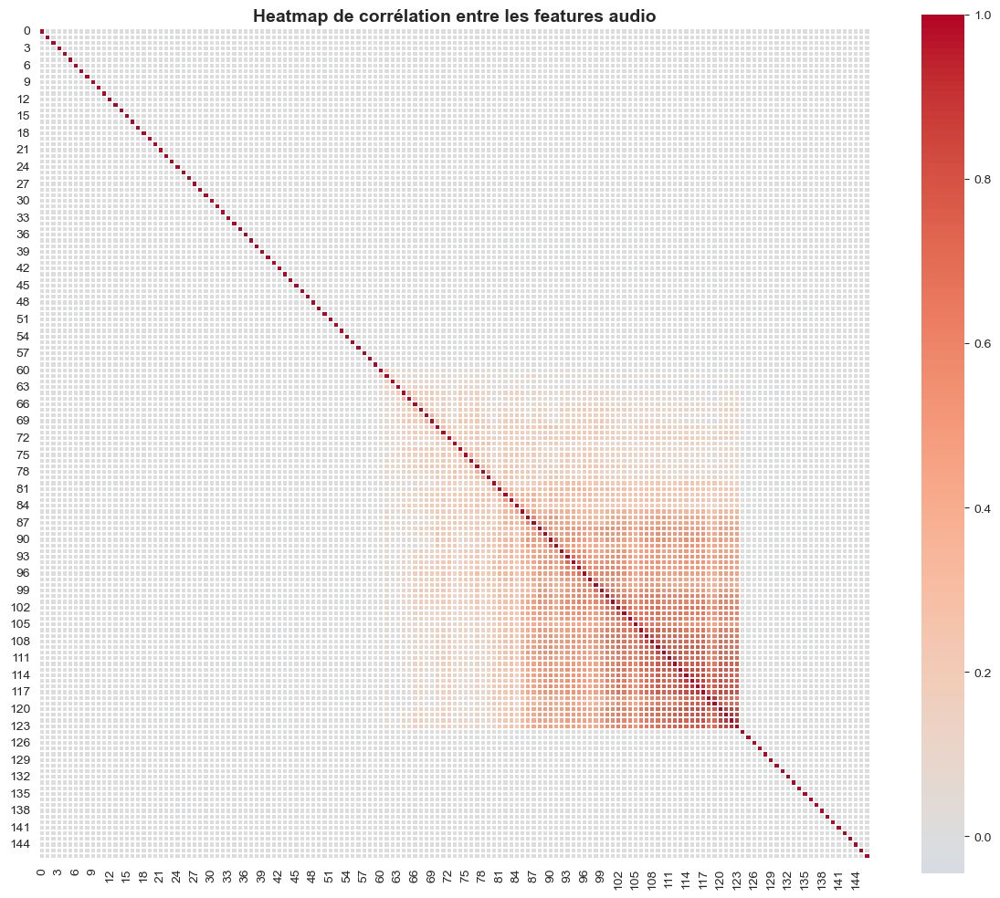

In [45]:
# 🔥 Corrélation uniquement sur les colonnes numériques
numeric_features = df_features.select_dtypes(include=[np.number]).drop('label', axis=1)

corr = numeric_features.corr()

plt.figure(figsize=(12, 10))
sns.heatmap(corr, cmap='coolwarm', center=0, square=True, linewidths=0.1)
plt.title("Heatmap de corrélation entre les features audio", fontsize=14, fontweight='bold')
plt.tight_layout()
plt.show()


## 🧠 6. Réduction de Dimensionnalité : PCA, t-SNE, UMAP

Nous projetons les vecteurs de features dans un espace 2D (ou 3D) pour visualiser les regroupements de données et leur séparation potentielle entre les sons normaux et anormaux.

Techniques utilisées :
- PCA (Analyse en Composantes Principales)
- t-SNE (Stochastic Neighbor Embedding)
- UMAP (Uniform Manifold Approximation and Projection)


In [36]:
from sklearn.preprocessing import StandardScaler

# Réduction temporelle → 1 vecteur par fichier
X_mean = X.mean(axis=2)

# Normalisation des features avant PCA/t-SNE/UMAP
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X_mean)


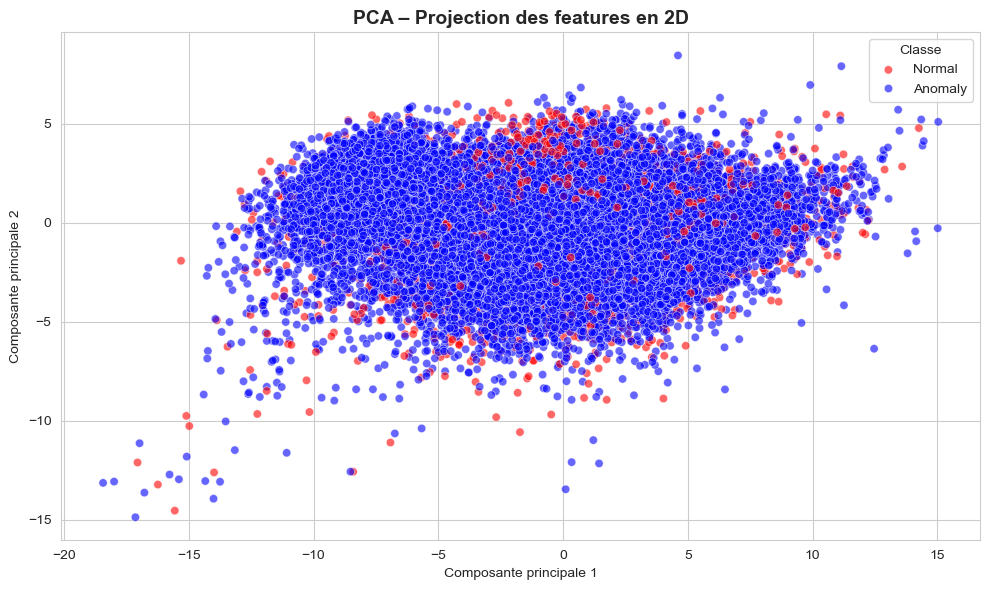

In [37]:
from sklearn.decomposition import PCA

pca = PCA(n_components=2)
X_pca = pca.fit_transform(X_scaled)

# 📊 Visualisation PCA
plt.figure(figsize=(10, 6))
sns.scatterplot(x=X_pca[:, 0], y=X_pca[:, 1], hue=y, palette={0: 'blue', 1: 'red'}, alpha=0.6)
plt.title("PCA – Projection des features en 2D", fontsize=14, fontweight='bold')
plt.xlabel("Composante principale 1")
plt.ylabel("Composante principale 2")
plt.legend(title="Classe", labels=["Normal", "Anomaly"])
plt.tight_layout()
plt.show()


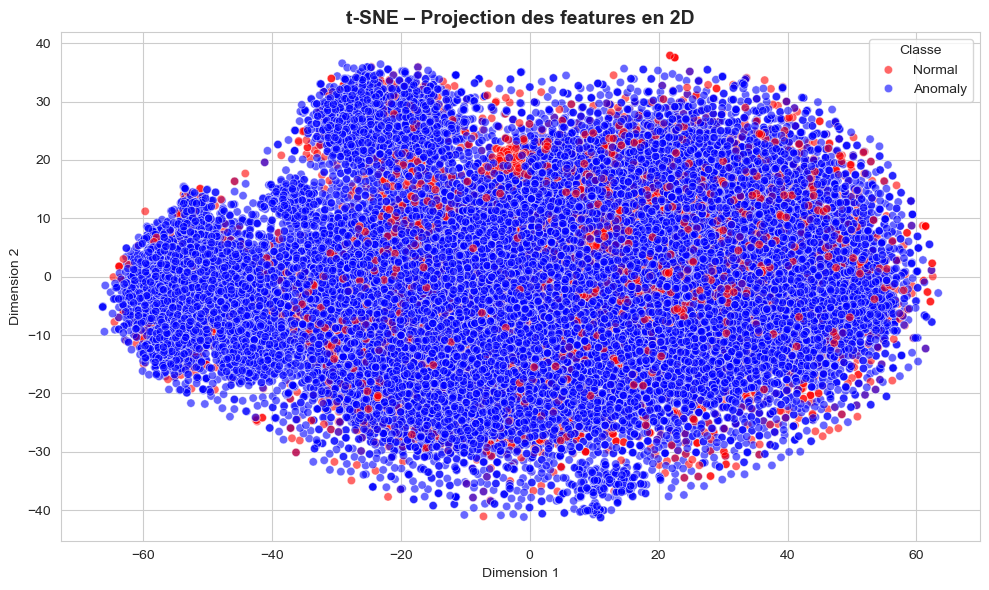

In [38]:
from sklearn.manifold import TSNE

tsne = TSNE(n_components=2, perplexity=30, random_state=42, n_iter=1000)
X_tsne = tsne.fit_transform(X_scaled)

plt.figure(figsize=(10, 6))
sns.scatterplot(x=X_tsne[:, 0], y=X_tsne[:, 1], hue=y, palette={0: 'blue', 1: 'red'}, alpha=0.6)
plt.title("t-SNE – Projection des features en 2D", fontsize=14, fontweight='bold')
plt.xlabel("Dimension 1")
plt.ylabel("Dimension 2")
plt.legend(title="Classe", labels=["Normal", "Anomaly"])
plt.tight_layout()
plt.show()


!pip install umap-learn

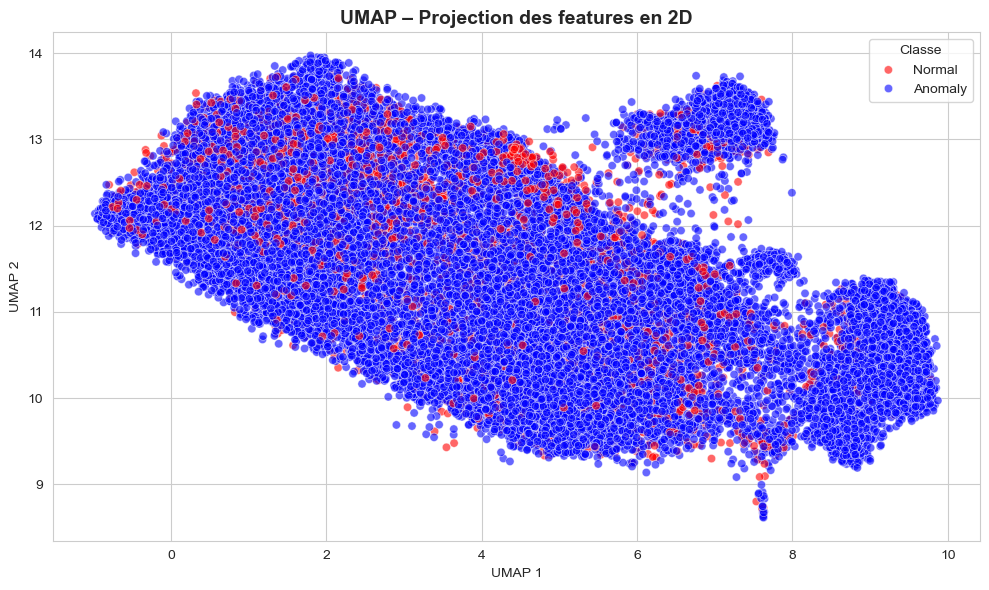

In [41]:
import umap

umap_2d = umap.UMAP(n_components=2, random_state=42)
X_umap = umap_2d.fit_transform(X_scaled)

plt.figure(figsize=(10, 6))
sns.scatterplot(x=X_umap[:, 0], y=X_umap[:, 1], hue=y, palette={0: 'blue', 1: 'red'}, alpha=0.6)
plt.title("UMAP – Projection des features en 2D", fontsize=14, fontweight='bold')
plt.xlabel("UMAP 1")
plt.ylabel("UMAP 2")
plt.legend(title="Classe", labels=["Normal", "Anomaly"])
plt.tight_layout()
plt.show()


### 🌌 Réduction de dimensionnalité : Affichage 3D interactif (Plotly) et évaluation

En complément des visualisations 2D, nous utilisons un affichage interactif 3D avec Plotly pour :
- Explorer visuellement la séparation entre les classes
- Détecter des clusters cachés

Nous ajoutons également :
- L'analyse de variance expliquée (PCA)
- Le calcul du Silhouette Score (séparation entre groupes)


!pip install plotly

In [47]:
from sklearn.decomposition import PCA
import plotly.express as px

# ⚠️ Assure-toi que X_scaled est bien normalisé
pca_3d = PCA(n_components=3)
X_pca_3d = pca_3d.fit_transform(X_scaled)

# ✅ DataFrame pour plotly
df_pca = pd.DataFrame(X_pca_3d, columns=["PC1", "PC2", "PC3"])
df_pca["label"] = y
df_pca["class"] = df_pca["label"].map({0: "normal", 1: "anomaly"})

# 🌌 Visualisation interactive
fig = px.scatter_3d(
    df_pca,
    x="PC1", y="PC2", z="PC3",
    color="class",
    title="PCA – Projection 3D interactive",
    opacity=0.6,
    color_discrete_map={"normal": "blue", "anomaly": "red"}
)
fig.show()


In [48]:
explained = pca_3d.explained_variance_ratio_
logger.info(f"📊 Variance expliquée par les 3 composantes : {explained}")
logger.info(f"📈 Variance totale expliquée (3D PCA) : {explained.sum():.2%}")


2025-03-22 17:55:10 - INFO - 📊 Variance expliquée par les 3 composantes : [0.16232602 0.03224472 0.01552652]
2025-03-22 17:55:10 - INFO - 📈 Variance totale expliquée (3D PCA) : 21.01%


In [49]:
from sklearn.metrics import silhouette_score

# Silhouette Score sur 2D (option : PCA ou t-SNE)
X_pca_2d = PCA(n_components=2).fit_transform(X_scaled)
sil_score = silhouette_score(X_pca_2d, y)

logger.info(f"🧠 Silhouette Score (PCA 2D) : {sil_score:.4f}")


2025-03-22 17:55:30 - INFO - 🧠 Silhouette Score (PCA 2D) : -0.0192


## 🔍 7. Contrôle Qualité des Features Audio

Ce bloc permet de détecter des problèmes potentiels dans les vecteurs de features :
- Valeurs manquantes (NaN, Inf)
- Variance nulle ou très faible
- Corrélations extrêmes entre features

Ces vérifications sont essentielles pour garantir la robustesse du modèle.


In [50]:
# 🔍 Vérifier NaN ou Inf
nan_exists = np.isnan(X_mean).any()
inf_exists = np.isinf(X_mean).any()

logger.info(f"🧪 Présence de NaN : {nan_exists}")
logger.info(f"🧪 Présence de Inf  : {inf_exists}")


2025-03-22 17:56:20 - INFO - 🧪 Présence de NaN : False
2025-03-22 17:56:20 - INFO - 🧪 Présence de Inf  : False


In [51]:
from sklearn.feature_selection import VarianceThreshold

# ✅ Variance de chaque feature
selector = VarianceThreshold(threshold=0.0)
selector.fit(X_mean)

zero_variance_mask = ~selector.get_support()
zero_variance_indices = np.where(zero_variance_mask)[0]

logger.info(f"🧩 Nombre de features à variance nulle : {len(zero_variance_indices)}")
if len(zero_variance_indices) > 0:
    logger.info(f"Indices des features à variance nulle : {zero_variance_indices.tolist()}")


2025-03-22 17:56:28 - INFO - 🧩 Nombre de features à variance nulle : 0


In [52]:
# ✅ Matrice de corrélation
df_corr = pd.DataFrame(X_mean).corr().abs()

# On ignore la diagonale
upper = df_corr.where(np.triu(np.ones(df_corr.shape), k=1).astype(bool))

# Features corrélées > 0.95
high_corr = [(i, j, upper.loc[i, j])
             for i in upper.columns
             for j in upper.columns
             if i != j and upper.loc[i, j] > 0.95]

logger.info(f"🔗 Nombre de paires fortement corrélées (> 0.95) : {len(high_corr)}")
if high_corr:
    for i, j, corr in high_corr[:10]:  # Affiche 10 premières
        logger.info(f" - Feature {i} vs Feature {j} → corr={corr:.2f}")


2025-03-22 17:56:38 - INFO - 🔗 Nombre de paires fortement corrélées (> 0.95) : 0


In [53]:
# 📊 Résumé statistique global
df_stats = pd.DataFrame(X_mean).describe().T
df_stats["missing_ratio"] = pd.DataFrame(X_mean).isna().mean()
display(df_stats.head(10))


,count,mean,std,min,25%,50%,75%,max,missing_ratio
0,30987.0,-2.384186e-07,0.0,-0.000070,-0.000012,-2.980232e-07,0.000011,0.000063,0.0
1,30987.0,1.192093e-07,0.0,-0.000071,-0.000011,0.000000e+00,0.000011,0.000071,0.0
2,30987.0,-5.960464e-08,0.0,-0.000064,-0.000011,-1.192093e-07,0.000011,0.000065,0.0
3,30987.0,1.192093e-07,0.0,-0.000075,-0.000011,1.192093e-07,0.000011,0.000068,0.0
4,30987.0,-0.000000e+00,0.0,-0.000068,-0.000011,0.000000e+00,0.000011,0.000073,0.0
5,30987.0,-0.000000e+00,0.0,-0.000065,-0.000011,-5.960464e-08,0.000011,0.000066,0.0
6,30987.0,-5.960464e-08,0.0,-0.000071,-0.000011,-1.788139e-07,0.000011,0.000062,0.0
7,30987.0,5.960464e-08,0.0,-0.000078,-0.000011,1.192093e-07,0.000011,0.000066,0.0
8,30987.0,2.384186e-07,0.0,-0.000065,-0.000011,2.384186e-07,0.000011,0.000066,0.0
9,30987.0,1.192093e-07,0.0,-0.000066,-0.000011,0.000000e+00,0.000011,0.000062,0.0
